# VinDr-CXR: Chest X-ray Disease Classification
A multi-model approach using engineered features and deep learning

## Project Overview
This notebook implements a chest X-ray classification system using the VinDr-CXR dataset. The system:
- Processes DICOM medical images
- Engineers visual features (HOG, Fourier, edge detection, etc.)
- Implements three models: Logistic Regression, CNN, and a Hybrid approach
- Evaluates performance, efficiency, and generalizability

# 1. Imports and Configuration

In [ ]:
!pip install pydicom
!pip install -q keras-tuner
!pip install torchxrayvision torch torchvision


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.4/2.4 MB 67.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 129.1/129.1 kB 6.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 29.0/29.0 MB 54.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 99.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 86.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 50.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 4.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 42.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 17.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 4.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2

In [ ]:
# Standard libraries
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from glob import glob
from tqdm import tqdm
import time

# Image processing
import cv2
import pydicom
from skimage import feature, exposure
from scipy.fftpack import fft2, fftshift
from scipy.spatial import ConvexHull

# Machine learning
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, confusion_matrix, roc_auc_score, f1_score
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.metrics import roc_curve
from sklearn.utils.class_weight import compute_class_weight


# Deep learning
import tensorflow as tf
from tensorflow.keras import layers, models, applications, optimizers
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras import backend as K
from tensorflow.keras.models import Model
import keras_tuner as kt

# Set random seeds for reproducibility
np.random.seed(42)
tf.random.set_seed(42)

# Configuration dictionaries
CONFIG = {
    'data_path': '/content/drive/MyDrive/MIDS281/vinbigdata-chest-xray-abnormalities-detection/',
    'img_size': (512, 512),  # Size for feature extraction
    'feature_extraction': {
        'hog': True,
        'fourier': True,
        'pyramid_levels': 3,
        'edge_detection': True,
        'lbp': True,
        'spatial_features': True,
        'cnn_features': True  # Enable CNN feature extraction
    }
}

# CNN configuration
CNN_CONFIG = {
    'img_size': (224, 224),  # Standard size for pre-trained models
    'batch_size': 16,
    'epochs': 20,
    'learning_rate': 1e-4,
    'model_type': 'DenseNet121',  # Options: 'ResNet50', 'DenseNet121', 'EfficientNetB0'
    'use_pretrained': True,
    'fine_tune_layers': 30  # Number of top layers to fine-tune
}

# Map class IDs to names
CLASS_NAMES = {
    0: 'Aortic enlargement',
    1: 'Atelectasis',
    2: 'Calcification',
    3: 'Cardiomegaly',
    4: 'Consolidation',
    5: 'ILD',
    6: 'Infiltration',
    7: 'Lung Opacity',
    8: 'Nodule/Mass',
    9: 'Other lesion',
    10: 'Pleural effusion',
    11: 'Pleural thickening',
    12: 'Pneumothorax',
    13: 'Pulmonary fibrosis',
    14: 'No finding'
}

# Caching for image file paths
IMAGE_FILE_MAPPING = {}

SAMPLES_PER_CLASS = 1000

# 2. Function and Class Definitions
The following sections contain all function and class implementations used in this project. The actual execution happens in the Runtime section below.

## 2.1 Data Management Functions
Functions for loading DICOM files, preprocessing images, and managing dataset splits.

In [ ]:
def load_dataset_annotations():
    """Load annotation CSV with class distribution analysis."""
    train_csv_path = os.path.join(CONFIG['data_path'], 'train.csv')
    df = pd.read_csv(train_csv_path)

    # Get unique image IDs with annotations
    unique_image_ids = df['image_id'].unique()

    print(f"Total annotations: {len(df)}")
    print(f"Total unique images: {len(unique_image_ids)}")

    # Show class distribution
    class_distribution = df['class_id'].value_counts().sort_index()
    for class_id, count in class_distribution.items():
        print(f"Class {class_id} ({CLASS_NAMES[class_id]}): {count} annotations")

    return df, unique_image_ids

# This should be added to the existing find_all_image_files function in section 2.1
def find_all_image_files(base_path=None):
    """Find and cache all DICOM files in the dataset directory."""
    global IMAGE_FILE_MAPPING

    if base_path is None:
        base_path = CONFIG['data_path']

    # Return cached results if available
    if IMAGE_FILE_MAPPING:
        print("Using cached file mapping...")
        return IMAGE_FILE_MAPPING

    print(f"Searching for image files in {base_path}...")
    image_files = {}

    # Define search paths and extensions
    search_dirs = [
        os.path.join(base_path, 'train_images'),
        os.path.join(base_path, 'train'),
        os.path.join(base_path, 'images'),
        base_path
    ]
    extensions = ['.dicom', '.dcm', '']  # '' for files without extension

    # Search all potential directories
    for directory in search_dirs:
        if not os.path.exists(directory):
            continue

        print(f"Searching in {directory}...")

        # Search for files with each extension
        for ext in extensions:
            for file_path in glob(os.path.join(directory, f'*{ext}')):
                if os.path.isfile(file_path):
                    image_id = os.path.splitext(os.path.basename(file_path))[0]
                    image_files[image_id] = file_path

        # Check subdirectories if present
        for subdir in [d for d in os.listdir(directory) if os.path.isdir(os.path.join(directory, d))]:
            subdir_path = os.path.join(directory, subdir)
            for ext in extensions:
                for file_path in glob(os.path.join(subdir_path, f'*{ext}')):
                    if os.path.isfile(file_path):
                        image_id = os.path.splitext(os.path.basename(file_path))[0]
                        image_files[image_id] = file_path

    print(f"Found {len(image_files)} unique image files")

    # Show some examples of the mapping
    if image_files:
        print("\nExample image_id to file mappings:")
        count = 0
        for image_id, file_path in image_files.items():
            print(f"  {image_id} -> {file_path}")
            count += 1
            if count >= 5:
                break

    # Cache results
    IMAGE_FILE_MAPPING = image_files
    return image_files

def build_multilabel_map(annotations_df, image_files):
    """
    Build a mapping from image_id to list of class_ids, handling 'No finding' cases.

    Args:
        annotations_df: DataFrame with annotations
        image_files: Dictionary mapping image_id to file_path

    Returns:
        Dictionary mapping image_id to list of class_ids
    """
    available_image_ids = set(image_files.keys())
    annotated_image_ids = set(annotations_df['image_id'].unique())
    no_finding_image_ids = available_image_ids - annotated_image_ids

    # Build multilabel map from annotations
    multilabel_map = annotations_df.groupby("image_id")["class_id"].apply(list).to_dict()

    # Add 'No finding' class (14) for images without annotations
    for img_id in no_finding_image_ids:
        multilabel_map[img_id] = [14]  # Class 14 is 'No finding'

    print(f"Total labeled images: {len(multilabel_map)}")
    print(f"Of which 'No finding' images: {len(no_finding_image_ids)}")

    return multilabel_map

def enforce_no_finding_exclusivity(y, selected_classes):
    """
    Enforce mutual exclusivity between 'No finding' and other classes.

    Args:
        y: Label matrix with shape (n_samples, n_classes)
        selected_classes: List of class IDs in their indexed order

    Returns:
        Modified label matrix with mutual exclusivity enforced
    """
    y_copy = y.copy()  # Create a copy to avoid unintended side effects

    if 14 in selected_classes:
        no_finding_index = selected_classes.index(14)
        mask = y_copy[:, no_finding_index] == 1
        y_copy[mask] = 0  # Zero out all classes where 'No finding' is present
        y_copy[mask, no_finding_index] = 1  # Set 'No finding' back to 1

    return y_copy

def read_dicom(file_path, resize_to=None):
    """Read a DICOM file and convert to normalized image."""
    try:
        dicom = pydicom.dcmread(file_path)
        img = dicom.pixel_array

        # Normalize to 0-255 range
        img = ((img - img.min()) / (img.max() - img.min()) * 255).astype(np.uint8)

        # Resize if requested
        if resize_to is not None:
            img = cv2.resize(img, resize_to)

        return img
    except Exception as e:
        print(f"Error reading {file_path}: {e}")
        return None

def preprocess_image(img, target_size=(512, 512)):
    """Apply preprocessing for feature extraction."""
    if img is None:
        return None

    # Resize and enhance contrast
    img_resized = cv2.resize(img, target_size)
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    img_enhanced = clahe.apply(img_resized)

    # Normalize to 0-1 range
    return img_enhanced / 255.0

# def prepare_image_for_cnn(img):
#     """Prepare grayscale image for the X-ray model."""
#     if img is None:
#         return None

#     # Resize to target size while keeping grayscale format
#     img_resized = cv2.resize(img, CNN_CONFIG['img_size'])

#     # Normalize to 0-1 range
#     if img_resized.max() > 1.0:
#         img_resized = img_resized / 255.0

#     # Convert grayscale to 3-channel format expected by CNN models
#     img_rgb = np.stack([img_resized] * 3, axis=-1)

#     return img_rgb  # Return as 3-channel image (H, W, 3)

def prepare_image_for_cnn(img, feature_dict=None):
    """Prepare grayscale image for the X-ray model with engineered features in channels."""
    if img is None:
        return None

    # Resize to target size while keeping grayscale format
    img_resized = cv2.resize(img, CNN_CONFIG['img_size'])

    # Normalize to 0-1 range
    if img_resized.max() > 1.0:
        img_resized = img_resized / 255.0

    # If we don't have pre-computed features, just use the standard 3-channel approach
    if feature_dict is None:
        return np.stack([img_resized] * 3, axis=-1)

    # Channel 1: Original image
    channel1 = img_resized

    # Channel 2: Edge magnitude from pre-computed features
    if 'edge' in feature_dict and 'magnitude' in feature_dict['edge']:
        # Resize to match CNN input size
        edge_magnitude = cv2.resize(feature_dict['edge']['magnitude'],
                                   CNN_CONFIG['img_size'])
        # Normalize if needed
        if edge_magnitude.max() > 1.0:
            channel2 = edge_magnitude / 255.0
        else:
            channel2 = edge_magnitude
    else:
        print("Warning: CNN channel 2 fallback to greyscale.")
        channel2 = img_resized  # Fallback to original

    # Channel 3: HOG visualization from pre-computed features
    if 'hog' in feature_dict and 'visualization' in feature_dict['hog']:
        # Resize to match CNN input size
        hog_viz = cv2.resize(feature_dict['hog']['visualization'],
                            CNN_CONFIG['img_size'])
        # Normalize if needed
        if hog_viz.max() > 1.0:
            channel3 = hog_viz / 255.0
        else:
            channel3 = hog_viz
    else:
        print("Warning: CNN channel 3 fallback to greyscale.")
        channel3 = img_resized  # Fallback to original

    # Stack channels
    img_multi = np.stack([channel1, channel2, channel3], axis=-1)

    return img_multi

# def prepare_data(X, y, selected_classes, test_size=0.2, val_size=0.25):
#     """
#     Split the dataset into train/val/test sets and standardize features.
#     """
#     # First split into train+val and test
#     X_trainval, X_test, y_trainval, y_test = train_test_split(
#         X, y, test_size=test_size, random_state=42, stratify=y[:, 0] if y.shape[1] > 0 else None
#     )

#     # Then split train+val into train and val
#     X_train, X_val, y_train, y_val = train_test_split(
#         X_trainval, y_trainval, test_size=val_size, random_state=42,
#         stratify=y_trainval[:, 0] if y_trainval.shape[1] > 0 else None
#     )

#     # Standardize features
#     scaler = StandardScaler()
#     X_train_scaled = scaler.fit_transform(X_train)
#     X_val_scaled = scaler.transform(X_val)
#     X_test_scaled = scaler.transform(X_test)

#     print(f"Dataset split: Train {X_train.shape[0]}, Val {X_val.shape[0]}, Test {X_test.shape[0]} samples")

#     # Enforce mutual exclusivity of 'No finding' (class 14) — all others must be 0
#     def enforce_no_finding_exclusivity(y):
#         if 14 in selected_classes:
#             no_finding_index = selected_classes.index(14)
#             mask = y[:, no_finding_index] == 1
#             y[mask] = 0
#             y[mask, no_finding_index] = 1
#         return y

#     y_train = enforce_no_finding_exclusivity(y_train)
#     y_val = enforce_no_finding_exclusivity(y_val)
#     y_test = enforce_no_finding_exclusivity(y_test)

#     return X_train_scaled, X_val_scaled, X_test_scaled, y_train, y_val, y_test, scaler



In [ ]:
def prepare_data(X, y, selected_classes, all_feature_components=None, test_size=0.2, val_size=0.25):
    """
    Split the dataset into train/val/test sets and standardize features.

    Args:
        X: Feature matrix
        y: Label matrix
        selected_classes: List of selected class IDs
        all_feature_components: Optional dictionary of feature components to split
        test_size: Fraction of data to use for test set
        val_size: Fraction of train+val to use for validation

    Returns:
        Processed features, labels, scaler, and optionally split feature components
    """
    # Track indices for consistent splitting
    indices = np.arange(len(X))

    # First split into train+val and test
    X_trainval, X_test, y_trainval, y_test, indices_trainval, indices_test = train_test_split(
        X, y, indices, test_size=test_size, random_state=42,
        stratify=y[:, 0] if y.shape[1] > 0 else None
    )

    # Then split train+val into train and val
    X_train, X_val, y_train, y_val, indices_train, indices_val = train_test_split(
        X_trainval, y_trainval, indices_trainval, test_size=val_size, random_state=42,
        stratify=y_trainval[:, 0] if y_trainval.shape[1] > 0 else None
    )

    # Save raw data splits before scaling
    X_train_raw, X_val_raw, X_test_raw = X_train.copy(), X_val.copy(), X_test.copy()

    # Standardize features
    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_val_scaled = scaler.transform(X_val)
    X_test_scaled = scaler.transform(X_test)

    print(f"Dataset split: Train {X_train.shape[0]}, Val {X_val.shape[0]}, Test {X_test.shape[0]} samples")

    # Enforce mutual exclusivity of 'No finding' (class 14) — all others must be 0
    y_train = enforce_no_finding_exclusivity(y_train, selected_classes)
    y_val = enforce_no_finding_exclusivity(y_val, selected_classes)
    y_test = enforce_no_finding_exclusivity(y_test, selected_classes)

    # If feature components are provided, split them using the same indices
    if all_feature_components is not None:
        train_components = {}
        val_components = {}
        test_components = {}

        for feature_type in all_feature_components:
            if len(all_feature_components[feature_type]) > 0:
                try:
                    # Make sure we have enough components
                    if len(all_feature_components[feature_type]) < len(indices):
                        print(f"Warning: Not enough {feature_type} components ({len(all_feature_components[feature_type])} vs {len(indices)} needed)")
                        # Pad with empty features if needed
                        padding_needed = len(indices) - len(all_feature_components[feature_type])
                        padding = [np.zeros(1)] * padding_needed
                        all_feature_components[feature_type].extend(padding)

                    train_components[feature_type] = [all_feature_components[feature_type][i] for i in indices_train]
                    val_components[feature_type] = [all_feature_components[feature_type][i] for i in indices_val]
                    test_components[feature_type] = [all_feature_components[feature_type][i] for i in indices_test]

                    print(f"Split {feature_type} components: {len(train_components[feature_type])} train, "
                          f"{len(val_components[feature_type])} val, {len(test_components[feature_type])} test")
                except Exception as e:
                    print(f"Error splitting {feature_type} components: {e}")
                    # Create empty components for this type
                    train_components[feature_type] = [np.zeros(1)] * len(indices_train)
                    val_components[feature_type] = [np.zeros(1)] * len(indices_val)
                    test_components[feature_type] = [np.zeros(1)] * len(indices_test)
            else:
                print(f"No {feature_type} components to split")
                train_components[feature_type] = [np.zeros(1)] * len(indices_train)
                val_components[feature_type] = [np.zeros(1)] * len(indices_val)
                test_components[feature_type] = [np.zeros(1)] * len(indices_test)

        # Verification step for debugging
        print("\nVerifying component splitting:")
        total_samples = len(indices_train) + len(indices_val) + len(indices_test)
        print(f"Original samples: {len(indices)}")
        print(f"Split samples (train+val+test): {total_samples}")

        for feature_type in all_feature_components:
            if len(all_feature_components[feature_type]) > 0:
                split_total = len(train_components[feature_type]) + len(val_components[feature_type]) + len(test_components[feature_type])
                print(f"  {feature_type}: Original {len(all_feature_components[feature_type])}, Split total {split_total}")

        # Return with feature components and raw data
        return (X_train_scaled, X_val_scaled, X_test_scaled,
                y_train, y_val, y_test,
                scaler,
                train_components, val_components, test_components,
                X_train_raw, X_val_raw, X_test_raw)

    # Otherwise, return just the features, labels, and raw data
    return (X_train_scaled, X_val_scaled, X_test_scaled,
            y_train, y_val, y_test,
            scaler,
            X_train_raw, X_val_raw, X_test_raw)

In [ ]:
def select_balanced_image_subset(annotations_df, num_classes=5, samples_per_class=100, include_no_finding=True):
    """
    Select a balanced subset of images across different classes.

    Args:
        annotations_df: DataFrame with annotations
        num_classes: Number of disease classes to include
        samples_per_class: Target number of samples per class
        include_no_finding: Whether to include 'No finding' class (14)

    Returns:
        selected_image_ids: List of selected image IDs
        selected_classes: List of selected class IDs
    """
    # Find all available images
    image_files = find_all_image_files()
    available_image_ids = set(image_files.keys())

    # Count occurrences of each class
    class_counts = annotations_df['class_id'].value_counts()

    # Determine which classes have enough samples
    valid_classes = []
    for class_id, count in class_counts.items():
        if class_id != 14 and count >= samples_per_class:  # Exclude 'No finding' initially
            valid_classes.append(class_id)

    # Select top N classes by frequency
    selected_classes = valid_classes[:num_classes]

    # Add 'No finding' if requested
    if include_no_finding and 14 not in selected_classes:
        selected_classes.append(14)

    print(f"Selected {len(selected_classes)} classes: {selected_classes}")

    # Build multilabel map
    multilabel_map = build_multilabel_map(annotations_df, image_files)

    # Initialize tracking of class counts
    current_counts = {class_id: 0 for class_id in selected_classes}
    selected_image_ids = []

    # Create a list of all available images and their classes
    available_images = []
    for img_id, class_ids in multilabel_map.items():
        # Only consider classes we're interested in
        relevant_classes = [c for c in class_ids if c in selected_classes]
        if relevant_classes:
            available_images.append((img_id, relevant_classes))

    # Shuffle to ensure randomness when scores are equal
    np.random.shuffle(available_images)

    # Continue selecting images until all classes reach their targets
    while available_images and any(count < samples_per_class for class_id, count in current_counts.items()):
        # Find which classes still need more samples
        needed_classes = [c for c in selected_classes if current_counts[c] < samples_per_class]

        # Score each image by how many needed classes it contributes to
        best_score = 0
        best_idx = -1

        for idx, (img_id, img_classes) in enumerate(available_images):
            # Count how many needed classes this image contributes to
            score = sum(1 for c in img_classes if c in needed_classes)
            if score > best_score:
                best_score = score
                best_idx = idx

        # If no image contributes to needed classes, break
        if best_score == 0:
            break

        # Add the best image
        best_img_id, best_classes = available_images.pop(best_idx)
        selected_image_ids.append(best_img_id)

        # Update class counts
        for class_id in best_classes:
            if class_id in selected_classes:
                current_counts[class_id] += 1

    # Report final class distribution
    print("Class distribution in selected image set:")
    for class_id in selected_classes:
        print(f"  Class {class_id} ({CLASS_NAMES[class_id]}): {current_counts[class_id]} samples")

    print(f"Total unique images selected: {len(selected_image_ids)}")

    return selected_image_ids, selected_classes

## 2.2 Feature Engineering
Implementation of the FeatureExtractor class and related visualization functions.

In [ ]:
class FeatureExtractor:
    """
    Feature extractor for chest X-ray images with multiple feature types.

    Implements:
    - HOG (Histogram of Oriented Gradients)
    - Fourier domain analysis
    - Edge detection
    - Image pyramid features
    - LBP (Local Binary Pattern)
    - Spatial relationship features
    """

    def __init__(self, config=None, annotations_df=None, all_spatial_keys=None):
        """Initialize the feature extractor with configuration."""
        self.config = {
            'hog': True,
            'fourier': True,
            'edge_detection': True,
            'pyramid_levels': 3,
            'lbp': True,
            'spatial_features': True,
            'cnn_features': False  # Default to False for backward compatibility
        }

        if config:
            self.config.update(config)

        self.annotations_df = annotations_df
        self.all_spatial_keys = all_spatial_keys or []

        # Initialize CNN feature extraction if enabled
        if self.config.get('cnn_features', False):
            print("Initializing CNN model for feature extraction...")
            self.cnn_model = applications.DenseNet121(
                weights='imagenet',
                include_top=False,
                input_shape=(*CNN_CONFIG['img_size'], 3),
                pooling='avg'
            )
            # We'll create the feature extractor on first use
        else:
            self.cnn_model = None

    def __call__(self, img, image_id=None, return_all=False):
        """
        Extract all enabled features from the image.

        Args:
            img: Input image (normalized 0-1)
            image_id: Image ID for spatial features
            return_all: Return feature dictionary with visualizations

        Returns:
            features: Concatenated feature vector
            feature_dict: Dictionary with all feature data (if return_all=True)
        """
        if img is None:
            return (None, None) if return_all else None

        feature_dict = {}
        all_features = []

        # Extract HOG features
        if self.config['hog']:
            if return_all:
                hog_features, hog_img = self.extract_hog_features(img, visualize=True)
                feature_dict['hog'] = {
                    'features': hog_features,
                    'visualization': hog_img
                }
            else:
                hog_features = self.extract_hog_features(img, visualize=False)
            all_features.append(hog_features)

        # Extract Fourier features
        if self.config['fourier']:
            if return_all:
                fourier_features, magnitude_spectrum = self.extract_fourier_features(img, visualize=True)
                feature_dict['fourier'] = {
                    'features': fourier_features,
                    'visualization': magnitude_spectrum
                }
            else:
                fourier_features = self.extract_fourier_features(img, visualize=False)
            all_features.append(fourier_features)

        # Extract edge features
        if self.config['edge_detection']:
            if return_all:
                edge_features, edges, magnitude = self.extract_edge_features(img, visualize=True)
                feature_dict['edge'] = {
                    'features': edge_features,
                    'edges': edges,
                    'magnitude': magnitude
                }
            else:
                edge_features = self.extract_edge_features(img, visualize=False)
            all_features.append(edge_features)

        # Extract pyramid features
        if self.config['pyramid_levels'] > 0:
            if return_all:
                pyramid_features, pyramid = self.extract_pyramid_features(
                    img, levels=self.config['pyramid_levels'], visualize=True
                )
                feature_dict['pyramid'] = {
                    'features': pyramid_features,
                    'pyramid': pyramid
                }
            else:
                pyramid_features = self.extract_pyramid_features(
                    img, levels=self.config['pyramid_levels'], visualize=False
                )
            all_features.append(pyramid_features)

        # Extract LBP features
        if self.config.get('lbp', False):
            if return_all:
                lbp_features, lbp_img = self.extract_lbp_features(img, visualize=True)
                feature_dict['lbp'] = {
                    'features': lbp_features,
                    'visualization': lbp_img
                }
            else:
                lbp_features = self.extract_lbp_features(img, visualize=False)
            all_features.append(lbp_features)

        # Extract spatial relationship features
        if self.config.get('spatial_features', False) and image_id is not None and self.annotations_df is not None:
            spatial_features = self.extract_spatial_features(image_id)

            # Create consistent-length feature array
            if spatial_features and len(spatial_features) > 0:
                spatial_feature_array = np.array([
                    spatial_features.get(k, 0.0) for k in self.all_spatial_keys
                ])
            else:
                spatial_feature_array = np.zeros(len(self.all_spatial_keys))

            spatial_feature_array = np.nan_to_num(spatial_feature_array)
            all_features.append(spatial_feature_array.flatten())

            if return_all:
                feature_dict['spatial'] = {
                    'features': spatial_feature_array.flatten(),
                    'feature_names': self.all_spatial_keys
                }

        # Extract CNN features if enabled
        if self.config.get('cnn_features', False) and hasattr(self, 'cnn_model') and self.cnn_model is not None:
            # print("Attempting to extract CNN features...")
            cnn_features = self.extract_cnn_features(img)

            if cnn_features is not None and len(cnn_features) > 0:
                # print(f"Successfully extracted {len(cnn_features)} CNN features, adding to feature vector")
                all_features.append(cnn_features)

                if return_all:
                    feature_dict['cnn'] = {
                        'features': cnn_features
                    }
            else:
                print("WARNING: CNN features extraction failed or returned empty array")


        # Concatenate all features
        if all_features:
            features = np.concatenate(all_features)
        else:
            features = np.array([])
            print("Warning: No features were extracted!")

        return (features, feature_dict) if return_all else features

    def extract_hog_features(self, img, visualize=False):
        """Extract HOG features optimized for medical images."""
        hog_features = feature.hog(
            img,
            orientations=12,             # More orientations for finer angular resolution
            pixels_per_cell=(16, 16),    # Larger cells for more visible structures
            cells_per_block=(2, 2),
            block_norm='L2-Hys',
            visualize=visualize,
            feature_vector=True
        )

        if visualize:
            features, hog_img = hog_features
            hog_img = exposure.rescale_intensity(hog_img, in_range=(0, 10))
            return features, hog_img
        else:
            return hog_features

    def extract_fourier_features(self, img, visualize=False):
        """Extract features from the Fourier domain with radial binning."""
        # Compute 2D FFT
        f_transform = fft2(img)
        f_shift = fftshift(f_transform)
        magnitude = np.abs(f_shift)
        magnitude_log = np.log1p(magnitude)  # Log transform for better visualization

        # Get image center
        center_y, center_x = magnitude.shape[0] // 2, magnitude.shape[1] // 2

        # Create coordinate grid
        y, x = np.ogrid[:magnitude.shape[0], :magnitude.shape[1]]
        y = y - center_y
        x = x - center_x

        # Compute radial distance
        radius = np.sqrt(x*x + y*y)

        # Create radial bins
        num_bins = 20
        max_radius = min(center_y, center_x)
        bins = np.linspace(0, max_radius, num_bins + 1)

        # Compute statistics for each bin
        radial_features = []
        for i in range(num_bins):
            bin_mask = (radius >= bins[i]) & (radius < bins[i+1])
            bin_values = magnitude_log[bin_mask]

            if len(bin_values) > 0:
                mean_val = np.mean(bin_values)
                std_val = np.std(bin_values)
                max_val = np.max(bin_values)
                radial_features.extend([mean_val, std_val, max_val])
            else:
                radial_features.extend([0, 0, 0])

        # Add directional information
        angles = np.arctan2(y, x)
        angle_bins = 8
        angle_features = []

        for i in range(angle_bins):
            angle_min = i * 2 * np.pi / angle_bins - np.pi
            angle_max = (i + 1) * 2 * np.pi / angle_bins - np.pi
            angle_mask = (angles >= angle_min) & (angles < angle_max)
            angle_values = magnitude_log[angle_mask]

            angle_features.append(np.mean(angle_values) if len(angle_values) > 0 else 0)

        # Combine features
        fourier_features = np.array(radial_features + angle_features)

        if visualize:
            magnitude_norm = cv2.normalize(magnitude_log, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)
            return fourier_features, magnitude_norm
        else:
            return fourier_features

    def extract_edge_features(self, img, visualize=False):
        """Extract edge features with region-based analysis."""
        # Convert to 8-bit if needed
        img_8bit = (img * 255).astype(np.uint8) if img.dtype != np.uint8 else img.copy()

        # Compute Sobel gradients
        sobelx = cv2.Sobel(img_8bit, cv2.CV_64F, 1, 0, ksize=5)
        sobely = cv2.Sobel(img_8bit, cv2.CV_64F, 0, 1, ksize=5)

        # Calculate gradient magnitude and direction
        magnitude = np.sqrt(sobelx**2 + sobely**2)
        direction = np.arctan2(sobely, sobelx) * 180 / np.pi

        # Canny edge detection
        edges = cv2.Canny(img_8bit, 30, 150)

        # Divide image into regions
        h, w = img.shape
        regions = [
            (0, 0, w//2, h//2),          # Top-Left
            (w//2, 0, w, h//2),          # Top-Right
            (0, h//2, w//2, h),          # Bottom-Left
            (w//2, h//2, w, h),          # Bottom-Right
            (w//4, h//4, 3*w//4, 3*h//4) # Center
        ]

        # Analyze edge density in each region
        region_features = []
        for x0, y0, x1, y1 in regions:
            region_mask = edges[y0:y1, x0:x1]
            region_area = (x1 - x0) * (y1 - y0)
            edge_density = np.sum(region_mask > 0) / region_area
            region_features.append(edge_density)

        # Compute histogram of gradient directions (36 bins)
        direction_hist, _ = np.histogram(direction, bins=36, range=(-180, 180))
        direction_hist = direction_hist / np.sum(direction_hist)

        # Compute global edge statistics
        mean_magnitude = np.mean(magnitude)
        std_magnitude = np.std(magnitude)
        max_magnitude = np.max(magnitude)

        # Edge counts at different thresholds
        edge_counts = []
        for threshold in [50, 100, 150]:
            _, binary = cv2.threshold(magnitude.astype(np.uint8), threshold, 255, cv2.THRESH_BINARY)
            edge_counts.append(np.sum(binary) / (h * w))

        # Combine all edge features
        edge_features = np.concatenate([
            np.array(region_features),        # Regional edge density
            direction_hist,                   # Gradient direction histogram
            np.array([mean_magnitude, std_magnitude, max_magnitude]),  # Global stats
            np.array(edge_counts)             # Edge counts at thresholds
        ])

        if visualize:
            mag_norm = cv2.normalize(magnitude, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)
            return edge_features, edges, mag_norm
        else:
            return edge_features

    def extract_pyramid_features(self, img, levels=3, visualize=False):
        """Extract features from image pyramid with multi-scale descriptors."""
        from skimage.transform import pyramid_gaussian

        # Generate Gaussian pyramid
        pyramid = list(pyramid_gaussian(img, max_layer=levels, downscale=2))

        # Extract features from each level
        pyramid_features = []
        for i, level in enumerate(pyramid):
            # Basic statistics
            mean_val = np.mean(level)
            std_val = np.std(level)
            min_val = np.min(level)
            max_val = np.max(level)

            # Region-based statistics (3x3 grid)
            h, w = level.shape
            region_stats = []

            for y in range(3):
                for x in range(3):
                    y0, y1 = int(y * h/3), int((y+1) * h/3)
                    x0, x1 = int(x * w/3), int((x+1) * w/3)
                    region = level[y0:y1, x0:x1]

                    region_stats.extend([
                        np.mean(region),
                        np.std(region),
                        np.max(region) - np.min(region)  # Range
                    ])

            # Add to feature vector
            pyramid_features.extend([mean_val, std_val, min_val, max_val])
            pyramid_features.extend(region_stats)

            # For coarser levels, add texture descriptors
            if i > 0:
                level_8bit = (level * 255).astype(np.uint8)
                lbp = feature.local_binary_pattern(level_8bit, P=8, R=1, method='uniform')
                lbp_hist, _ = np.histogram(lbp, bins=10, range=(0, 10), density=True)
                pyramid_features.extend(lbp_hist)

        pyramid_features = np.array(pyramid_features)

        if visualize:
            # Normalize pyramid levels for visualization
            pyramid_vis = []
            for level in pyramid:
                if np.max(level) > 1.0:
                    level = level / 255.0
                pyramid_vis.append(level)

            return pyramid_features, pyramid_vis
        else:
            return pyramid_features

    def extract_lbp_features(self, img, visualize=False):
        """Extract Local Binary Pattern features for texture analysis."""
        # Ensure image is 8-bit
        img_8bit = (img * 255).astype(np.uint8) if img.dtype != np.uint8 else img

        # Compute LBP with multiple radii
        lbp_features = []
        lbp_images = []

        # Multi-scale texture analysis
        configs = [
            (8, 1),   # Fine texture
            (16, 2),  # Medium texture
            (24, 3)   # Coarse texture
        ]

        for P, R in configs:
            # Compute LBP
            lbp = feature.local_binary_pattern(img_8bit, P=P, R=R, method='uniform')
            lbp_images.append(lbp)

            # Compute histogram
            hist, _ = np.histogram(lbp, bins=P+2, range=(0, P+2), density=True)
            lbp_features.extend(hist)

        lbp_features = np.array(lbp_features)

        if visualize:
            # Create visualization
            lbp_combined = np.hstack([
                cv2.normalize(lbp, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)
                for lbp in lbp_images
            ])
            return lbp_features, lbp_combined
        else:
            return lbp_features

    def extract_spatial_features(self, image_id):
        """Extract features based on spatial relationships between pathologies."""
        # Ensure we have annotations
        if self.annotations_df is None:
            return {}

        # Get annotations for this image
        img_annotations = self.annotations_df[self.annotations_df['image_id'] == image_id]

        # If fewer than 2 annotations, no relationships to extract
        if len(img_annotations) < 2:
            return {}

        # Calculate center points and dimensions for each annotation
        annotations_with_centers = []
        for _, row in img_annotations.iterrows():
            # Skip "No finding" class as it has no boxes
            if row['class_id'] == 14:
                continue

            # Calculate center and dimensions
            x_center = (row['x_min'] + row['x_max']) / 2
            y_center = (row['y_min'] + row['y_max']) / 2
            width = row['x_max'] - row['x_min']
            height = row['y_max'] - row['y_min']
            area = width * height

            annotations_with_centers.append({
                'class_id': row['class_id'],
                'x_center': x_center,
                'y_center': y_center,
                'area': area,
                'width': width,
                'height': height
            })

        # If still fewer than 2 annotations with boxes, return empty
        if len(annotations_with_centers) < 2:
            return {}

        # Initialize feature dictionary
        spatial_features = {}

        # Calculate distances between pairs of annotations
        for i, anno_i in enumerate(annotations_with_centers):
            for j, anno_j in enumerate(annotations_with_centers):
                if i < j:  # Process each pair once
                    class_i = anno_i['class_id']
                    class_j = anno_j['class_id']

                    # Ensure consistent ordering
                    if class_i > class_j:
                        class_i, class_j = class_j, class_i
                        anno_i, anno_j = anno_j, anno_i

                    # Calculate distance between centers
                    dist = np.sqrt(
                        (anno_i['x_center'] - anno_j['x_center'])**2 +
                        (anno_i['y_center'] - anno_j['y_center'])**2
                    )

                    # Normalize by image dimensions
                    normalized_dist = dist / 1024
                    spatial_features[f'dist_{class_i}_{class_j}'] = normalized_dist

                    # Calculate relative angle
                    angle = np.arctan2(
                        anno_j['y_center'] - anno_i['y_center'],
                        anno_j['x_center'] - anno_i['x_center']
                    )
                    angle_deg = np.degrees(angle)
                    spatial_features[f'angle_{class_i}_{class_j}'] = angle_deg

                    # Calculate size ratio
                    if anno_i['area'] > 0:
                        size_ratio = anno_j['area'] / anno_i['area']
                        spatial_features[f'size_ratio_{class_i}_{class_j}'] = size_ratio

                    # Calculate overlap and IoU
                    x_overlap = max(0, min(anno_i['x_center'] + anno_i['width']/2,
                                          anno_j['x_center'] + anno_j['width']/2) -
                                  max(anno_i['x_center'] - anno_i['width']/2,
                                      anno_j['x_center'] - anno_j['width']/2))

                    y_overlap = max(0, min(anno_i['y_center'] + anno_i['height']/2,
                                          anno_j['y_center'] + anno_j['height']/2) -
                                  max(anno_i['y_center'] - anno_i['height']/2,
                                      anno_j['y_center'] - anno_j['height']/2))

                    overlap_area = x_overlap * y_overlap
                    union_area = anno_i['area'] + anno_j['area'] - overlap_area

                    if union_area > 0:
                        iou = overlap_area / union_area
                        spatial_features[f'iou_{class_i}_{class_j}'] = iou

        # Add global features if we have enough annotations
        if len(annotations_with_centers) >= 2:
            # Calculate centroid
            centroids_x = [anno['x_center'] for anno in annotations_with_centers]
            centroids_y = [anno['y_center'] for anno in annotations_with_centers]

            mean_center_x = np.mean(centroids_x)
            mean_center_y = np.mean(centroids_y)

            # Calculate dispersion (average distance from mean center)
            dispersion = np.mean([
                np.sqrt((anno['x_center'] - mean_center_x)**2 +
                       (anno['y_center'] - mean_center_y)**2)
                for anno in annotations_with_centers
            ])

            # Normalize dispersion
            spatial_features['dispersion'] = dispersion / 1024

            # Calculate the convex hull area if we have enough points
            if len(annotations_with_centers) >= 3:
                try:
                    from scipy.spatial import ConvexHull
                    points = np.array([[anno['x_center'], anno['y_center']]
                                     for anno in annotations_with_centers])
                    hull = ConvexHull(points)
                    hull_area = hull.volume  # In 2D, volume is area

                    # Normalize hull area
                    spatial_features['hull_area'] = hull_area / (1024*1024)
                except:
                    # ConvexHull can fail if points are collinear
                    pass

            # Calculate standard deviation of positions
            spatial_features['std_x'] = np.std(centroids_x) / 1024
            spatial_features['std_y'] = np.std(centroids_y) / 1024

        return spatial_features

    # Add cnn extractor for feature extraction
    def extract_cnn_features(self, img, cnn_model=None):
        """Extract features from pre-trained CNN."""
        if img is None:
            print("WARNING: Input image is None, cannot extract CNN features")
            return np.array([])

        # Use the instance's CNN model if none provided
        if cnn_model is None:
            cnn_model = self.cnn_model
            print(f"Using instance CNN model: {cnn_model is not None}")

        # At this point, if cnn_model is still None, we can't extract features
        if cnn_model is None:
            print("ERROR: No CNN model available for feature extraction")
            return np.array([])

        # Prepare image for CNN
        img_prepared = prepare_image_for_cnn(img)
        if img_prepared is None:
            print("ERROR: Failed to prepare image for CNN")
            return np.array([])

        print(f"Prepared image shape: {img_prepared.shape}")

        # Create feature extractor if not already created
        if not hasattr(self, 'feature_extractor'):
            try:
                print("Creating feature extractor using model directly")
                self.feature_extractor = cnn_model
                print(f"Feature extractor created successfully: {self.feature_extractor is not None}")
            except Exception as e:
                print(f"ERROR creating feature extractor: {str(e)}")
                return np.array([])

        # Extract features
        try:
            print("Extracting features from prepared image")
            img_batch = np.expand_dims(img_prepared, axis=0)
            print(f"Input batch shape: {img_batch.shape}")

            features = self.feature_extractor.predict(img_batch, verbose=0)
            print(f"Extracted features shape: {features.shape}")

            if features.size == 0:
                print("WARNING: Extracted features array is empty")
                return np.array([])

            print(f"Successfully extracted {features.shape[1]} CNN features")
            return features[0]  # Return the features for this single image
        except Exception as e:
            print(f"ERROR during feature extraction: {str(e)}")
            import traceback
            traceback.print_exc()
            return np.array([])

def compute_all_possible_spatial_keys(annotations_df, selected_classes):
    """
    Compute all possible spatial feature keys for consistent feature ordering.

    Args:
        annotations_df: DataFrame with annotations
        selected_classes: List of class IDs to include

    Returns:
        List of all possible spatial feature keys
    """
    from itertools import combinations
    all_keys = set()

    for image_id, df in annotations_df.groupby("image_id"):
        class_ids = sorted(set(df["class_id"]) - {14})  # exclude "No finding"
        for i, j in combinations(class_ids, 2):
            if i in selected_classes and j in selected_classes:
                i, j = sorted((i, j))
                all_keys.update({
                    f"dist_{i}_{j}",
                    f"angle_{i}_{j}",
                    f"size_ratio_{i}_{j}",
                    f"iou_{i}_{j}",
                })

    all_keys.update({"dispersion", "hull_area", "std_x", "std_y"})
    return sorted(all_keys)

def build_spatial_tensor_from_features(img, feature_dict):
    """
    Stack image and spatial feature maps into a single tensor (H, W, C).
    Ensures all feature maps are resized to match the image shape.

    Args:
        img: Original image
        feature_dict: Dictionary of extracted features with visualizations

    Returns:
        Multi-channel tensor with image and feature maps
    """
    channels = []

    # Normalize base image
    if img.dtype != np.uint8:
        img = img.astype(np.float32) / 255.0
    base_shape = img.shape
    channels.append(img)

    def safe_resize(feat_img):
        if feat_img.shape != base_shape:
            return cv2.resize(feat_img, base_shape[::-1], interpolation=cv2.INTER_AREA)
        return feat_img

    # Add HOG visualization
    if 'hog' in feature_dict:
        hog_img = feature_dict['hog']['visualization'].astype(np.float32) / 255.0
        channels.append(safe_resize(hog_img))

    # Add Fourier visualization
    if 'fourier' in feature_dict:
        fourier_img = feature_dict['fourier']['visualization'].astype(np.float32) / 255.0
        channels.append(safe_resize(fourier_img))

    # Add edge detection
    if 'edge' in feature_dict:
        edges = feature_dict['edge']['edges'].astype(np.float32) / 255.0
        magnitude = feature_dict['edge']['magnitude'].astype(np.float32) / 255.0
        channels.extend([safe_resize(edges), safe_resize(magnitude)])

    # Add LBP visualization
    if 'lbp' in feature_dict:
        lbp_img = feature_dict['lbp']['visualization'].astype(np.float32) / 255.0
        channels.append(safe_resize(lbp_img))

    # Stack all channels
    stacked = np.stack(channels, axis=-1)  # Shape: (H, W, C)
    return stacked



In [ ]:
def visualize_features(img, feature_dict, title="Feature Visualization"):
    """Create comprehensive visualization of extracted features in a grid layout."""
    # Create a fixed grid layout
    fig = plt.figure(figsize=(15, 15))
    plt.suptitle(title, fontsize=16)

    # Define grid positions - fixed for all visualizations
    grid = plt.GridSpec(3, 3, figure=fig)

    # Original image - always in top-left
    ax_orig = fig.add_subplot(grid[0, 0])
    ax_orig.imshow(img, cmap='gray')
    ax_orig.set_title('Original Image')
    ax_orig.axis('off')

    # HOG features
    ax_hog = fig.add_subplot(grid[0, 1])
    ax_hog.imshow(feature_dict['hog']['visualization'], cmap='viridis')
    ax_hog.set_title('HOG Features')
    ax_hog.axis('off')

    # Fourier features
    ax_fourier = fig.add_subplot(grid[0, 2])
    ax_fourier.imshow(feature_dict['fourier']['visualization'], cmap='viridis')
    ax_fourier.set_title('Fourier Spectrum')
    ax_fourier.axis('off')

    # Edge detection
    ax_edge = fig.add_subplot(grid[1, 0])
    ax_edge.imshow(feature_dict['edge']['edges'], cmap='gray')
    ax_edge.set_title('Edge Detection')
    ax_edge.axis('off')

    # Gradient magnitude
    ax_gradient = fig.add_subplot(grid[1, 1])
    ax_gradient.imshow(feature_dict['edge']['magnitude'], cmap='viridis')
    ax_gradient.set_title('Gradient Magnitude')
    ax_gradient.axis('off')

    # LBP
    ax_lbp = fig.add_subplot(grid[1, 2])
    ax_lbp.imshow(feature_dict['lbp']['visualization'], cmap='gray')
    ax_lbp.set_title('Local Binary Pattern')
    ax_lbp.axis('off')

    # Pyramid
    ax_pyramid = fig.add_subplot(grid[2, 0:2])
    pyramid = feature_dict['pyramid']['pyramid']
    num_levels = min(len(pyramid), 3)
    composite = np.hstack([cv2.resize(pyramid[i], (128, 128)) for i in range(num_levels)])
    ax_pyramid.imshow(composite, cmap='gray')
    ax_pyramid.set_title('Image Pyramid')
    ax_pyramid.axis('off')

    # Feature histogram
    ax_hist = fig.add_subplot(grid[2, 2])
    hog_features = feature_dict['hog']['features']
    ax_hist.bar(range(min(20, len(hog_features))), hog_features[:20])
    ax_hist.set_title('Feature Values (First 20)')

    plt.tight_layout(rect=[0, 0, 1, 0.97])  # Adjust for suptitle
    plt.show()

In [ ]:
def apply_pca(X_train, X_val, X_test, n_components=None, visualize=True):
    """
    Apply PCA for dimensionality reduction with proper handling for small datasets.

    Args:
        X_train, X_val, X_test: Input data splits
        n_components: Number of components (auto-calculated if None)
        visualize: Whether to visualize explained variance

    Returns:
        PCA-transformed data and fitted PCA object
    """
    # Handle case with very few samples
    min_samples = min(X_train.shape[0], X_train.shape[1])
    max_components = max(1, min_samples - 1)  # Ensure at least 1 component

    # Determine number of components to keep 95% of variance
    if n_components is None:
        if min_samples < 10:
            n_components = max_components
            print(f"Using {n_components} components due to small sample size")
        else:
            pca_temp = PCA()
            pca_temp.fit(X_train)
            cumsum = np.cumsum(pca_temp.explained_variance_ratio_)
            n_components = np.argmax(cumsum >= 0.95) + 1
            n_components = min(n_components, max_components)
            print(f"Using {n_components} components to retain optimal variance")
    else:
        n_components = min(n_components, max_components)
        print(f"Using {n_components} components (adjusted for dataset size)")

    # Apply PCA
    pca = PCA(n_components=n_components)
    X_train_pca = pca.fit_transform(X_train)
    X_val_pca = pca.transform(X_val)
    X_test_pca = pca.transform(X_test)

    explained_var = np.sum(pca.explained_variance_ratio_)
    print(f"PCA with {n_components} components explains {explained_var:.2%} of variance")

    # Visualize explained variance
    if visualize and min_samples > 3:
        plt.figure(figsize=(10, 6))
        plt.plot(np.cumsum(pca.explained_variance_ratio_), marker='o', markersize=3)
        plt.xlabel('Number of Components')
        plt.ylabel('Cumulative Explained Variance')
        plt.title('Explained Variance vs. Number of PCA Components')
        plt.axhline(y=0.95, color='r', linestyle='--', label='95% Explained Variance')
        plt.axvline(x=n_components, color='g', linestyle='--',
                   label=f'{n_components} Components')
        plt.grid(True)
        plt.legend()
        plt.show()

    return X_train_pca, X_val_pca, X_test_pca, pca

def visualize_tsne(X, y, perplexity=30, n_iter=1000, selected_class_names=None):
    """
    Create t-SNE visualization of features, colored by disease classes.

    Args:
        X: Feature matrix
        y: Label matrix
        perplexity: t-SNE perplexity parameter
        n_iter: Number of iterations
        selected_class_names: Dictionary mapping indices to class names
    """
    # Take a subset for efficiency
    max_samples = min(1000, X.shape[0])
    indices = np.random.choice(X.shape[0], max_samples, replace=False)
    X_subset = X[indices]
    y_subset = y[indices]

    # Adjust perplexity for small datasets
    adjusted_perplexity = min(perplexity, max_samples // 2 - 1)
    adjusted_perplexity = max(5, adjusted_perplexity)  # Ensure at least 5

    # Apply t-SNE
    print("Applying t-SNE (this may take a while)...")
    tsne = TSNE(n_components=2, perplexity=adjusted_perplexity, n_iter=n_iter, random_state=42)
    X_tsne = tsne.fit_transform(X_subset)

    # Find classes with sufficient prevalence
    class_counts = y_subset.sum(axis=0)
    class_prevalence = class_counts / len(y_subset)
    valid_classes = np.where(class_prevalence >= 0.05)[0]

    # If fewer than 4 classes meet criteria, take top 4 by prevalence
    if len(valid_classes) < 4:
        valid_classes = np.argsort(class_prevalence)[-4:]

    # Select up to 4 classes to visualize
    selected_classes = valid_classes[:4]

    plt.figure(figsize=(16, 12))

    for i, class_idx in enumerate(selected_classes):
        mask = y_subset[:, class_idx] == 1
        class_name = selected_class_names[class_idx] if selected_class_names else f"Class {class_idx}"

        plt.subplot(2, 2, i+1)
        plt.scatter(X_tsne[:, 0], X_tsne[:, 1], c='lightgray', alpha=0.3)
        plt.scatter(X_tsne[mask, 0], X_tsne[mask, 1], c='red', label=class_name)
        plt.title(f't-SNE: {class_name}')
        plt.legend()

    plt.tight_layout()
    plt.show()

## 2.3 Model Definitions
Functions to create and configure Logistic Regression, CNN, and Hybrid models.

In [ ]:
def train_logistic_multilabel(X_train, y_train, X_val, y_val, selected_class_names=None):
    """
    Train a separate logistic regression model for each class.
    Updated to compute and store ROC curves.
    """
    from sklearn.metrics import roc_curve  # Import at the top

    if selected_class_names is None:
        selected_class_names = {i: f"Class {i}" for i in range(y_train.shape[1])}

    models = []
    class_performance = {}

    # Track training and inference time
    train_start_time = time.time()

    # Train a separate model for each class
    for i in range(y_train.shape[1]):
        class_name = selected_class_names[i]
        print(f"\nTraining model for {class_name}")

        # Extract binary labels for this class
        y_train_binary = y_train[:, i]
        y_val_binary = y_val[:, i]

        # Check if we have positive samples
        if np.sum(y_train_binary) == 0 or np.sum(y_val_binary) == 0:
            print(f"  No positive samples for {class_name} in dataset, skipping...")
            models.append(None)
            continue

        # Train logistic regression with hyperparameter tuning
        if len(y_train_binary) >= 100:
            model = LogisticRegression(class_weight='balanced', random_state=42, max_iter=1000)
            param_grid = {'C': [0.01, 0.1, 1, 10, 100]}

            grid_search = GridSearchCV(
                model, param_grid, cv=3, scoring='f1', n_jobs=-1
            )
            grid_search.fit(X_train, y_train_binary)
            model = grid_search.best_estimator_
            print(f"  Best C: {grid_search.best_params_['C']}")
        else:
            model = LogisticRegression(C=1.0, class_weight='balanced', max_iter=1000, random_state=42)
            model.fit(X_train, y_train_binary)

        # Store model
        models.append(model)

        # Evaluate on validation set
        y_val_proba = model.predict_proba(X_val)[:, 1]
        y_val_pred = (y_val_proba >= 0.5).astype(int)

        # Compute metrics
        accuracy = np.mean(y_val_binary == y_val_pred)

        # For AUC, we need both positive and negative samples
        if len(np.unique(y_val_binary)) > 1:
            auc = roc_auc_score(y_val_binary, y_val_proba)
            # Calculate ROC curve points for visualization
            fpr, tpr, _ = roc_curve(y_val_binary, y_val_proba)
        else:
            auc = float('nan')
            fpr, tpr = None, None

        # F1 score
        f1 = f1_score(y_val_binary, y_val_pred, zero_division=0)

        # Confusion matrix
        cm = confusion_matrix(y_val_binary, y_val_pred)

        # Store performance
        class_performance[i] = {
            'accuracy': accuracy,
            'auc': auc,
            'f1': f1,
            'confusion_matrix': cm
        }

        # Add ROC curve data if available
        if fpr is not None and tpr is not None:
            class_performance[i]['roc_curve'] = (fpr, tpr)

        print(f"  Validation Accuracy: {accuracy:.3f}, AUC: {auc:.3f}, F1: {f1:.3f}")

    # Compute training time
    train_time = time.time() - train_start_time

    # Measure inference time on validation set
    inference_start_time = time.time()
    for model in models:
        if model is not None:
            _ = model.predict(X_val)
    inference_time = time.time() - inference_start_time

    # Compute average metrics
    valid_indices = list(class_performance.keys())
    avg_accuracy = np.mean([class_performance[i]['accuracy'] for i in valid_indices])
    avg_auc = np.nanmean([class_performance[i]['auc'] for i in valid_indices])
    avg_f1 = np.mean([class_performance[i]['f1'] for i in valid_indices])

    print(f"\nAverage Performance: Accuracy {avg_accuracy:.3f}, AUC {avg_auc:.3f}, F1 {avg_f1:.3f}")
    print(f"Training Time: {train_time:.2f} seconds")
    print(f"Inference Time: {inference_time:.2f} seconds")

    return {
        'models': models,
        'class_performance': class_performance,
        'avg_accuracy': avg_accuracy,
        'avg_auc': avg_auc,
        'avg_f1': avg_f1,
        'train_time': train_time,
        'inference_time': inference_time
    }



In [ ]:
def train_svm_multilabel(X_train, y_train, X_val, y_val, selected_class_names=None):
    """
    Train a separate SVM model for each class.
    Similar structure to the existing train_logistic_multilabel function.
    """
    from sklearn.svm import SVC
    from sklearn.metrics import roc_curve  # Import at the top

    if selected_class_names is None:
        selected_class_names = {i: f"Class {i}" for i in range(y_train.shape[1])}

    models = []
    class_performance = {}

    # Track training and inference time
    train_start_time = time.time()

    # Train a separate model for each class
    for i in range(y_train.shape[1]):
        class_name = selected_class_names[i]
        print(f"\nTraining SVM for {class_name}")

        # Extract binary labels for this class
        y_train_binary = y_train[:, i]
        y_val_binary = y_val[:, i]

        # Check if we have positive samples
        if np.sum(y_train_binary) == 0 or np.sum(y_val_binary) == 0:
            print(f"  No positive samples for {class_name} in dataset, skipping...")
            models.append(None)
            continue

        # Train SVM with hyperparameter tuning
        if len(y_train_binary) >= 100:
            model = SVC(probability=True, class_weight='balanced', random_state=42)
            param_grid = {'C': [0.1, 1, 10, 100], 'gamma': ['scale', 'auto']}

            grid_search = GridSearchCV(
                model, param_grid, cv=3, scoring='f1', n_jobs=-1
            )
            grid_search.fit(X_train, y_train_binary)
            model = grid_search.best_estimator_
            print(f"  Best C: {grid_search.best_params_['C']}, gamma: {grid_search.best_params_['gamma']}")
        else:
            model = SVC(C=1.0, probability=True, class_weight='balanced', random_state=42)
            model.fit(X_train, y_train_binary)

        # Store model
        models.append(model)

        # Evaluate on validation set
        y_val_proba = model.predict_proba(X_val)[:, 1]
        y_val_pred = (y_val_proba >= 0.5).astype(int)

        # Compute metrics
        accuracy = np.mean(y_val_binary == y_val_pred)

        # For AUC, we need both positive and negative samples
        if len(np.unique(y_val_binary)) > 1:
            auc = roc_auc_score(y_val_binary, y_val_proba)
            # Calculate ROC curve points for visualization
            fpr, tpr, _ = roc_curve(y_val_binary, y_val_proba)
        else:
            auc = float('nan')
            fpr, tpr = None, None

        # F1 score
        f1 = f1_score(y_val_binary, y_val_pred, zero_division=0)

        # Confusion matrix
        cm = confusion_matrix(y_val_binary, y_val_pred)

        # Store performance
        class_performance[i] = {
            'accuracy': accuracy,
            'auc': auc,
            'f1': f1,
            'confusion_matrix': cm
        }

        # Add ROC curve data if available
        if fpr is not None and tpr is not None:
            class_performance[i]['roc_curve'] = (fpr, tpr)

        print(f"  Validation Accuracy: {accuracy:.3f}, AUC: {auc:.3f}, F1: {f1:.3f}")

    # Compute training time
    train_time = time.time() - train_start_time

    # Measure inference time on validation set
    inference_start_time = time.time()
    for model in models:
        if model is not None:
            _ = model.predict(X_val)
    inference_time = time.time() - inference_start_time

    # Compute average metrics
    valid_indices = list(class_performance.keys())
    avg_accuracy = np.mean([class_performance[i]['accuracy'] for i in valid_indices])
    avg_auc = np.nanmean([class_performance[i]['auc'] for i in valid_indices])
    avg_f1 = np.mean([class_performance[i]['f1'] for i in valid_indices])

    print(f"\nAverage Performance: Accuracy {avg_accuracy:.3f}, AUC {avg_auc:.3f}, F1 {avg_f1:.3f}")
    print(f"Training Time: {train_time:.2f} seconds")
    print(f"Inference Time: {inference_time:.2f} seconds")

    return {
        'models': models,
        'class_performance': class_performance,
        'avg_accuracy': avg_accuracy,
        'avg_auc': avg_auc,
        'avg_f1': avg_f1,
        'train_time': train_time,
        'inference_time': inference_time
    }

In [ ]:
def create_cnn_model(num_classes, X_train=None, y_train=None, X_val=None, y_val=None):
    """Create a CNN model with transfer learning for chest X-ray classification."""
    input_shape = (*CNN_CONFIG['img_size'], 3)
    weights = 'imagenet' if CNN_CONFIG['use_pretrained'] else None

    # Select base model according to configuration
    if CNN_CONFIG['model_type'] == 'ResNet50':
        base_model = applications.ResNet50(weights=weights, include_top=False, input_shape=input_shape)
    elif CNN_CONFIG['model_type'] == 'DenseNet121':
        base_model = applications.DenseNet121(weights=weights, include_top=False, input_shape=input_shape)
    elif CNN_CONFIG['model_type'] == 'EfficientNetB0':
        base_model = applications.EfficientNetB0(weights=weights, include_top=False, input_shape=input_shape)
    else:
        base_model = applications.DenseNet121(weights=weights, include_top=False, input_shape=input_shape)

    # Freeze the base model layers initially
    base_model.trainable = False

    # Create new model with custom top layers for chest X-ray classification
    model = models.Sequential([
        base_model,
        layers.GlobalAveragePooling2D(),
        layers.Dropout(0.3),
        layers.Dense(512, activation='relu'),
        layers.BatchNormalization(),
        layers.Dropout(0.5),
        layers.Dense(num_classes, activation='sigmoid')
    ])

    # Fine-tune the top layers of the base model
    if CNN_CONFIG['fine_tune_layers'] > 0:
        for layer in base_model.layers[-CNN_CONFIG['fine_tune_layers']:]:
            layer.trainable = True

    # Compile with binary crossentropy for multi-label classification
    model.compile(
        optimizer=optimizers.Adam(learning_rate=CNN_CONFIG['learning_rate']),
        loss='binary_crossentropy',
        metrics=['accuracy', tf.keras.metrics.AUC()]
    )

    return model

In [ ]:
def train_cnn_model(X_train, y_train, X_val, y_val, selected_classes):
    """Train CNN model using transfer learning with systematic hyperparameter tuning."""
    print(f"Training CNN model for {len(selected_classes)} classes...")

    # Use Keras Tuner to find optimal hyperparameters
    print("Starting systematic hyperparameter tuning with Keras Tuner...")

    def build_model(hp):
        # Hyperparameters to tune
        lr = hp.Choice('learning_rate', values=[1e-5, 1e-4, 5e-4])
        dropout_rate = hp.Choice('dropout_rate', values=[0.3, 0.4, 0.5])
        fine_tune_layers = hp.Int('fine_tune_layers', min_value=10, max_value=30, step=10)
        dense_units = hp.Choice('dense_units', values=[256, 512])

        # Create model with these hyperparameters
        input_shape = (*CNN_CONFIG['img_size'], 3)
        base_model = applications.DenseNet121(weights='imagenet', include_top=False, input_shape=input_shape)
        base_model.trainable = False

        model = models.Sequential([
            base_model,
            layers.GlobalAveragePooling2D(),
            layers.Dropout(dropout_rate),
            layers.Dense(dense_units, activation='relu'),
            layers.BatchNormalization(),
            layers.Dropout(dropout_rate),
            layers.Dense(len(selected_classes), activation='sigmoid')
        ])

        # Fine-tune the top layers
        if fine_tune_layers > 0:
            for layer in base_model.layers[-fine_tune_layers:]:
                layer.trainable = True

        model.compile(
            optimizer=optimizers.Adam(learning_rate=lr),
            loss='binary_crossentropy',
            metrics=['accuracy', tf.keras.metrics.AUC()]
        )

        return model

    # Create tuner with a subset of data for faster tuning
    tuner = kt.Hyperband(
        build_model,
        objective='val_auc',
        max_epochs=5,
        factor=2,
        directory='keras_tuner_dir',
        project_name='cnn_hypertuning'
    )

    # Define callbacks for tuning
    stop_early = EarlyStopping(monitor='val_loss', patience=2)

    # Use a subset of data for tuning to save time
    subset_size = min(500, len(X_train))
    val_subset_size = min(100, len(X_val))

    # Run hyperparameter search
    tuner.search(
        X_train[:subset_size], y_train[:subset_size],
        epochs=5,
        validation_data=(X_val[:val_subset_size], y_val[:val_subset_size]),
        callbacks=[stop_early],
        verbose=1
    )

    # Get the best hyperparameters
    best_hp = tuner.get_best_hyperparameters(1)[0]
    print(f"\nBest hyperparameters found:")
    print(f"- Learning rate: {best_hp.get('learning_rate')}")
    print(f"- Dropout rate: {best_hp.get('dropout_rate')}")
    print(f"- Fine-tune layers: {best_hp.get('fine_tune_layers')}")
    print(f"- Dense units: {best_hp.get('dense_units')}")

    # Build final model with best hyperparameters
    print("\nTraining final CNN model with best hyperparameters...")

    # Create model with best hyperparameters
    input_shape = (*CNN_CONFIG['img_size'], 3)
    base_model = applications.DenseNet121(weights='imagenet', include_top=False, input_shape=input_shape)
    base_model.trainable = False

    model = models.Sequential([
        base_model,
        layers.GlobalAveragePooling2D(),
        layers.Dropout(best_hp.get('dropout_rate')),
        layers.Dense(best_hp.get('dense_units'), activation='relu'),
        layers.BatchNormalization(),
        layers.Dropout(best_hp.get('dropout_rate')),
        layers.Dense(len(selected_classes), activation='sigmoid')
    ])

    # Fine-tune the top layers
    if best_hp.get('fine_tune_layers') > 0:
        for layer in base_model.layers[-best_hp.get('fine_tune_layers'):]:
            layer.trainable = True

    model.compile(
        optimizer=optimizers.Adam(learning_rate=best_hp.get('learning_rate')),
        loss='binary_crossentropy',
        metrics=['accuracy', tf.keras.metrics.AUC()]
    )

    # Create callbacks for final training
    callbacks = [
        EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True),
        ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=3, min_lr=1e-6)
    ]

    # Data augmentation
    datagen = ImageDataGenerator(
        rotation_range=10,
        width_shift_range=0.1,
        height_shift_range=0.1,
        zoom_range=0.1,
        horizontal_flip=True
    )

    # Train the final model
    train_start_time = time.time()

    history = model.fit(
        datagen.flow(X_train, y_train, batch_size=CNN_CONFIG['batch_size']),
        epochs=CNN_CONFIG['epochs'],
        validation_data=(X_val, y_val),
        callbacks=callbacks
    )

    train_time = time.time() - train_start_time
    print(f"Training completed in {train_time:.2f} seconds")

    # Evaluate on validation set
    print("Evaluating on validation set...")
    val_preds = model.predict(X_val)

    # Calculate metrics
    class_performance = {}
    for i, class_id in enumerate(selected_classes):
        # Threshold predictions at 0.5
        y_val_pred = (val_preds[:, i] >= 0.5).astype(int)
        y_val_true = y_val[:, i]

        # Calculate metrics
        accuracy = np.mean(y_val_true == y_val_pred)

        # Skip AUC if only one class is present
        if np.sum(y_val_true) > 0 and np.sum(y_val_true) < len(y_val_true):
            auc = roc_auc_score(y_val_true, val_preds[:, i])
            # Calculate ROC curve points for visualization
            fpr, tpr, _ = roc_curve(y_val_true, val_preds[:, i])
            roc_data = (fpr, tpr)
        else:
            auc = float('nan')
            roc_data = None

        # F1 score
        f1 = f1_score(y_val_true, y_val_pred, zero_division=0)

        # Store performance
        class_performance[i] = {
            'class_id': class_id,  # Store the actual class ID
            'accuracy': accuracy,
            'auc': auc,
            'f1': f1,
            'confusion_matrix': confusion_matrix(y_val_true, y_val_pred)
        }

        # Add ROC curve data if available
        if roc_data:
            class_performance[i]['roc_curve'] = roc_data

        print(f"Class {class_id} ({CLASS_NAMES[class_id]}): Accuracy={accuracy:.3f}, AUC={auc:.3f}, F1={f1:.3f}")

    # Calculate average metrics
    valid_indices = list(class_performance.keys())
    avg_accuracy = np.mean([class_performance[i]['accuracy'] for i in valid_indices])
    avg_auc = np.nanmean([class_performance[i]['auc'] for i in valid_indices])
    avg_f1 = np.mean([class_performance[i]['f1'] for i in valid_indices])

    print(f"Average Performance: Accuracy={avg_accuracy:.3f}, AUC={avg_auc:.3f}, F1={avg_f1:.3f}")

    # Measure inference time on validation set
    inference_start_time = time.time()
    _ = model.predict(X_val[:min(100, len(X_val))])
    inference_time = time.time() - inference_start_time

    return {
        'model': model,
        'history': history,
        'class_performance': class_performance,
        'avg_accuracy': avg_accuracy,
        'avg_auc': avg_auc,
        'avg_f1': avg_f1,
        'train_time': train_time,
        'inference_time': inference_time,
        'best_hyperparameters': {
            'learning_rate': best_hp.get('learning_rate'),
            'dropout_rate': best_hp.get('dropout_rate'),
            'fine_tune_layers': best_hp.get('fine_tune_layers'),
            'dense_units': best_hp.get('dense_units')
        }
    }

In [ ]:
def create_hybrid_model(num_classes, xray_feature_size, eng_feature_size):
    """
    Create a hybrid model combining X-ray features and engineered features.

    Args:
        num_classes: Number of output classes
        xray_feature_size: Size of X-ray feature vector
        eng_feature_size: Size of engineered feature vector

    Returns:
        Compiled hybrid model
    """
    from tensorflow.keras import layers, models, optimizers

    # Input layers
    xray_input = layers.Input(shape=(xray_feature_size,), name='xray_features')
    eng_input = layers.Input(shape=(eng_feature_size,), name='engineered_features')

    # X-ray features branch
    x = layers.Dense(128, activation='relu')(xray_input)
    x = layers.BatchNormalization()(x)
    x = layers.Dropout(0.3)(x)

    # Engineered features branch
    y = layers.Dense(128, activation='relu')(eng_input)
    y = layers.BatchNormalization()(y)
    y = layers.Dropout(0.3)(y)

    # Combine branches
    combined = layers.concatenate([x, y])
    combined = layers.Dense(256, activation='relu')(combined)
    combined = layers.BatchNormalization()(combined)
    combined = layers.Dropout(0.5)(combined)
    output = layers.Dense(num_classes, activation='sigmoid')(combined)

    # Create and compile model
    model = tf.keras.Model(inputs=[xray_input, eng_input], outputs=output)

    model.compile(
        optimizer=optimizers.Adam(learning_rate=0.001),
        loss='binary_crossentropy',
        metrics=['accuracy', tf.keras.metrics.AUC()]
    )

    return model

In [ ]:
def train_hybrid_model(X_img_train, X_feat_train, y_train, X_img_val, X_feat_val, y_val, cnn_best_params=None):
    """
    Train hybrid model combining X-ray features and engineered features.

    Args:
        X_img_train: Training images (grayscale)
        X_feat_train: Engineered features for training set
        y_train: Training labels
        X_img_val: Validation images (grayscale)
        X_feat_val: Engineered features for validation set
        y_val: Validation labels
        cnn_best_params: Optional parameters from CNN model

    Returns:
        Dictionary with model and performance metrics
    """
    import tensorflow as tf
    from tensorflow.keras import layers, models, optimizers
    import torch
    import numpy as np
    import time
    from sklearn.metrics import roc_auc_score, f1_score, confusion_matrix, roc_curve

    print(f"Training hybrid model for {y_train.shape[1]} classes...")

    # First, extract X-ray features using torchxrayvision
    print("Extracting X-ray features for hybrid model...")
    xray_model, _ = create_cnn_model(y_train.shape[1])

    # Function to extract features
    def extract_xray_features(images):
        features = []
        for img in images:
            # Convert to PyTorch tensor format [1, 1, H, W]
            tensor_img = torch.from_numpy(img.astype(np.float32)).unsqueeze(0).unsqueeze(0)

            # Extract features
            with torch.no_grad():
                feature = xray_model.features(tensor_img)
                pooled = torch.nn.functional.adaptive_avg_pool2d(feature, (1, 1))

            features.append(pooled.squeeze().cpu().numpy())

        return np.array(features)

    # Extract X-ray features
    start_time = time.time()
    xray_features_train = extract_xray_features(X_img_train)
    xray_features_val = extract_xray_features(X_img_val)
    print(f"X-ray features extracted: {xray_features_train.shape}")

    # Create hybrid model
    hybrid_model = create_hybrid_model(
        num_classes=y_train.shape[1],
        xray_feature_size=xray_features_train.shape[1],
        eng_feature_size=X_feat_train.shape[1]
    )

    # Train the model
    history = hybrid_model.fit(
        [xray_features_train, X_feat_train], y_train,
        validation_data=([xray_features_val, X_feat_val], y_val),
        epochs=40,
        batch_size=32,
        callbacks=[
            tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True),
            tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=5, min_lr=1e-7)
        ],
        verbose=1
    )

    # Calculate training time
    train_time = time.time() - start_time
    print(f"Hybrid model trained in {train_time:.2f} seconds")

    # Generate predictions
    inference_start_time = time.time()
    val_preds = hybrid_model.predict([xray_features_val, X_feat_val])
    inference_time = time.time() - inference_start_time

    # Apply mutual exclusivity if needed
    if 14 in selected_classes:  # Check if 'No finding' class exists
        no_finding_index = selected_classes.index(14)
        val_preds = enforce_prediction_exclusivity(val_preds, no_finding_index)

    # Calculate metrics for each class
    class_performance = {}
    for i in range(y_val.shape[1]):
        # Threshold predictions at 0.5
        y_val_pred = (val_preds[:, i] >= 0.5).astype(int)
        y_val_true = y_val[:, i]

        # Calculate metrics
        accuracy = np.mean(y_val_true == y_val_pred)

        # Skip AUC if only one class is present
        if len(np.unique(y_val_true)) > 1:
            auc = roc_auc_score(y_val_true, val_preds[:, i])
            # Calculate ROC curve points
            fpr, tpr, _ = roc_curve(y_val_true, val_preds[:, i])
        else:
            auc = float('nan')
            fpr, tpr = None, None

        # F1 score
        f1 = f1_score(y_val_true, y_val_pred, zero_division=0)

        # Confusion matrix
        cm = confusion_matrix(y_val_true, y_val_pred)

        class_performance[i] = {
            'accuracy': accuracy,
            'auc': auc,
            'f1': f1,
            'confusion_matrix': cm
        }

        # Add ROC curve data if available
        if fpr is not None and tpr is not None:
            class_performance[i]['roc_curve'] = (fpr, tpr)

    # Calculate average metrics
    valid_indices = list(class_performance.keys())
    avg_accuracy = np.mean([class_performance[i]['accuracy'] for i in valid_indices])
    avg_auc = np.nanmean([class_performance[i]['auc'] for i in valid_indices])
    avg_f1 = np.mean([class_performance[i]['f1'] for i in valid_indices])

    print(f"Average Performance: Accuracy {avg_accuracy:.3f}, AUC {avg_auc:.3f}, F1 {avg_f1:.3f}")
    print(f"Inference Time: {inference_time:.2f} seconds")

    return {
        'model': hybrid_model,
        'class_performance': class_performance,
        'avg_accuracy': avg_accuracy,
        'avg_auc': avg_auc,
        'avg_f1': avg_f1,
        'train_time': train_time,
        'inference_time': inference_time,
        'history': history
    }

## 2.4 Evaluation and Analysis
Functions for performance evaluation, visualization, and model comparison.

In [ ]:
def enforce_prediction_exclusivity(predictions, no_finding_index=14):
    """
    Enforce mutual exclusivity in prediction probabilities.
    When 'No finding' probability is high, suppress other class probabilities.

    Args:
        predictions: Prediction probabilities array
        no_finding_index: Index of the 'No finding' class

    Returns:
        Modified predictions respecting mutual exclusivity
    """
    # Create a copy to avoid modifying the original
    preds_copy = predictions.copy()

    # Get 'No finding' probabilities
    no_finding_probs = preds_copy[:, no_finding_index]

    # When 'No finding' probability is high (>0.5), suppress other classes
    high_no_finding = no_finding_probs > 0.5
    if np.any(high_no_finding):
        # Zero out other classes where 'No finding' probability is high
        preds_copy[high_no_finding, :] = 0
        preds_copy[high_no_finding, no_finding_index] = 1

    # When other probabilities are high, suppress 'No finding'
    other_classes_high = np.any(preds_copy[:, np.arange(preds_copy.shape[1]) != no_finding_index] > 0.5, axis=1)
    preds_copy[other_classes_high, no_finding_index] = 0

    return preds_copy



In [ ]:
def evaluate_on_test_set(model_results, X_test, y_test, selected_class_names):
    """
    Evaluate trained models on the test set.
    Updated to handle PyTorch models.
    """
    from sklearn.metrics import roc_curve, roc_auc_score, f1_score, confusion_matrix
    from sklearn.linear_model import LogisticRegression
    from sklearn.svm import SVC
    import time
    import numpy as np

    test_results = {}

    print(f"Evaluating on test set...")

    # Get predictions
    inference_start_time = time.time()

    # Check if it's a PyTorch model
    if 'model' in model_results and hasattr(model_results['model'], 'features'):
        import torch

        # Extract features for test set
        test_features = []
        for img in X_test:
            # Convert to PyTorch tensor
            tensor_img = torch.from_numpy(img.astype(np.float32)).unsqueeze(0).unsqueeze(0)
            with torch.no_grad():
                feature = model_results['model'].features(tensor_img)
                pooled = torch.nn.functional.adaptive_avg_pool2d(feature, (1, 1))
            test_features.append(pooled.squeeze().cpu().numpy())

        test_features = np.array(test_features)

        # Train classifiers and get predictions
        test_preds = np.zeros((len(y_test), y_test.shape[1]))
        for i in range(y_test.shape[1]):
            # Only process if we have training features
            if 'features_train' in model_results:
                clf = LogisticRegression(max_iter=1000, class_weight='balanced')
                clf.fit(model_results['features_train'], y_train[:, i])
                test_preds[:, i] = clf.predict_proba(test_features)[:, 1]

    # Handle standard Keras/TF models
    elif 'model' in model_results and hasattr(model_results['model'], 'predict'):
        test_preds = model_results['model'].predict(X_test)

    # Handle model ensembles
    elif 'models' in model_results:
        models = model_results['models']

        # Check if it's an ensemble of scikit-learn models
        if all(isinstance(model, (LogisticRegression, SVC)) for model in models if model is not None):
            test_preds = np.zeros((len(y_test), y_test.shape[1]))
            for i, model in enumerate(models):
                if i < y_test.shape[1] and model is not None:  # Check valid index and model
                    test_preds[:, i] = model.predict_proba(X_test)[:, 1]

        # Handle TensorFlow/Keras ensemble
        else:
            test_preds = np.zeros((len(y_test), y_test.shape[1]))
            for model in models:
                if hasattr(model, 'predict'):
                    test_preds += model.predict(X_test)
            test_preds /= len(models)  # Average predictions

    # Check if we're passing a dictionary with a 'predict' function
    elif 'predict' in model_results and callable(model_results['predict']):
        test_preds = model_results['predict'](X_test)
    # If we couldn't get predictions, return error
    else:
        raise ValueError("Could not determine how to get predictions from model_results")

    inference_time = time.time() - inference_start_time
    print(f"Inference time: {inference_time:.2f} seconds")

    # Apply mutual exclusivity if needed
    if 14 in selected_classes:  # Check if 'No finding' class exists
        no_finding_index = selected_classes.index(14)
        test_preds = enforce_prediction_exclusivity(test_preds, no_finding_index)

    # Calculate metrics for each class
    for i in range(y_test.shape[1]):
        # Threshold predictions at 0.5
        y_test_pred = (test_preds[:, i] >= 0.5).astype(int)
        y_test_true = y_test[:, i]

        # Calculate metrics
        accuracy = np.mean(y_test_true == y_test_pred)

        # Skip AUC if only one class is present
        if len(np.unique(y_test_true)) > 1:
            auc = roc_auc_score(y_test_true, test_preds[:, i])
            # Calculate ROC curve points
            fpr, tpr, _ = roc_curve(y_test_true, test_preds[:, i])
        else:
            auc = float('nan')
            fpr, tpr = None, None

        # F1 score
        f1 = f1_score(y_test_true, y_test_pred, zero_division=0)

        # Confusion matrix
        cm = confusion_matrix(y_test_true, y_test_pred)

        test_results[i] = {
            'accuracy': accuracy,
            'auc': auc,
            'f1': f1,
            'confusion_matrix': cm
        }

        # Add ROC curve data if available
        if fpr is not None and tpr is not None:
            test_results[i]['roc_curve'] = (fpr, tpr)

        class_name = selected_class_names.get(i, f"Class {i}")
        print(f"  {class_name}: Accuracy={accuracy:.3f}, AUC={auc:.3f}, F1={f1:.3f}")

    # Calculate average metrics
    valid_indices = list(test_results.keys())
    avg_accuracy = np.mean([test_results[i]['accuracy'] for i in valid_indices])
    avg_auc = np.nanmean([test_results[i]['auc'] for i in valid_indices])
    avg_f1 = np.mean([test_results[i]['f1'] for i in valid_indices])

    avg_metrics = {
        'accuracy': avg_accuracy,
        'auc': avg_auc,
        'f1': avg_f1,
        'inference_time': inference_time
    }

    print(f"Average Test Performance: Accuracy={avg_accuracy:.3f}, AUC={avg_auc:.3f}, F1={avg_f1:.3f}")

    return test_results, avg_metrics

In [ ]:
def compute_true_vs_predicted_cooccurrence(y_true, y_pred, class_names):
    """
    Compute co-occurrence matrix between true and predicted labels.

    Args:
        y_true: True labels
        y_pred: Predicted labels
        class_names: Dictionary mapping indices to class names

    Returns:
        DataFrame with co-occurrence counts
    """
    num_classes = y_true.shape[1]
    co_occurrence = np.zeros((num_classes, num_classes), dtype=int)

    for true_labels, pred_labels in zip(y_true, y_pred):
        true_idx = np.where(true_labels == 1)[0]
        pred_idx = np.where(pred_labels == 1)[0]
        for i in true_idx:
            for j in pred_idx:
                co_occurrence[i, j] += 1

    # Create DataFrame with class names
    class_name_list = [class_names.get(i, f"Class {i}") for i in range(num_classes)]
    df = pd.DataFrame(co_occurrence, index=class_name_list, columns=class_name_list)

    return df

def plot_cooccurrence_heatmap(df, title="True vs Predicted Co-occurrence"):
    """
    Plot co-occurrence heatmap.

    Args:
        df: DataFrame with co-occurrence counts
        title: Plot title
    """
    plt.figure(figsize=(12, 10))
    sns.heatmap(df, annot=True, fmt='d', cmap="Blues")
    plt.title(title)
    plt.xlabel("Predicted Label")
    plt.ylabel("True Label")
    plt.show()

def visualize_model_performance(model_results, selected_class_names, top_n=4):
    """
    Visualize model performance metrics with proper ROC curves.

    Args:
        model_results: Dictionary with model results
        selected_class_names: Dictionary mapping indices to class names
        top_n: Number of top classes to show in ROC curves
    """
    # Extract performance metrics
    class_performance = model_results.get('class_performance', {})

    # Get class indices and names
    class_indices = list(class_performance.keys())
    class_names = [selected_class_names.get(i, f"Class {i}") for i in class_indices]

    # Extract metrics
    accuracies = [class_performance[i]['accuracy'] for i in class_indices]
    aucs = [class_performance[i]['auc'] for i in class_indices]
    f1_scores = [class_performance[i]['f1'] for i in class_indices]

    # Sort by F1 score
    sorted_indices = np.argsort(f1_scores)[::-1]  # Descending
    sorted_class_names = [class_names[i] for i in sorted_indices]
    sorted_accuracies = [accuracies[i] for i in sorted_indices]
    sorted_aucs = [aucs[i] for i in sorted_indices]
    sorted_f1s = [f1_scores[i] for i in sorted_indices]

    # Plot performance metrics by class
    plt.figure(figsize=(12, 6))
    x = np.arange(len(sorted_class_names))
    width = 0.25

    plt.bar(x - width, sorted_accuracies, width, label='Accuracy', color='skyblue')
    plt.bar(x, sorted_aucs, width, label='AUC', color='lightgreen')
    plt.bar(x + width, sorted_f1s, width, label='F1 Score', color='salmon')

    plt.xlabel('Class')
    plt.ylabel('Score')
    plt.title('Classification Performance by Disease Class')
    plt.xticks(x, sorted_class_names, rotation=45, ha='right')
    plt.legend()
    plt.tight_layout()
    plt.grid(axis='y', linestyle='--', alpha=0.3)
    plt.show()

    # Plot ROC curves for top N classes
    plt.figure(figsize=(10, 8))

    # Get top N classes by AUC (excluding NaN values)
    valid_aucs = [(i, class_performance[i]['auc']) for i in class_indices
                  if not np.isnan(class_performance[i]['auc'])]
    top_classes = sorted(valid_aucs, key=lambda x: x[1], reverse=True)[:top_n]

    # Plot random baseline
    plt.plot([0, 1], [0, 1], 'k--', lw=2, label='Random')

    for class_idx, auc_value in top_classes:
        class_name = selected_class_names.get(class_idx, f"Class {class_idx}")

        if 'roc_curve' in class_performance[class_idx]:
            # Use stored ROC curve data
            fpr, tpr = class_performance[class_idx]['roc_curve']
            plt.plot(fpr, tpr, lw=2, label=f'{class_name} (AUC = {auc_value:.3f})')
        else:
            print(f"Warning: ROC curve data missing for {class_name}. Using placeholder.")
            # Plot placeholder based on AUC (better than diagonal line)
            x = np.linspace(0, 1, 100)
            plt.plot(x, np.power(x, (1.0/auc_value-1)), lw=2,
                     label=f'{class_name} (AUC = {auc_value:.3f}) - est.')

    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title(f'ROC Curves for Top {len(top_classes)} Classes')
    plt.legend(loc="lower right")
    plt.grid(True, alpha=0.3)
    plt.show()




In [ ]:
def compare_models(*model_results, model_names=None, selected_class_names=None):
    """
    Compare performance of different models.

    Args:
        *model_results: Variable number of model result dictionaries
        model_names: List of model names (must match length of model_results)
        selected_class_names: Dictionary mapping indices to class names
    """
    # Validate inputs
    if len(model_results) == 0:
        print("No models to compare")
        return

    # Set default model names if not provided
    if model_names is None or len(model_names) != len(model_results):
        model_names = [f"Model {i+1}" for i in range(len(model_results))]

    # Extract metrics for all models
    models = model_names
    accuracy = [model['avg_accuracy'] for model in model_results]
    auc = [model['avg_auc'] for model in model_results]
    f1 = [model['avg_f1'] for model in model_results]
    train_time = [model['train_time'] for model in model_results]
    inference_time = [model['inference_time'] for model in model_results]

    # Create DataFrame
    comparison_df = pd.DataFrame({
        'Model': models,
        'Accuracy': accuracy,
        'AUC': auc,
        'F1 Score': f1,
        'Training Time (s)': train_time,
        'Inference Time (s)': inference_time
    })

    # Display the table
    print("\nModel Comparison:")
    print(comparison_df.to_string(index=False))

    # Plot performance comparison
    fig_height = min(12, 6 + len(models) * 0.4)  # Adjust height based on number of models
    plt.figure(figsize=(12, fig_height))

    # Performance metrics
    plt.subplot(2, 1, 1)
    x = np.arange(len(models))
    width = min(0.25, 0.8 / 3)  # Adjust width based on number of metrics

    plt.bar(x - width, accuracy, width, label='Accuracy', color='skyblue')
    plt.bar(x, auc, width, label='AUC', color='lightgreen')
    plt.bar(x + width, f1, width, label='F1 Score', color='salmon')

    plt.ylabel('Score')
    plt.title('Model Performance Comparison')
    plt.xticks(x, models, rotation=45 if len(models) > 3 else 0, ha='right' if len(models) > 3 else 'center')
    plt.ylim(0, 1.0)
    plt.legend()
    plt.grid(axis='y', linestyle='--', alpha=0.3)

    # Efficiency metrics (log scale)
    plt.subplot(2, 1, 2)

    plt.bar(x - width/2, train_time, width, label='Training Time', color='lightblue')
    plt.bar(x + width/2, inference_time, width, label='Inference Time', color='lightcoral')

    plt.yscale('log')
    plt.ylabel('Time (seconds, log scale)')
    plt.title('Model Efficiency Comparison')
    plt.xticks(x, models, rotation=45 if len(models) > 3 else 0, ha='right' if len(models) > 3 else 'center')
    plt.legend()
    plt.grid(axis='y', linestyle='--', alpha=0.3)

    plt.tight_layout()
    plt.show()

    # Print analysis
    print("\nEfficiency vs. Accuracy Analysis:")

    for i, model in enumerate(models):
        print(f"\n{model}:")
        print(f"  - Accuracy: {accuracy[i]:.3f}, AUC: {auc[i]:.3f}, F1: {f1[i]:.3f}")
        print(f"  - Training Time: {train_time[i]:.2f} seconds")
        print(f"  - Inference Time: {inference_time[i]:.2f} seconds")

    # Calculate interesting trade-offs between models
    print("\nKey Trade-offs:")

    # Find most accurate model
    most_accurate_idx = np.argmax(accuracy)

    # Find fastest training model
    fastest_train_idx = np.argmin(train_time)

    # Find fastest inference model
    fastest_inference_idx = np.argmin(inference_time)

    # Report key comparisons
    if most_accurate_idx != fastest_train_idx:
        acc_diff = accuracy[most_accurate_idx] - accuracy[fastest_train_idx]
        time_ratio = train_time[most_accurate_idx] / train_time[fastest_train_idx]
        print(f"- {models[most_accurate_idx]} is {acc_diff:.1%} more accurate but {time_ratio:.1f}x slower to train than {models[fastest_train_idx]}")

    if most_accurate_idx != fastest_inference_idx:
        acc_diff = accuracy[most_accurate_idx] - accuracy[fastest_inference_idx]
        time_ratio = inference_time[most_accurate_idx] / inference_time[fastest_inference_idx]
        print(f"- {models[most_accurate_idx]} is {acc_diff:.1%} more accurate but {time_ratio:.1f}x slower for inference than {models[fastest_inference_idx]}")

In [ ]:
def compare_class_performance(*model_results, model_names=None, selected_class_names=None):
    """
    Compare per-class performance across models.

    Args:
        *model_results: Variable number of model result dictionaries
        model_names: List of model names (must match length of model_results)
        selected_class_names: Dictionary mapping indices to class names
    """
    # Validate inputs
    if len(model_results) == 0:
        print("No models to compare")
        return

    # Set default model names if not provided
    if model_names is None or len(model_names) != len(model_results):
        model_names = [f"Model {i+1}" for i in range(len(model_results))]

    # Extract class performance
    model_perf = [model['class_performance'] for model in model_results]

    # Find common classes
    common_classes = set(model_perf[0].keys())
    for perf in model_perf[1:]:
        common_classes &= set(perf.keys())
    common_classes = sorted(common_classes)

    if not common_classes:
        print("No common classes found across models")
        return

    # Extract class names
    class_names = [selected_class_names.get(i, f"Class {i}") for i in common_classes]

    # Initialize data
    comparison_data = []

    # Gather metrics for each class
    for i, class_name in zip(common_classes, class_names):
        # Extract F1 scores
        f1_scores = [perf[i]['f1'] for perf in model_perf]

        # Determine best model
        best_idx = np.argmax(f1_scores)
        best_model = model_names[best_idx]

        # Add to comparison data
        row = {
            'Class': class_name,
        }

        # Add F1 scores for each model
        for j, model_name in enumerate(model_names):
            row[f'{model_name} F1'] = f1_scores[j]

        row['Best Model'] = best_model
        comparison_data.append(row)

    # Sort by maximum F1 score
    comparison_data.sort(
        key=lambda x: max([x[f'{m} F1'] for m in model_names]),
        reverse=True
    )

    # Create DataFrame
    df = pd.DataFrame(comparison_data)

    # Display the table
    print("\nPer-Class Performance Comparison:")
    print(df.to_string(index=False))

    # Plot comparison
    plt.figure(figsize=(14, 7))
    classes = df['Class'].tolist()
    x = np.arange(len(classes))
    width = min(0.15, 0.8 / len(model_names))  # Adjust width based on number of models

    # Plot bars for each model
    for i, model_name in enumerate(model_names):
        offset = (i - len(model_names)/2 + 0.5) * width
        plt.bar(x + offset, df[f'{model_name} F1'], width,
                label=model_name,
                color=plt.cm.tab10(i % 10))

    plt.xlabel('Class')
    plt.ylabel('F1 Score')
    plt.title('F1 Score Comparison by Class')
    plt.xticks(x, classes, rotation=45, ha='right')
    plt.ylim(0, 1.0)
    plt.legend()
    plt.grid(axis='y', linestyle='--', alpha=0.3)
    plt.tight_layout()
    plt.show()

    # Count best model per class
    model_counts = df['Best Model'].value_counts()

    print("\nBest Model by Class Count:")
    for model, count in model_counts.items():
        print(f"  - {model}: Best for {count} classes")

In [ ]:
def compute_true_vs_predicted_cooccurrence(y_true, y_pred, class_names):
    """
    Compute co-occurrence matrix between true and predicted labels.

    Args:
        y_true: True labels (multi-hot encoded)
        y_pred: Predicted labels (thresholded probabilities)
        class_names: Dictionary mapping indices to class names

    Returns:
        DataFrame with co-occurrence counts
    """
    num_classes = y_true.shape[1]
    co_occurrence = np.zeros((num_classes, num_classes), dtype=int)

    for true_labels, pred_labels in zip(y_true, y_pred):
        true_idx = np.where(true_labels == 1)[0]
        pred_idx = np.where(pred_labels == 1)[0]
        for i in true_idx:
            for j in pred_idx:
                co_occurrence[i, j] += 1

    class_name_list = [class_names[i] for i in range(num_classes)]
    df = pd.DataFrame(co_occurrence, index=class_name_list, columns=class_name_list)
    return df

def plot_cooccurrence_heatmap(df, title="True vs Predicted Co-occurrence"):
    """
    Plot co-occurrence heatmap.

    Args:
        df: DataFrame with co-occurrence counts
        title: Plot title
    """
    plt.figure(figsize=(12, 10))
    sns.heatmap(df, annot=True, fmt='d', cmap="Blues")
    plt.title(title)
    plt.xlabel("Predicted Label")
    plt.ylabel("True Label")
    plt.show()

def plot_confusion_matrices(model_results, selected_class_names, normalize=True, top_n=4):
    """
    Plot confusion matrices for top performing classes.

    Args:
        model_results: Dictionary with model results including class_performance
        selected_class_names: Dictionary mapping indices to class names
        normalize: Whether to normalize the confusion matrix
        top_n: Number of top classes to display
    """
    class_performance = model_results.get('class_performance', {})
    if not class_performance:
        print("No class performance data found.")
        return

    # Sort classes by F1 score
    classes_by_f1 = sorted(
        [(i, class_performance[i]['f1']) for i in class_performance.keys()],
        key=lambda x: x[1],
        reverse=True
    )

    # Take top N classes
    top_classes = classes_by_f1[:top_n]

    # Calculate grid size
    grid_size = int(np.ceil(np.sqrt(len(top_classes))))
    fig, axes = plt.subplots(grid_size, grid_size, figsize=(15, 15))

    # Convert to 1D array if only one row
    if grid_size == 1:
        axes = np.array([axes])

    # Flatten axes for easy iteration
    axes = axes.flatten()

    for i, (class_idx, f1_score) in enumerate(top_classes):
        if i >= len(axes):
            break

        class_name = selected_class_names.get(class_idx, f"Class {class_idx}")
        cm = class_performance[class_idx]['confusion_matrix']
        ax = axes[i]

        # Normalize confusion matrix if requested
        if normalize:
            cm_display = cm.astype('float') / (cm.sum(axis=1)[:, np.newaxis] + 1e-10)
            fmt = '.2f'
            title_suffix = " (normalized)"
        else:
            cm_display = cm
            fmt = 'd'
            title_suffix = ""

        # Create heatmap
        sns.heatmap(
            cm_display,
            annot=True,
            fmt=fmt,
            cmap='Blues',
            cbar=False,
            ax=ax,
            xticklabels=['Negative', 'Positive'],
            yticklabels=['Negative', 'Positive']
        )

        # Set titles and labels
        ax.set_title(f"{class_name} (F1: {f1_score:.3f}){title_suffix}")
        ax.set_ylabel('True Label')
        ax.set_xlabel('Predicted Label')

    # Hide unused subplots
    for j in range(i + 1, len(axes)):
        axes[j].axis('off')

    plt.tight_layout()
    plt.suptitle("Confusion Matrices for Top Classes", y=1.02, fontsize=16)
    plt.show()

def plot_combined_confusion_matrix(model_results, selected_class_names, normalize=True):
    """
    Create a combined confusion matrix across all classes.

    Args:
        model_results: Dictionary with model results
        selected_class_names: Dictionary mapping indices to class names
        normalize: Whether to normalize the confusion matrix
    """
    class_performance = model_results.get('class_performance', {})
    if not class_performance:
        print("No class performance data found.")
        return

    # Initialize combined confusion matrix
    combined_cm = np.zeros((2, 2))

    # Add up all individual confusion matrices
    for i, perf in class_performance.items():
        if 'confusion_matrix' in perf:
            cm = perf['confusion_matrix']
            if cm.shape == (2, 2):  # Ensure it's a binary confusion matrix
                combined_cm += cm

    plt.figure(figsize=(8, 6))

    # Normalize if requested
    if normalize:
        row_sums = combined_cm.sum(axis=1, keepdims=True)
        # Avoid division by zero
        row_sums[row_sums == 0] = 1
        cm_display = combined_cm / row_sums
        fmt = '.2f'
        title_suffix = " (normalized)"
    else:
        cm_display = combined_cm
        fmt = 'd'
        title_suffix = ""

    # Plot the combined matrix
    sns.heatmap(
        cm_display,
        annot=True,
        fmt=fmt,
        cmap='Blues',
        xticklabels=['Negative', 'Positive'],
        yticklabels=['Negative', 'Positive']
    )

    plt.title(f"Combined Confusion Matrix Across All Classes{title_suffix}")
    plt.ylabel('True Label')
    plt.xlabel('Predicted Label')
    plt.tight_layout()
    plt.show()

    # Calculate overall metrics
    tn, fp, fn, tp = combined_cm.ravel()

    # Print metrics
    print(f"Overall Confusion Matrix Statistics:")
    print(f"True Positives: {tp:.0f}")
    print(f"True Negatives: {tn:.0f}")
    print(f"False Positives: {fp:.0f}")
    print(f"False Negatives: {fn:.0f}")

    sensitivity = tp / (tp + fn) if (tp + fn) > 0 else 0
    specificity = tn / (tn + fp) if (tn + fp) > 0 else 0
    precision = tp / (tp + fp) if (tp + fp) > 0 else 0
    npv = tn / (tn + fn) if (tn + fn) > 0 else 0

    print(f"Sensitivity/Recall: {sensitivity:.3f}")
    print(f"Specificity: {specificity:.3f}")
    print(f"Precision: {precision:.3f}")
    print(f"Negative Predictive Value: {npv:.3f}")

# Integration with existing evaluation functions
# Add these lines to evaluate_on_test_set() before returning results:

def integrate_matrix_visualization(test_results, y_test, y_pred, selected_class_names):
    """Helper to integrate confusion matrix visualization with evaluation"""
    print("\nShowing multi-label co-occurrence matrix:")
    cooc_df = compute_true_vs_predicted_cooccurrence(y_test, y_pred, selected_class_names)
    plot_cooccurrence_heatmap(cooc_df, title="Test Set - Classification Co-occurrence Matrix")

    print("\nShowing per-class confusion matrices:")
    class_performance = {i: test_results[i] for i in test_results.keys()}
    plot_confusion_matrices({"class_performance": class_performance}, selected_class_names)

    print("\nShowing combined confusion matrix:")
    plot_combined_confusion_matrix({"class_performance": class_performance}, selected_class_names)

# 3. RUNTIME EXECUTION
This section contains the actual execution flow of the project. All function definitions are above.

## 3.1 Dataset Loading and Exploration
Load the VinDr-CXR dataset, display statistics and examples, and split into train/val/test sets.

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Load annotations and analyze class distribution
print("Loading dataset annotations...")
annotations_df, unique_image_ids = load_dataset_annotations()

# Find available image files
print("\nSearching for image files...")
image_files = find_all_image_files()

# Build multilabel mapping
print("\nBuilding multilabel mapping...")
multilabel_map = build_multilabel_map(annotations_df, image_files)

# Select a balanced subset of images
print("\nSelecting balanced image subset...")
selected_image_ids, selected_classes = select_balanced_image_subset(
    annotations_df,
    num_classes=4,           # Number of disease classes to include
    samples_per_class=SAMPLES_PER_CLASS,   # Target samples per class
    include_no_finding=True  # Include 'No finding' class
)



Loading dataset annotations...
Total annotations: 67914
Total unique images: 15000
Class 0 (Aortic enlargement): 7162 annotations
Class 1 (Atelectasis): 279 annotations
Class 2 (Calcification): 960 annotations
Class 3 (Cardiomegaly): 5427 annotations
Class 4 (Consolidation): 556 annotations
Class 5 (ILD): 1000 annotations
Class 6 (Infiltration): 1247 annotations
Class 7 (Lung Opacity): 2483 annotations
Class 8 (Nodule/Mass): 2580 annotations
Class 9 (Other lesion): 2203 annotations
Class 10 (Pleural effusion): 2476 annotations
Class 11 (Pleural thickening): 4842 annotations
Class 12 (Pneumothorax): 226 annotations
Class 13 (Pulmonary fibrosis): 4655 annotations
Class 14 (No finding): 31818 annotations

Searching for image files...
Searching for image files in /content/drive/MyDrive/MIDS281/vinbigdata-chest-xray-abnormalities-detection/...
Searching in /content/drive/MyDrive/MIDS281/vinbigdata-chest-xray-abnormalities-detection/train...
Searching in /content/drive/MyDrive/MIDS281/vinbig


Visualizing sample images with annotations...


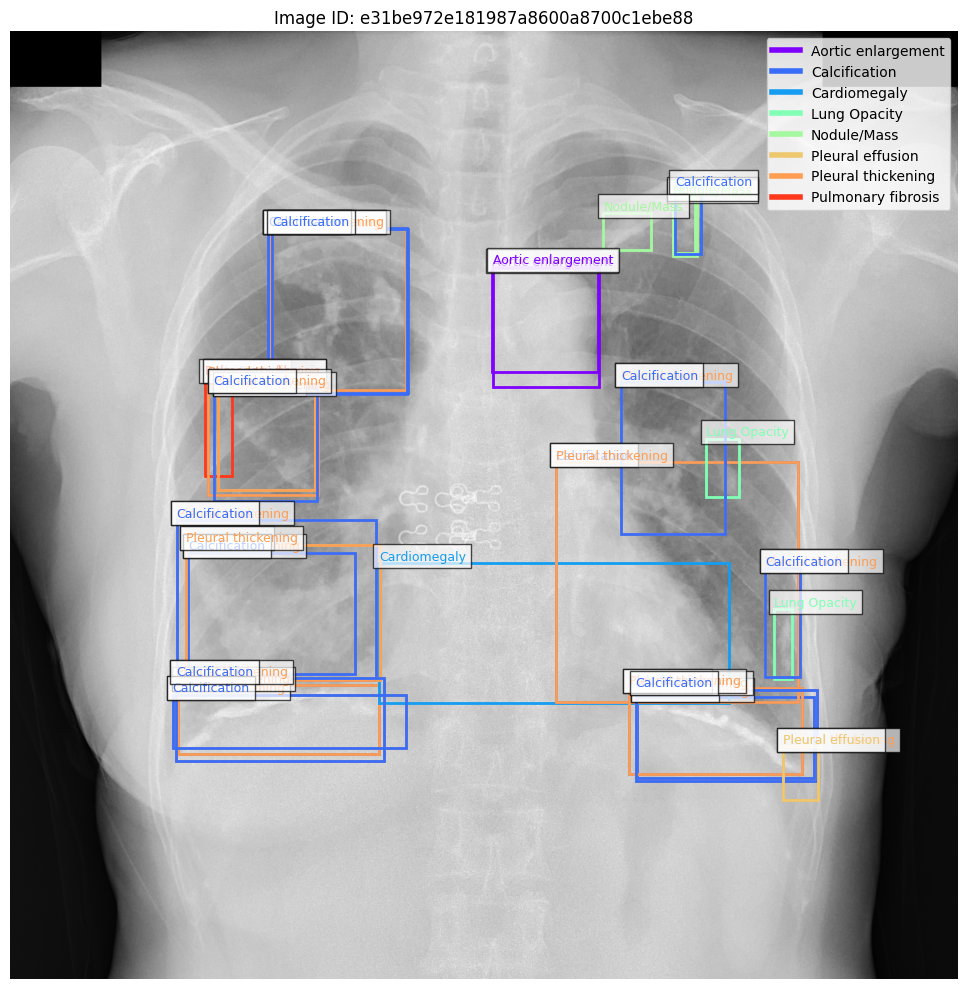

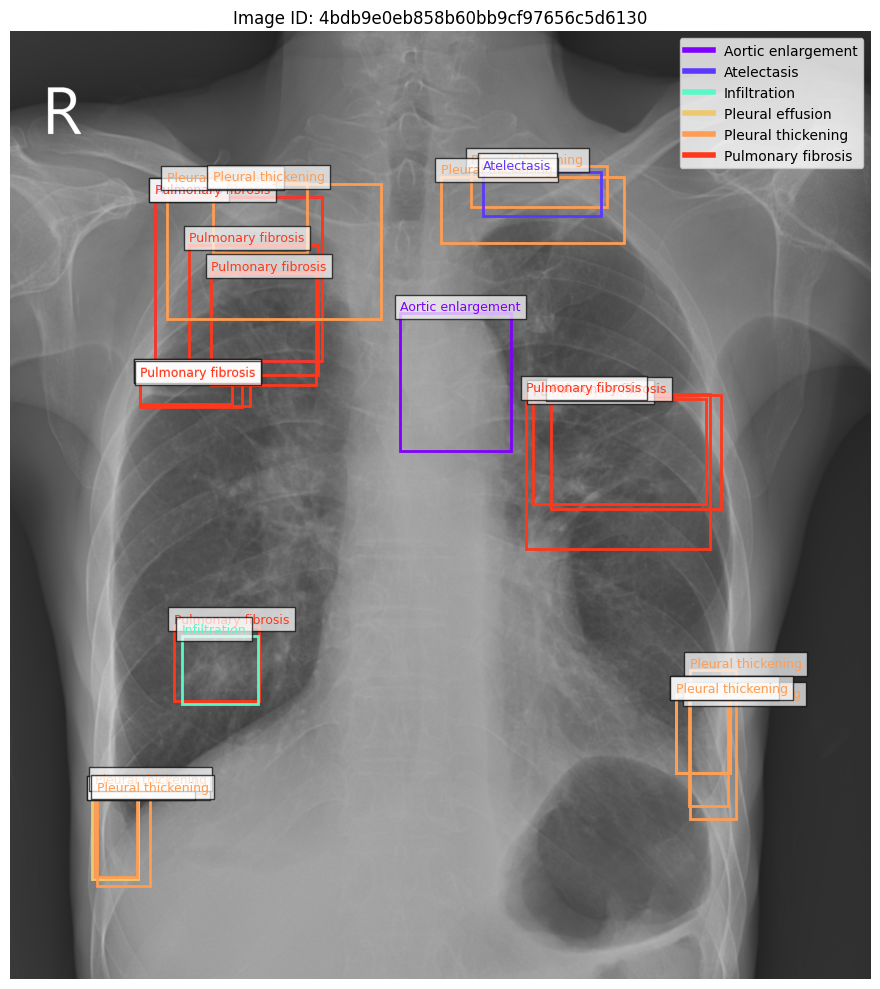

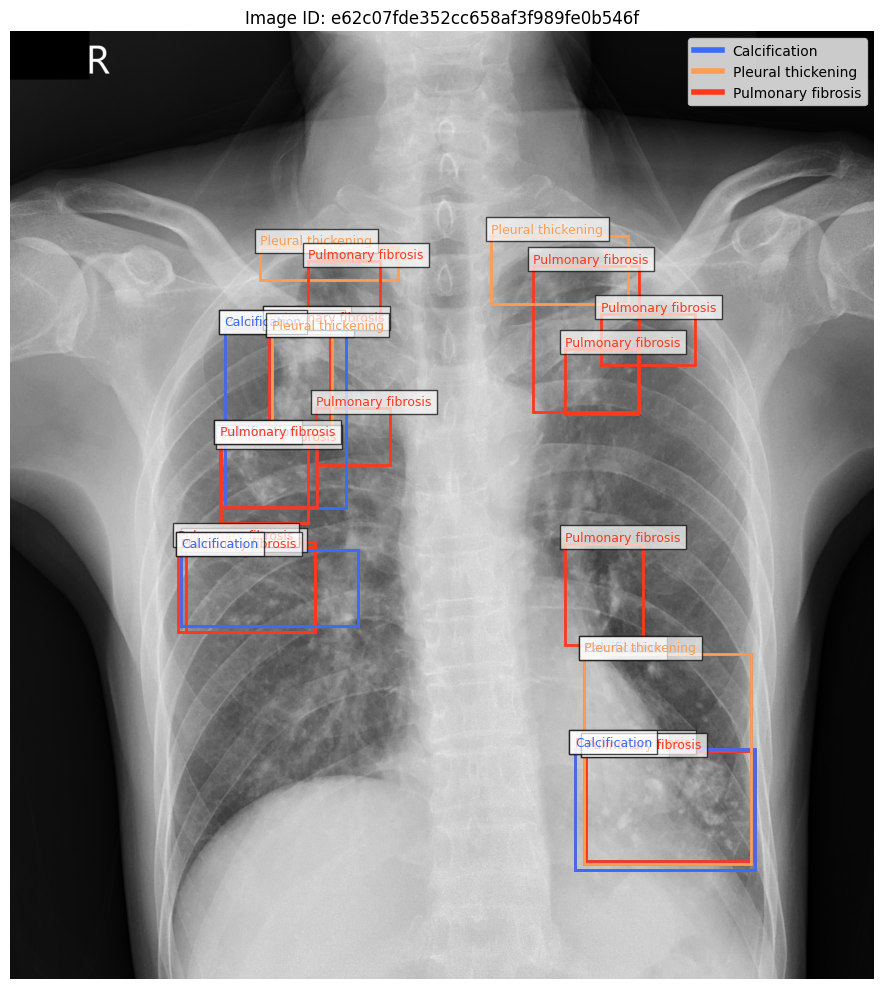

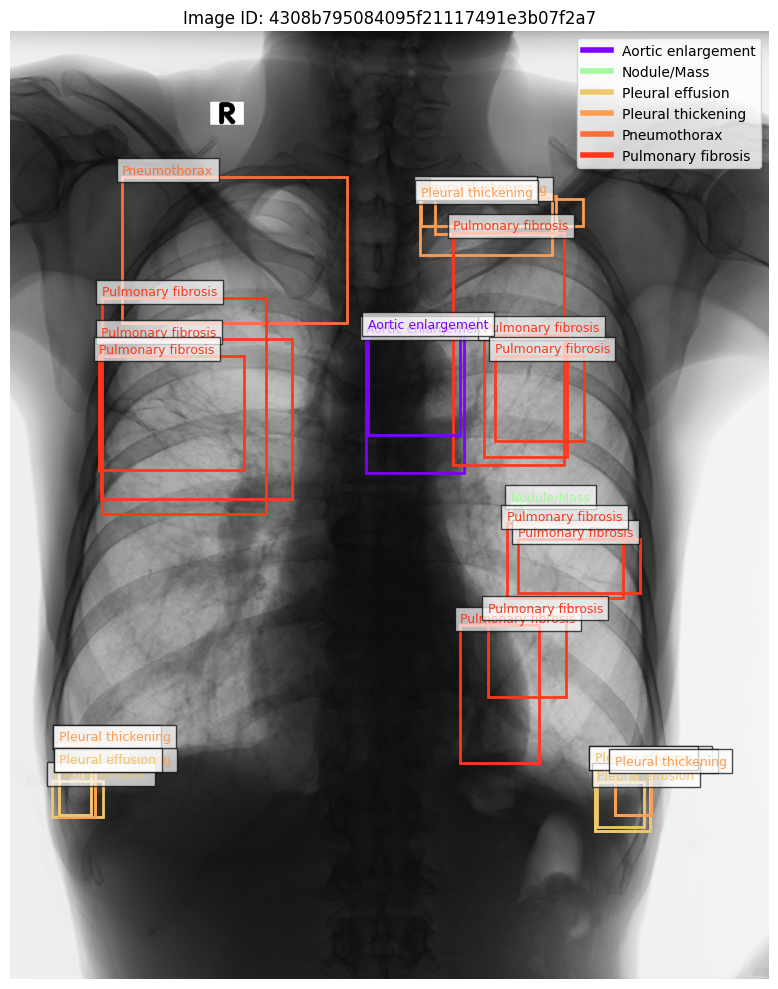

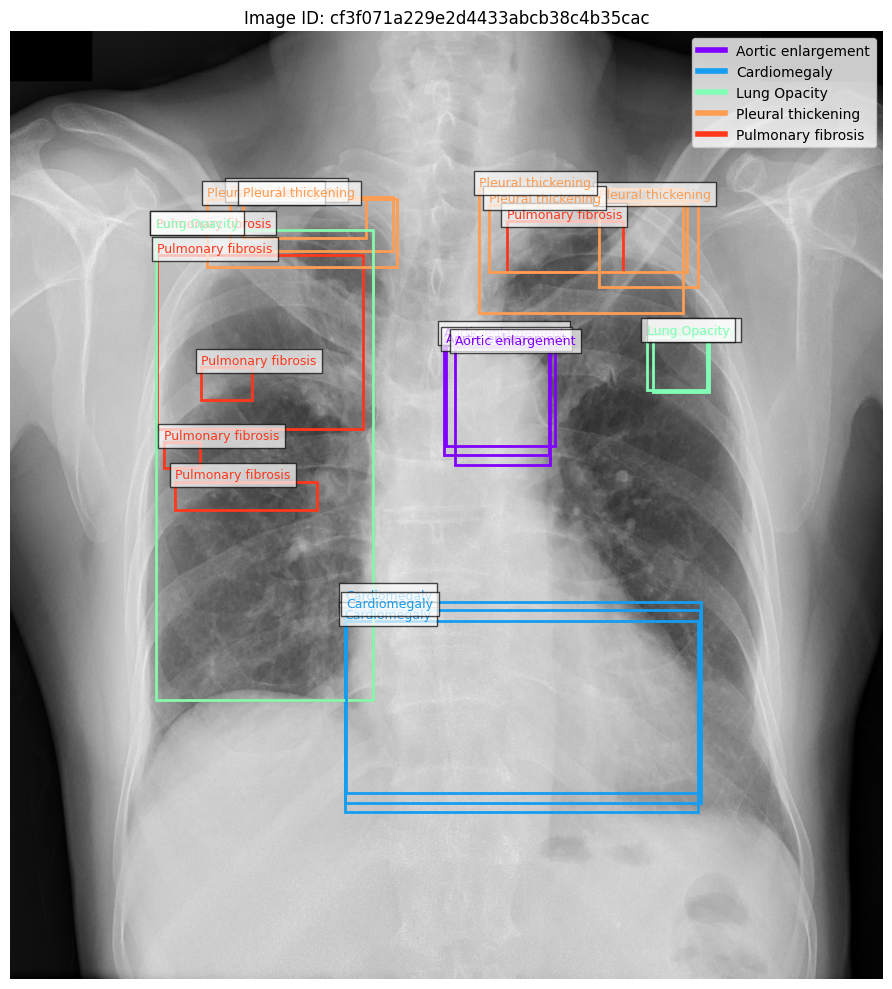

In [ ]:
# Display sample images with annotations
print("\nVisualizing sample images with annotations...")
sample_ids = selected_image_ids[:5]  # Take first 3 samples
for img_id in sample_ids:
    if img_id in image_files:
        img_path = image_files[img_id]
        img = read_dicom(img_path)
        if img is not None:
            # Create visualization
            plt.figure(figsize=(10, 10))
            plt.imshow(img, cmap='gray')
            plt.title(f"Image ID: {img_id}")

            # Get annotations for this image
            img_annotations = annotations_df[annotations_df['image_id'] == img_id]

            # Define colors for different classes
            colors = plt.cm.rainbow(np.linspace(0, 1, 15))
            used_classes = set()

            # Draw bounding boxes
            for _, row in img_annotations.iterrows():
                if 'x_min' in row and 'y_min' in row and 'x_max' in row and 'y_max' in row:
                    class_id = row['class_id']
                    if class_id != 14:  # Skip "No finding" class
                        color = colors[class_id % len(colors)]
                        rect = plt.Rectangle((row['x_min'], row['y_min']),
                                           row['x_max'] - row['x_min'],
                                           row['y_max'] - row['y_min'],
                                           fill=False, edgecolor=color, linewidth=2)
                        plt.gca().add_patch(rect)
                        plt.text(row['x_min'], row['y_min'] - 10, CLASS_NAMES[class_id],
                                color=color, fontsize=9,
                                bbox=dict(facecolor='white', alpha=0.7))
                        used_classes.add(class_id)

            # Add legend
            if used_classes:
                legend_elements = [plt.Line2D([0], [0], color=colors[c % len(colors)],
                                           lw=4, label=CLASS_NAMES[c]) for c in used_classes]
                plt.legend(handles=legend_elements, loc='upper right')

            plt.axis('off')
            plt.tight_layout()
            plt.show()

## 3.2 Feature Extraction
Extract and visualize engineered features from the chest X-ray images.

Initializing feature extractor...
Initializing CNN model for feature extraction...
29084464/29084464 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step
CNN model for feature extraction initialized: True
CNN model type: Functional

Extracting and visualizing features for sample images...
Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Creating feature extractor using model directly
Feature extractor created successfully: True
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features

Sample 1: Image ID e31be972e181987a8600a8700c1ebe88
Extracted 47503 features


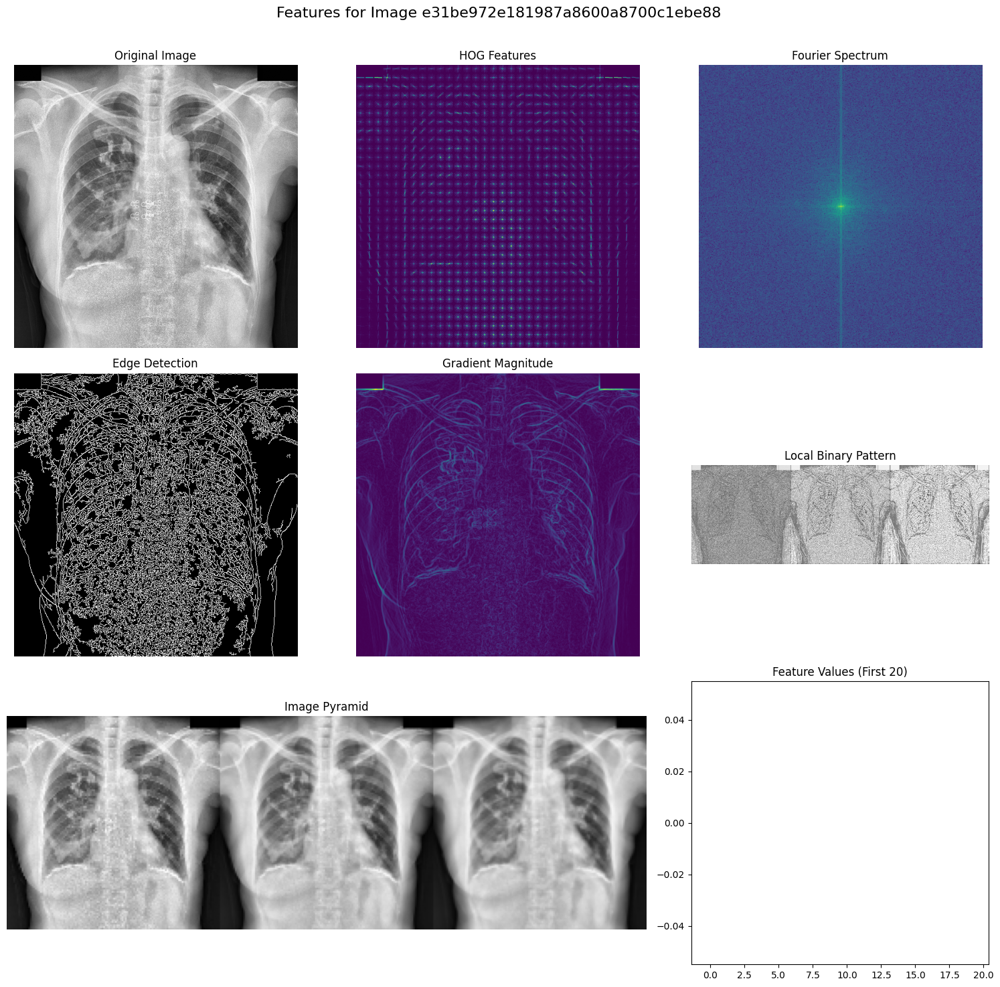

CNN features successfully extracted: 1024 features

Visualizing multi-channel image for CNN input:


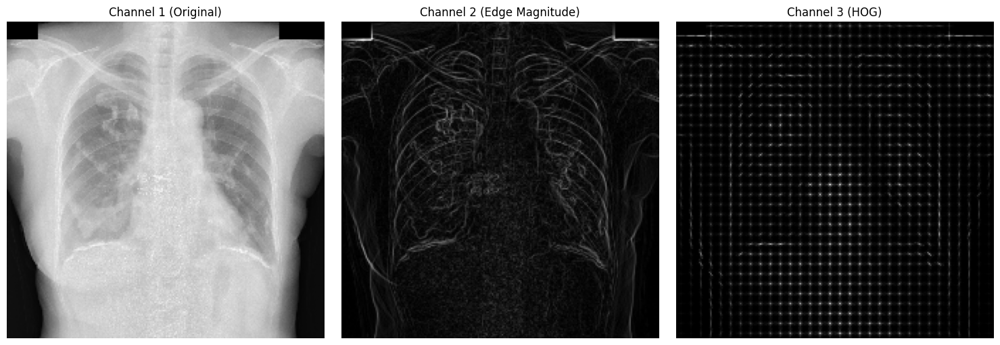

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features

Sample 2: Image ID 4bdb9e0eb858b60bb9cf97656c5d6130
Extracted 47503 features


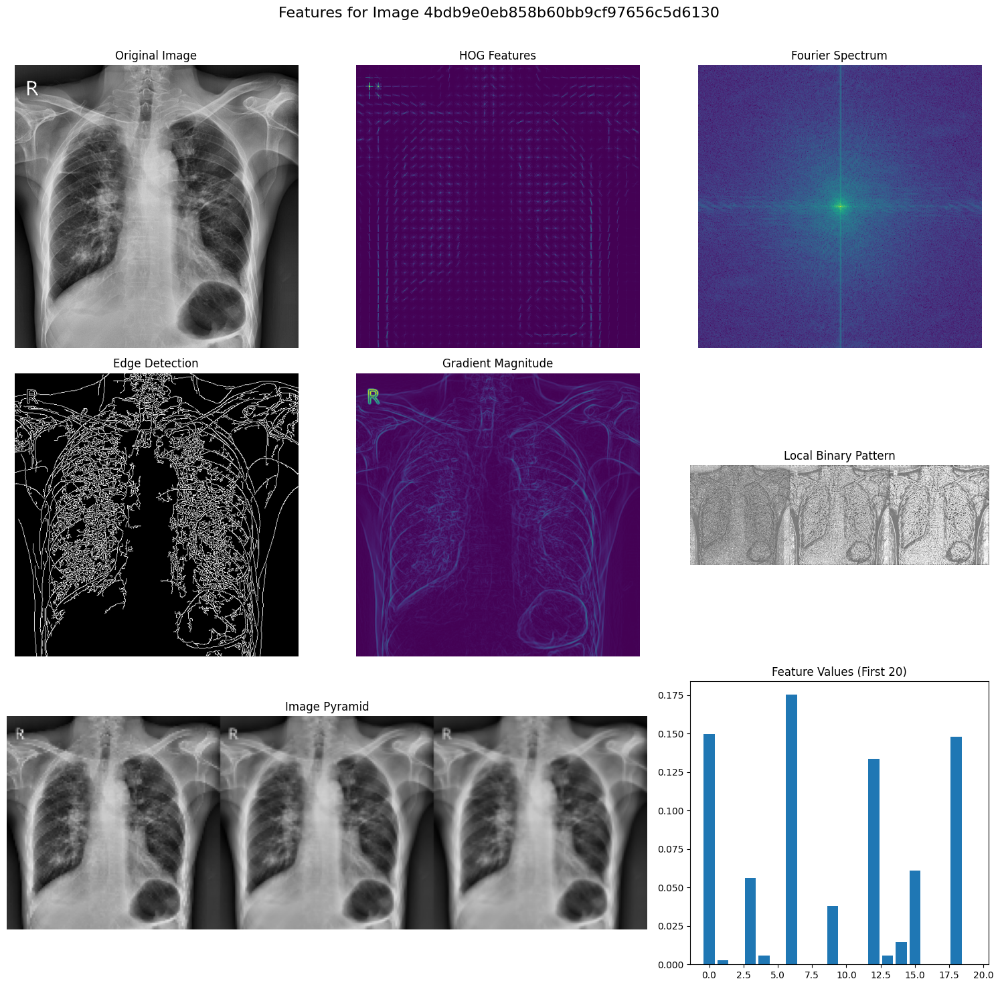

CNN features successfully extracted: 1024 features

Visualizing multi-channel image for CNN input:


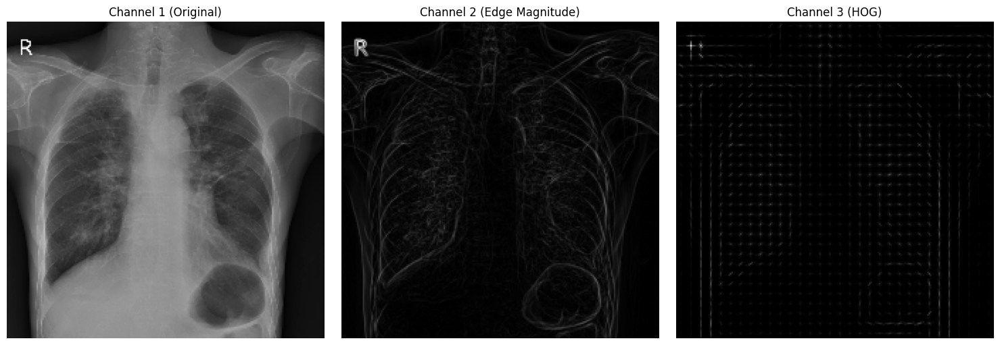

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features

Sample 3: Image ID e62c07fde352cc658af3f989fe0b546f
Extracted 47503 features


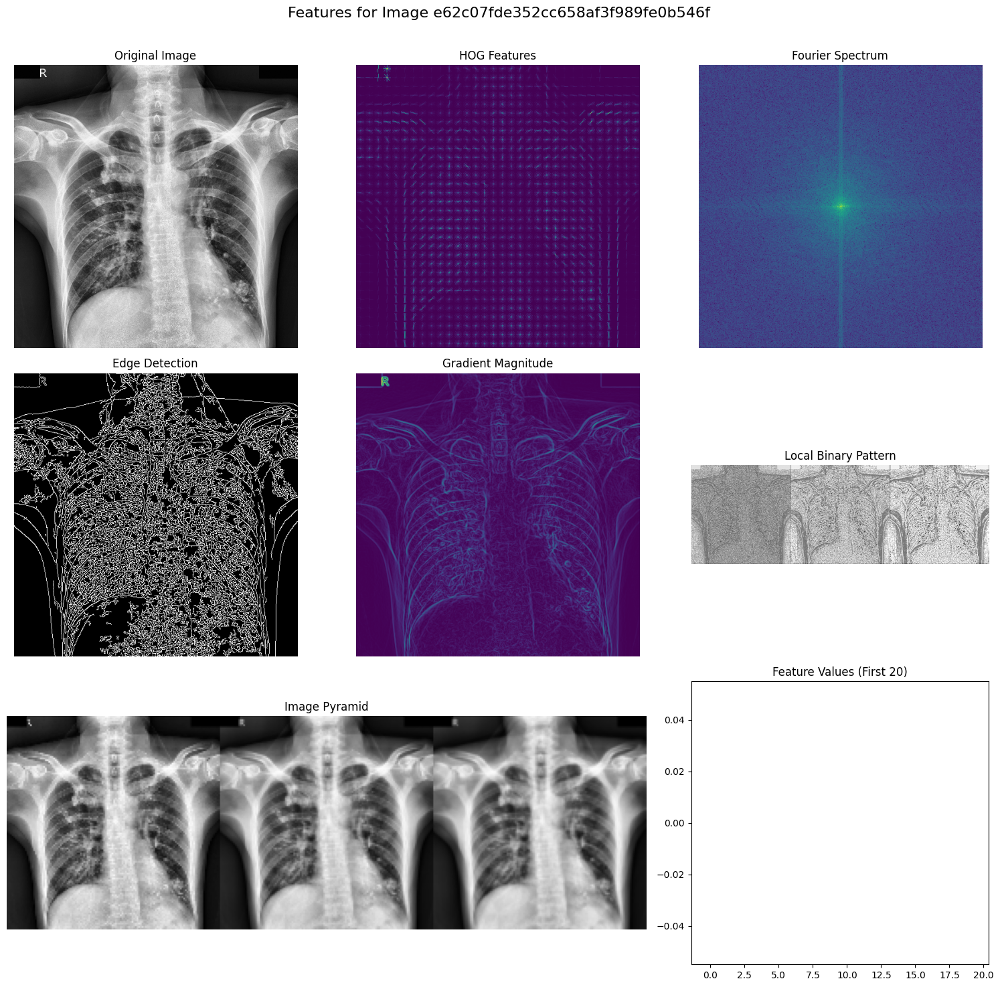

CNN features successfully extracted: 1024 features

Visualizing multi-channel image for CNN input:


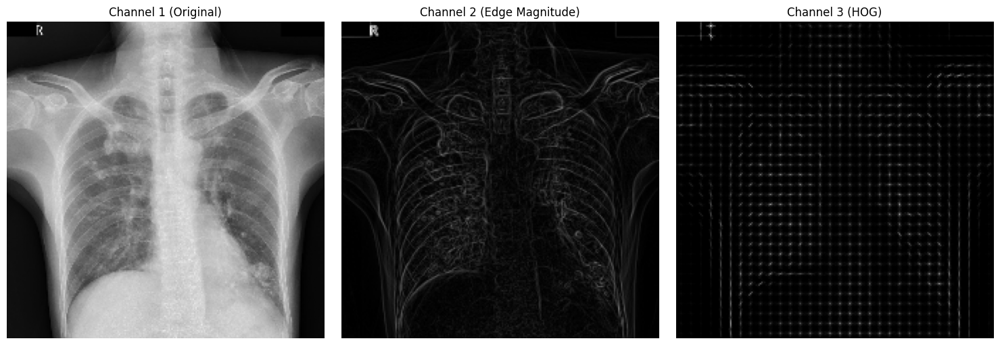

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features

Sample 4: Image ID 4308b795084095f21117491e3b07f2a7
Extracted 47503 features


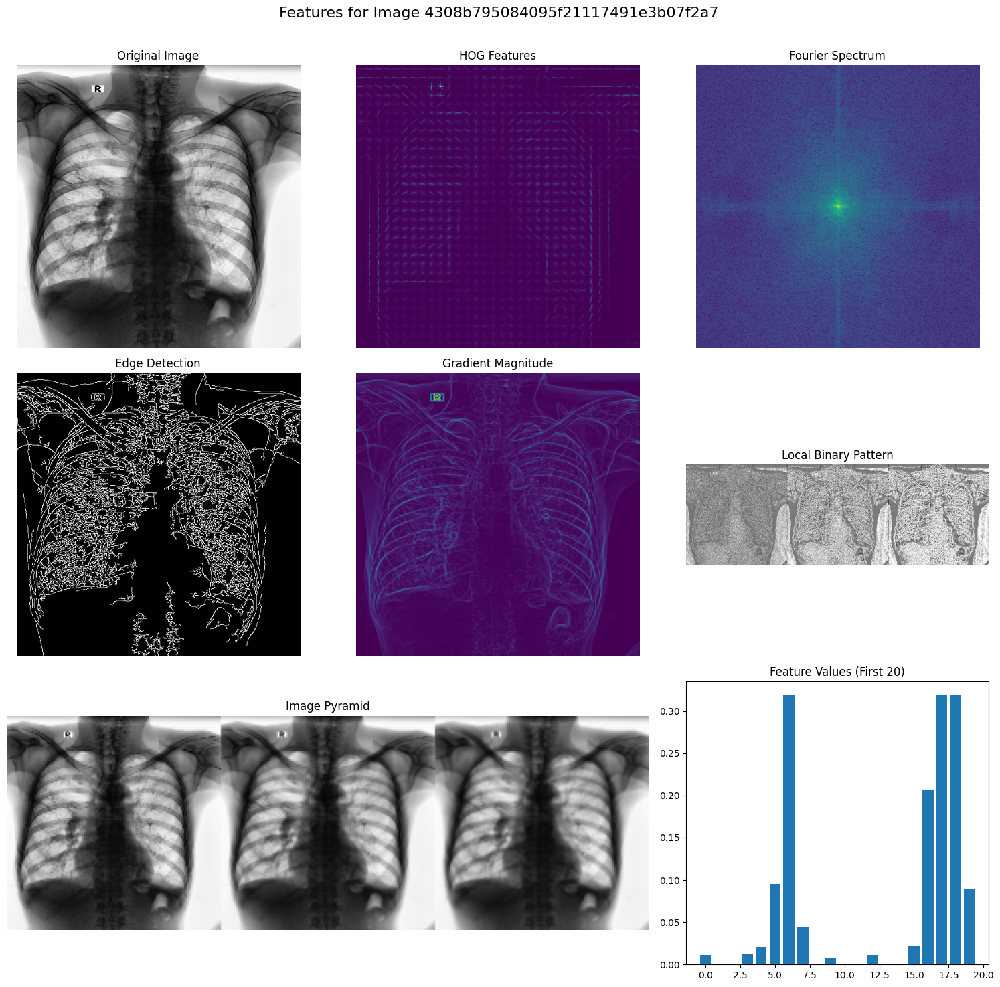

CNN features successfully extracted: 1024 features

Visualizing multi-channel image for CNN input:


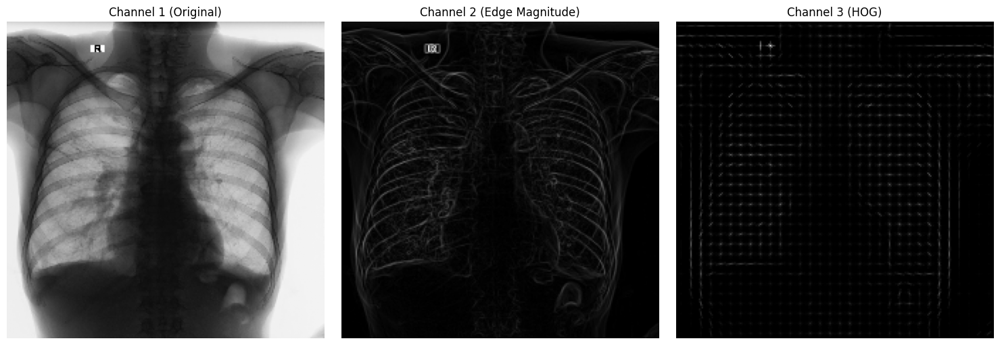

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features

Sample 5: Image ID cf3f071a229e2d4433abcb38c4b35cac
Extracted 47503 features


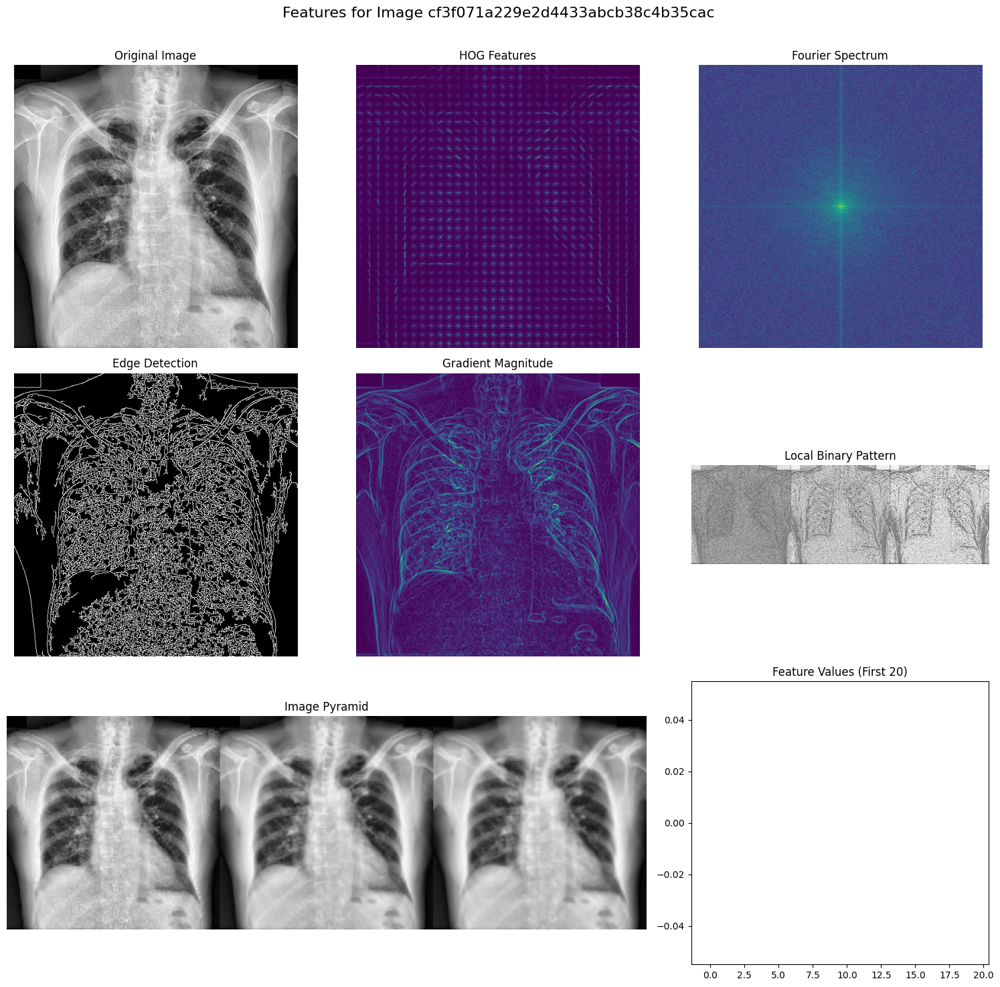

CNN features successfully extracted: 1024 features

Visualizing multi-channel image for CNN input:


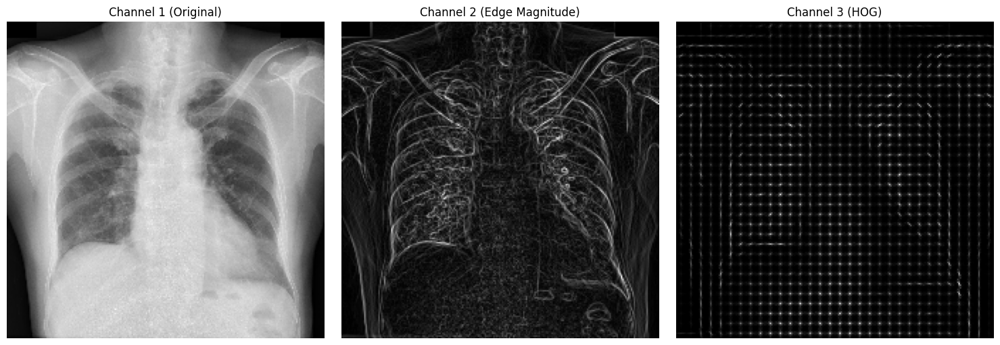

In [ ]:
# Initialize feature extractor
print("Initializing feature extractor...")
all_spatial_keys = compute_all_possible_spatial_keys(annotations_df, selected_classes)
feature_extractor = FeatureExtractor(
    config=CONFIG['feature_extraction'],
    annotations_df=annotations_df,
    all_spatial_keys=all_spatial_keys
)

# Add this validation check:
if CONFIG['feature_extraction']['cnn_features']:
    print(f"CNN model for feature extraction initialized: {feature_extractor.cnn_model is not None}")
    if feature_extractor.cnn_model is not None:
        print(f"CNN model type: {type(feature_extractor.cnn_model).__name__}")

# Extract and visualize features for a sample image
print("\nExtracting and visualizing features for sample images...")
for i, img_id in enumerate(selected_image_ids[:5]):  # Process 5 sample images
    if img_id in image_files:
        img_path = image_files[img_id]
        img = read_dicom(img_path)
        if img is not None:
            # Preprocess image
            preprocessed_img = preprocess_image(img, CONFIG['img_size'])

            # Extract features
            features, feature_dict = feature_extractor(preprocessed_img,
                                                      image_id=img_id,
                                                      return_all=True)

            # Visualize features
            if features is not None:
                print(f"\nSample {i+1}: Image ID {img_id}")
                print(f"Extracted {len(features)} features")
                visualize_features(preprocessed_img, feature_dict,
                                  title=f"Features for Image {img_id}")

                # Add this validation for CNN features
                if CONFIG['feature_extraction']['cnn_features']:
                    if 'cnn' in feature_dict:
                        print(f"CNN features successfully extracted: {len(feature_dict['cnn']['features'])} features")
                    else:
                        print("Warning: CNN features were not extracted!")

                # Add visualization for multi-channel image preparation
                if CONFIG['feature_extraction']['cnn_features']:
                    print("\nVisualizing multi-channel image for CNN input:")
                    multi_channel_img = prepare_image_for_cnn(img, feature_dict)

                    plt.figure(figsize=(15, 5))
                    titles = ['Channel 1 (Original)', 'Channel 2 (Edge Magnitude)', 'Channel 3 (HOG)']
                    for c in range(3):
                        plt.subplot(1, 3, c+1)
                        plt.imshow(multi_channel_img[:,:,c], cmap='gray')
                        plt.title(titles[c])
                        plt.axis('off')
                    plt.tight_layout()
                    plt.show()



In [ ]:
# Create combined dataset for all models in a single pass
print("\nCreating datasets for all models in a single pass...")

# Create a dictionary to store all feature components
all_feature_components = {
    'hog': [],
    'fourier': [],
    'edge': [],
    'pyramid': [],
    'lbp': [],
    'spatial': [],
    'cnn': []
}

X = []  # Features for LR
X_img = []  # Images for CNN
y = []  # Labels
processed_ids = []

# CNN tracking variables:
cnn_feature_counts = 0
total_feature_dimensions = []

for img_id in tqdm(selected_image_ids, desc="Processing images"):
    if img_id not in image_files:
        continue

    # Read image once
    img_path = image_files[img_id]
    img = read_dicom(img_path)
    if img is None:
        continue

    # Process for feature extraction (for LR)
    preprocessed_img = preprocess_image(img, CONFIG['img_size'])
    if preprocessed_img is None:
        continue

    # Extract features
    features, feature_dict = feature_extractor(preprocessed_img, image_id=img_id, return_all=True)
    if features is None or len(features) == 0:
        continue

    # ADDED: Store each feature component separately
    for feature_type in all_feature_components:
        if feature_type in feature_dict and 'features' in feature_dict[feature_type]:
            all_feature_components[feature_type].append(feature_dict[feature_type]['features'])
        else:
            # Add placeholder of zeros if this feature type is missing
            all_feature_components[feature_type].append(np.zeros(1))

    # Also process for CNN in the same pass
    img_for_cnn = prepare_image_for_cnn(img, feature_dict)
    if img_for_cnn is None:
        continue

    # Create label vector
    label = np.zeros(len(selected_classes))
    for i, class_id in enumerate(selected_classes):
        if class_id in multilabel_map.get(img_id, []):
            label[i] = 1

    # Store all data
    X.append(features)
    X_img.append(img_for_cnn)
    y.append(label)
    processed_ids.append(img_id)

    # Tracking code:
    if CONFIG['feature_extraction']['cnn_features'] and 'cnn' in feature_dict:
        cnn_feature_counts += 1
        total_feature_dimensions.append(len(features))

# Convert to numpy arrays
X = np.array(X)
y = np.array(y)
X_img = np.array(X_img)

# Add this statistics display code:
if CONFIG['feature_extraction']['cnn_features']:
    print(f"\nCNN feature extraction statistics:")
    print(f"- Successfully extracted CNN features for {cnn_feature_counts}/{len(processed_ids)} images ({cnn_feature_counts/len(processed_ids)*100:.1f}%)")
    if total_feature_dimensions:
        print(f"- Average feature vector dimension: {np.mean(total_feature_dimensions):.1f}")
        if len(total_feature_dimensions) > 1:
            print(f"- Feature dimension variance: {np.var(total_feature_dimensions):.1f}")

print(f"Created datasets with {X.shape[0]} samples:")

# # Convert to numpy arrays
# X = np.array(X)
# y = np.array(y)
# X_img = np.array(X_img)

print(f"Created datasets with {X.shape[0]} samples:")
print(f"- LR features: {X.shape[1]} features")
print(f"- CNN images: {X_img.shape[1:]} dimensions")
print(f"- Classes: {y.shape[1]} classes")




Creating datasets for all models in a single pass...


Processing images:   0%|          | 1/802 [00:00<10:52,  1.23it/s]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   0%|          | 2/802 [00:03<28:42,  2.15s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   0%|          | 3/802 [00:04<20:37,  1.55s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   0%|          | 4/802 [00:07<28:42,  2.16s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   1%|          | 5/802 [00:08<22:22,  1.68s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   1%|          | 6/802 [00:12<34:15,  2.58s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   1%|          | 7/802 [00:14<31:02,  2.34s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   1%|          | 8/802 [00:16<28:39,  2.17s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   1%|          | 9/802 [00:18<28:01,  2.12s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   1%|          | 10/802 [00:20<26:51,  2.03s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   1%|▏         | 11/802 [00:23<30:54,  2.34s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   1%|▏         | 12/802 [00:25<28:52,  2.19s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   2%|▏         | 13/802 [00:27<29:08,  2.22s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   2%|▏         | 14/802 [00:31<36:36,  2.79s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   2%|▏         | 15/802 [00:34<38:05,  2.90s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   2%|▏         | 16/802 [00:37<35:48,  2.73s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   2%|▏         | 17/802 [00:40<37:47,  2.89s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   2%|▏         | 18/802 [00:42<34:42,  2.66s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   2%|▏         | 19/802 [00:44<31:22,  2.40s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   2%|▏         | 20/802 [00:46<29:20,  2.25s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   3%|▎         | 21/802 [00:50<35:00,  2.69s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   3%|▎         | 22/802 [00:51<30:37,  2.36s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   3%|▎         | 23/802 [00:53<28:16,  2.18s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   3%|▎         | 24/802 [00:56<33:41,  2.60s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   3%|▎         | 25/802 [00:59<32:23,  2.50s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   3%|▎         | 26/802 [01:02<36:15,  2.80s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   3%|▎         | 27/802 [01:04<32:09,  2.49s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   3%|▎         | 28/802 [01:06<29:36,  2.30s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   4%|▎         | 29/802 [01:10<37:31,  2.91s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   4%|▎         | 30/802 [01:15<44:17,  3.44s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   4%|▍         | 31/802 [01:17<38:43,  3.01s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   4%|▍         | 32/802 [01:19<34:23,  2.68s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   4%|▍         | 33/802 [01:21<31:45,  2.48s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   4%|▍         | 34/802 [01:23<29:15,  2.29s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   4%|▍         | 35/802 [01:27<36:37,  2.86s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   4%|▍         | 36/802 [01:31<41:49,  3.28s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   5%|▍         | 37/802 [01:33<36:59,  2.90s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   5%|▍         | 38/802 [01:35<32:19,  2.54s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   5%|▍         | 39/802 [01:37<29:46,  2.34s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   5%|▍         | 40/802 [01:40<33:16,  2.62s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   5%|▌         | 41/802 [01:42<31:03,  2.45s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   5%|▌         | 42/802 [01:46<37:12,  2.94s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   5%|▌         | 43/802 [01:48<32:41,  2.58s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   5%|▌         | 44/802 [01:50<29:44,  2.35s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   6%|▌         | 45/802 [01:54<37:31,  2.97s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   6%|▌         | 46/802 [01:58<41:16,  3.28s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   6%|▌         | 47/802 [02:02<42:50,  3.40s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   6%|▌         | 48/802 [02:04<36:37,  2.91s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   6%|▌         | 49/802 [02:06<33:05,  2.64s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   6%|▌         | 50/802 [02:07<30:09,  2.41s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   6%|▋         | 51/802 [02:09<28:33,  2.28s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   6%|▋         | 52/802 [02:11<26:55,  2.15s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   7%|▋         | 53/802 [02:13<26:28,  2.12s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   7%|▋         | 54/802 [02:16<27:13,  2.18s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   7%|▋         | 55/802 [02:20<34:19,  2.76s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   7%|▋         | 56/802 [02:24<39:32,  3.18s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   7%|▋         | 57/802 [02:26<34:59,  2.82s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   7%|▋         | 58/802 [02:28<30:57,  2.50s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   7%|▋         | 59/802 [02:32<37:35,  3.04s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   7%|▋         | 60/802 [02:34<33:44,  2.73s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   8%|▊         | 61/802 [02:36<30:25,  2.46s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   8%|▊         | 62/802 [02:40<36:33,  2.96s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   8%|▊         | 63/802 [02:42<32:52,  2.67s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   8%|▊         | 64/802 [02:46<37:48,  3.07s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   8%|▊         | 65/802 [02:48<34:23,  2.80s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   8%|▊         | 66/802 [02:50<30:32,  2.49s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   8%|▊         | 67/802 [02:52<28:21,  2.31s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   8%|▊         | 68/802 [02:56<35:01,  2.86s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   9%|▊         | 69/802 [02:58<32:14,  2.64s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   9%|▊         | 70/802 [03:02<37:53,  3.11s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   9%|▉         | 71/802 [03:04<32:17,  2.65s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   9%|▉         | 72/802 [03:06<29:09,  2.40s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   9%|▉         | 73/802 [03:10<36:54,  3.04s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   9%|▉         | 74/802 [03:12<32:35,  2.69s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   9%|▉         | 75/802 [03:16<37:47,  3.12s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:   9%|▉         | 76/802 [03:18<32:27,  2.68s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  10%|▉         | 77/802 [03:20<28:57,  2.40s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  10%|▉         | 78/802 [03:23<32:49,  2.72s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  10%|▉         | 79/802 [03:25<31:03,  2.58s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  10%|▉         | 80/802 [03:27<28:25,  2.36s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  10%|█         | 81/802 [03:30<31:47,  2.65s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  10%|█         | 82/802 [03:34<35:28,  2.96s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  10%|█         | 83/802 [03:36<31:22,  2.62s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  10%|█         | 84/802 [03:40<36:03,  3.01s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  11%|█         | 85/802 [03:44<38:46,  3.25s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  11%|█         | 86/802 [03:46<34:08,  2.86s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  11%|█         | 87/802 [03:48<31:02,  2.60s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  11%|█         | 88/802 [03:49<28:25,  2.39s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  11%|█         | 89/802 [03:54<35:30,  2.99s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  11%|█         | 90/802 [03:58<40:13,  3.39s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  11%|█▏        | 91/802 [04:03<44:52,  3.79s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  11%|█▏        | 92/802 [04:07<47:15,  3.99s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  12%|█▏        | 93/802 [04:09<38:59,  3.30s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  12%|█▏        | 94/802 [04:14<44:13,  3.75s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  12%|█▏        | 95/802 [04:16<37:07,  3.15s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  12%|█▏        | 96/802 [04:17<32:35,  2.77s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  12%|█▏        | 97/802 [04:19<29:41,  2.53s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  12%|█▏        | 98/802 [04:23<33:25,  2.85s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  12%|█▏        | 99/802 [04:25<30:44,  2.62s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  12%|█▏        | 100/802 [04:27<27:14,  2.33s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  13%|█▎        | 101/802 [04:29<25:45,  2.21s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  13%|█▎        | 102/802 [04:31<25:13,  2.16s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  13%|█▎        | 103/802 [04:34<30:15,  2.60s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  13%|█▎        | 104/802 [04:39<35:37,  3.06s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  13%|█▎        | 105/802 [04:41<32:28,  2.80s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  13%|█▎        | 106/802 [04:45<38:12,  3.29s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  13%|█▎        | 107/802 [04:49<40:50,  3.53s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  13%|█▎        | 108/802 [04:53<40:34,  3.51s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  14%|█▎        | 109/802 [04:55<35:09,  3.04s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  14%|█▎        | 110/802 [04:59<38:36,  3.35s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  14%|█▍        | 111/802 [05:00<33:08,  2.88s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  14%|█▍        | 112/802 [05:02<28:53,  2.51s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  14%|█▍        | 113/802 [05:06<32:01,  2.79s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  14%|█▍        | 114/802 [05:10<36:46,  3.21s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  14%|█▍        | 115/802 [05:14<39:27,  3.45s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  14%|█▍        | 116/802 [05:16<33:50,  2.96s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  15%|█▍        | 117/802 [05:20<38:33,  3.38s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  15%|█▍        | 118/802 [05:24<40:52,  3.59s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  15%|█▍        | 119/802 [05:28<42:35,  3.74s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  15%|█▍        | 120/802 [05:30<37:32,  3.30s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  15%|█▌        | 121/802 [05:32<32:09,  2.83s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  15%|█▌        | 122/802 [05:34<29:32,  2.61s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  15%|█▌        | 123/802 [05:38<33:10,  2.93s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  15%|█▌        | 124/802 [05:40<29:42,  2.63s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  16%|█▌        | 125/802 [05:42<27:00,  2.39s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  16%|█▌        | 126/802 [05:44<25:51,  2.30s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  16%|█▌        | 127/802 [05:45<23:34,  2.09s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  16%|█▌        | 128/802 [05:47<22:42,  2.02s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  16%|█▌        | 129/802 [05:51<30:06,  2.68s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  16%|█▌        | 130/802 [05:53<27:24,  2.45s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  16%|█▋        | 131/802 [05:56<26:49,  2.40s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  16%|█▋        | 132/802 [05:59<30:00,  2.69s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  17%|█▋        | 133/802 [06:01<26:26,  2.37s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  17%|█▋        | 134/802 [06:05<31:34,  2.84s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  17%|█▋        | 135/802 [06:06<27:35,  2.48s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  17%|█▋        | 136/802 [06:11<34:19,  3.09s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  17%|█▋        | 137/802 [06:15<39:46,  3.59s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  17%|█▋        | 138/802 [06:17<34:31,  3.12s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  17%|█▋        | 139/802 [06:19<30:24,  2.75s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  17%|█▋        | 140/802 [06:21<28:03,  2.54s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  18%|█▊        | 141/802 [06:23<25:22,  2.30s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  18%|█▊        | 142/802 [06:25<23:48,  2.16s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  18%|█▊        | 143/802 [06:27<22:28,  2.05s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  18%|█▊        | 144/802 [06:31<29:12,  2.66s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  18%|█▊        | 145/802 [06:33<26:59,  2.47s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  18%|█▊        | 146/802 [06:35<25:25,  2.32s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  18%|█▊        | 147/802 [06:39<31:01,  2.84s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  18%|█▊        | 148/802 [06:41<27:30,  2.52s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  19%|█▊        | 149/802 [06:43<25:47,  2.37s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  19%|█▊        | 150/802 [06:47<30:40,  2.82s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features
Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)


Processing images:  19%|█▉        | 151/802 [06:49<28:44,  2.65s/it]

Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  19%|█▉        | 152/802 [06:51<26:28,  2.44s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  19%|█▉        | 153/802 [06:55<30:31,  2.82s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  19%|█▉        | 154/802 [06:56<27:12,  2.52s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  19%|█▉        | 155/802 [07:01<32:30,  3.01s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  19%|█▉        | 156/802 [07:04<32:50,  3.05s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  20%|█▉        | 157/802 [07:08<37:05,  3.45s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  20%|█▉        | 158/802 [07:13<42:02,  3.92s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  20%|█▉        | 159/802 [07:18<44:24,  4.14s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  20%|█▉        | 160/802 [07:20<36:46,  3.44s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  20%|██        | 161/802 [07:21<31:06,  2.91s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  20%|██        | 162/802 [07:25<35:14,  3.30s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  20%|██        | 163/802 [07:30<39:19,  3.69s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  20%|██        | 164/802 [07:34<41:39,  3.92s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features
Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)


Processing images:  21%|██        | 165/802 [07:36<35:01,  3.30s/it]

Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  21%|██        | 166/802 [07:41<37:56,  3.58s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  21%|██        | 167/802 [07:45<39:33,  3.74s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  21%|██        | 168/802 [07:47<33:37,  3.18s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  21%|██        | 169/802 [07:51<36:12,  3.43s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  21%|██        | 170/802 [07:55<38:35,  3.66s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  21%|██▏       | 171/802 [07:59<39:10,  3.73s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  21%|██▏       | 172/802 [08:03<41:15,  3.93s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  22%|██▏       | 173/802 [08:05<34:40,  3.31s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  22%|██▏       | 174/802 [08:08<34:15,  3.27s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  22%|██▏       | 175/802 [08:12<36:04,  3.45s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  22%|██▏       | 176/802 [08:14<32:25,  3.11s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  22%|██▏       | 177/802 [08:19<35:57,  3.45s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  22%|██▏       | 178/802 [08:20<30:46,  2.96s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features
Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)


Processing images:  22%|██▏       | 179/802 [08:25<34:42,  3.34s/it]

Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  22%|██▏       | 180/802 [08:27<30:28,  2.94s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  23%|██▎       | 181/802 [08:30<31:40,  3.06s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  23%|██▎       | 182/802 [08:33<31:25,  3.04s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  23%|██▎       | 183/802 [08:35<29:57,  2.90s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  23%|██▎       | 184/802 [08:37<27:08,  2.64s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  23%|██▎       | 185/802 [08:40<25:40,  2.50s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  23%|██▎       | 186/802 [08:42<24:43,  2.41s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  23%|██▎       | 187/802 [08:46<29:37,  2.89s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  23%|██▎       | 188/802 [08:50<32:13,  3.15s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  24%|██▎       | 189/802 [08:54<35:38,  3.49s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  24%|██▎       | 190/802 [08:58<36:16,  3.56s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  24%|██▍       | 191/802 [08:59<31:02,  3.05s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  24%|██▍       | 192/802 [09:01<27:11,  2.68s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  24%|██▍       | 193/802 [09:03<24:39,  2.43s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  24%|██▍       | 194/802 [09:05<22:33,  2.23s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  24%|██▍       | 195/802 [09:07<21:59,  2.17s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  24%|██▍       | 196/802 [09:09<20:35,  2.04s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  25%|██▍       | 197/802 [09:11<20:27,  2.03s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features
Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  25%|██▍       | 199/802 [09:17<25:34,  2.55s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  25%|██▍       | 200/802 [09:21<32:00,  3.19s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  25%|██▌       | 201/802 [09:24<28:28,  2.84s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  25%|██▌       | 202/802 [09:25<25:33,  2.56s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  25%|██▌       | 203/802 [09:29<29:18,  2.94s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  25%|██▌       | 204/802 [09:31<25:45,  2.58s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  26%|██▌       | 205/802 [09:35<29:20,  2.95s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  26%|██▌       | 206/802 [09:36<25:25,  2.56s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  26%|██▌       | 207/802 [09:38<23:33,  2.38s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  26%|██▌       | 208/802 [09:40<21:50,  2.21s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  26%|██▌       | 209/802 [09:44<27:40,  2.80s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  26%|██▌       | 210/802 [09:49<32:00,  3.24s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  26%|██▋       | 211/802 [09:51<28:15,  2.87s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  26%|██▋       | 212/802 [09:53<25:42,  2.61s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  27%|██▋       | 213/802 [09:57<29:35,  3.01s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  27%|██▋       | 214/802 [09:58<25:59,  2.65s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  27%|██▋       | 215/802 [10:01<27:07,  2.77s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  27%|██▋       | 216/802 [10:05<28:54,  2.96s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  27%|██▋       | 217/802 [10:07<25:21,  2.60s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  27%|██▋       | 218/802 [10:08<22:25,  2.30s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  27%|██▋       | 219/802 [10:12<25:59,  2.68s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  27%|██▋       | 220/802 [10:16<29:50,  3.08s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  28%|██▊       | 221/802 [10:20<31:40,  3.27s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  28%|██▊       | 222/802 [10:21<26:59,  2.79s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  28%|██▊       | 223/802 [10:25<30:06,  3.12s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  28%|██▊       | 224/802 [10:27<26:39,  2.77s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  28%|██▊       | 225/802 [10:29<24:20,  2.53s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  28%|██▊       | 226/802 [10:31<22:27,  2.34s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  28%|██▊       | 227/802 [10:35<27:22,  2.86s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  28%|██▊       | 228/802 [10:39<31:03,  3.25s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  29%|██▊       | 229/802 [10:41<26:58,  2.83s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  29%|██▊       | 230/802 [10:43<24:26,  2.56s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  29%|██▉       | 231/802 [10:45<21:48,  2.29s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  29%|██▉       | 232/802 [10:46<20:33,  2.16s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  29%|██▉       | 233/802 [10:48<19:09,  2.02s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  29%|██▉       | 234/802 [10:50<18:08,  1.92s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  29%|██▉       | 235/802 [10:52<18:47,  1.99s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  29%|██▉       | 236/802 [10:56<24:12,  2.57s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  30%|██▉       | 237/802 [10:58<22:01,  2.34s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  30%|██▉       | 238/802 [11:02<27:45,  2.95s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  30%|██▉       | 239/802 [11:05<28:03,  2.99s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  30%|██▉       | 240/802 [11:07<24:03,  2.57s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  30%|███       | 241/802 [11:11<28:59,  3.10s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  30%|███       | 242/802 [11:14<29:31,  3.16s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  30%|███       | 243/802 [11:19<33:31,  3.60s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  30%|███       | 244/802 [11:24<36:15,  3.90s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  31%|███       | 245/802 [11:28<38:19,  4.13s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  31%|███       | 246/802 [11:30<31:21,  3.38s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  31%|███       | 247/802 [11:32<26:37,  2.88s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  31%|███       | 248/802 [11:33<23:46,  2.58s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  31%|███       | 249/802 [11:37<26:12,  2.84s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  31%|███       | 250/802 [11:41<29:08,  3.17s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  31%|███▏      | 251/802 [11:43<25:40,  2.80s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  31%|███▏      | 252/802 [11:46<27:20,  2.98s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  32%|███▏      | 253/802 [11:48<24:02,  2.63s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  32%|███▏      | 254/802 [11:52<28:15,  3.09s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  32%|███▏      | 255/802 [11:54<24:44,  2.71s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  32%|███▏      | 256/802 [11:56<22:02,  2.42s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  32%|███▏      | 257/802 [11:58<20:17,  2.23s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  32%|███▏      | 258/802 [11:59<19:12,  2.12s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  32%|███▏      | 259/802 [12:04<24:41,  2.73s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  32%|███▏      | 260/802 [12:05<21:42,  2.40s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  33%|███▎      | 261/802 [12:09<26:10,  2.90s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  33%|███▎      | 262/802 [12:11<22:49,  2.54s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  33%|███▎      | 263/802 [12:15<27:14,  3.03s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  33%|███▎      | 264/802 [12:17<23:15,  2.59s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  33%|███▎      | 265/802 [12:18<20:49,  2.33s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  33%|███▎      | 266/802 [12:22<23:16,  2.61s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  33%|███▎      | 267/802 [12:26<27:20,  3.07s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  33%|███▎      | 268/802 [12:29<28:20,  3.18s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  34%|███▎      | 269/802 [12:33<30:52,  3.48s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  34%|███▎      | 270/802 [12:39<35:42,  4.03s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  34%|███▍      | 271/802 [12:42<33:02,  3.73s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  34%|███▍      | 272/802 [12:44<28:18,  3.20s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  34%|███▍      | 273/802 [12:46<26:21,  2.99s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  34%|███▍      | 274/802 [12:48<22:41,  2.58s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  34%|███▍      | 275/802 [12:52<27:03,  3.08s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  34%|███▍      | 276/802 [12:54<23:19,  2.66s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  35%|███▍      | 277/802 [12:55<20:16,  2.32s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  35%|███▍      | 278/802 [12:57<18:38,  2.14s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  35%|███▍      | 279/802 [13:00<20:59,  2.41s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  35%|███▍      | 280/802 [13:04<25:05,  2.88s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  35%|███▌      | 281/802 [13:08<27:40,  3.19s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  35%|███▌      | 282/802 [13:09<23:03,  2.66s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  35%|███▌      | 283/802 [13:13<26:07,  3.02s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  35%|███▌      | 284/802 [13:15<23:19,  2.70s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  36%|███▌      | 285/802 [13:17<21:24,  2.48s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  36%|███▌      | 286/802 [13:21<24:50,  2.89s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  36%|███▌      | 287/802 [13:23<21:45,  2.54s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  36%|███▌      | 288/802 [13:27<25:04,  2.93s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  36%|███▌      | 289/802 [13:30<25:19,  2.96s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  36%|███▌      | 290/802 [13:31<22:01,  2.58s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  36%|███▋      | 291/802 [13:33<19:23,  2.28s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  36%|███▋      | 292/802 [13:35<17:52,  2.10s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  37%|███▋      | 293/802 [13:37<17:43,  2.09s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  37%|███▋      | 294/802 [13:38<16:37,  1.96s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  37%|███▋      | 295/802 [13:42<22:01,  2.61s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  37%|███▋      | 296/802 [13:46<25:37,  3.04s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  37%|███▋      | 297/802 [13:48<22:30,  2.67s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  37%|███▋      | 298/802 [13:52<24:08,  2.87s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  37%|███▋      | 299/802 [13:55<24:40,  2.94s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  37%|███▋      | 300/802 [13:56<21:33,  2.58s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  38%|███▊      | 301/802 [13:58<19:01,  2.28s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  38%|███▊      | 302/802 [14:02<24:07,  2.89s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  38%|███▊      | 303/802 [14:06<26:50,  3.23s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  38%|███▊      | 304/802 [14:08<22:41,  2.73s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  38%|███▊      | 305/802 [14:13<27:42,  3.34s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  38%|███▊      | 306/802 [14:16<28:38,  3.47s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  38%|███▊      | 307/802 [14:21<30:58,  3.75s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  38%|███▊      | 308/802 [14:26<34:52,  4.24s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  39%|███▊      | 309/802 [14:30<33:39,  4.10s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  39%|███▊      | 310/802 [14:32<27:52,  3.40s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  39%|███▉      | 311/802 [14:34<24:00,  2.93s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  39%|███▉      | 312/802 [14:35<21:17,  2.61s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  39%|███▉      | 313/802 [14:39<23:05,  2.83s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  39%|███▉      | 314/802 [14:43<25:22,  3.12s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  39%|███▉      | 315/802 [14:46<26:24,  3.25s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  39%|███▉      | 316/802 [14:50<28:12,  3.48s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  40%|███▉      | 317/802 [14:55<30:36,  3.79s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  40%|███▉      | 318/802 [14:59<31:01,  3.85s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  40%|███▉      | 319/802 [15:00<25:52,  3.21s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  40%|███▉      | 320/802 [15:02<22:13,  2.77s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  40%|████      | 321/802 [15:06<25:46,  3.21s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  40%|████      | 322/802 [15:10<26:07,  3.27s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  40%|████      | 323/802 [15:12<22:56,  2.87s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  40%|████      | 324/802 [15:14<21:38,  2.72s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  41%|████      | 325/802 [15:16<19:43,  2.48s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  41%|████      | 326/802 [15:20<24:01,  3.03s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  41%|████      | 327/802 [15:25<26:42,  3.37s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  41%|████      | 328/802 [15:26<22:28,  2.84s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  41%|████      | 329/802 [15:28<19:42,  2.50s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  41%|████      | 330/802 [15:30<18:25,  2.34s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  41%|████▏     | 331/802 [15:32<17:33,  2.24s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  41%|████▏     | 332/802 [15:36<21:43,  2.77s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  42%|████▏     | 333/802 [15:38<19:26,  2.49s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  42%|████▏     | 334/802 [15:42<22:39,  2.90s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  42%|████▏     | 335/802 [15:46<25:52,  3.32s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  42%|████▏     | 336/802 [15:48<22:03,  2.84s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  42%|████▏     | 337/802 [15:52<24:52,  3.21s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  42%|████▏     | 338/802 [15:53<21:35,  2.79s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  42%|████▏     | 339/802 [15:58<25:00,  3.24s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  42%|████▏     | 340/802 [16:00<21:54,  2.85s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  43%|████▎     | 341/802 [16:01<19:22,  2.52s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  43%|████▎     | 342/802 [16:04<18:56,  2.47s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  43%|████▎     | 343/802 [16:05<16:50,  2.20s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  43%|████▎     | 344/802 [16:10<22:11,  2.91s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  43%|████▎     | 345/802 [16:14<25:03,  3.29s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  43%|████▎     | 346/802 [16:16<21:46,  2.87s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  43%|████▎     | 347/802 [16:18<19:57,  2.63s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  43%|████▎     | 348/802 [16:20<18:41,  2.47s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  44%|████▎     | 349/802 [16:24<22:33,  2.99s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  44%|████▎     | 350/802 [16:28<24:52,  3.30s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  44%|████▍     | 351/802 [16:30<21:15,  2.83s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  44%|████▍     | 352/802 [16:34<22:50,  3.05s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  44%|████▍     | 353/802 [16:37<23:24,  3.13s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  44%|████▍     | 354/802 [16:41<25:19,  3.39s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  44%|████▍     | 355/802 [16:43<22:08,  2.97s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  44%|████▍     | 356/802 [16:45<19:38,  2.64s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  45%|████▍     | 357/802 [16:49<22:29,  3.03s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  45%|████▍     | 358/802 [16:52<22:47,  3.08s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  45%|████▍     | 359/802 [16:54<20:02,  2.72s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  45%|████▍     | 360/802 [16:58<22:13,  3.02s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  45%|████▌     | 361/802 [17:02<24:36,  3.35s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  45%|████▌     | 362/802 [17:04<22:03,  3.01s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  45%|████▌     | 363/802 [17:06<19:00,  2.60s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  45%|████▌     | 364/802 [17:09<20:50,  2.86s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  46%|████▌     | 365/802 [17:11<19:13,  2.64s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  46%|████▌     | 366/802 [17:14<19:49,  2.73s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  46%|████▌     | 367/802 [17:17<20:54,  2.88s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  46%|████▌     | 368/802 [17:19<18:45,  2.59s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  46%|████▌     | 369/802 [17:23<21:52,  3.03s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  46%|████▌     | 370/802 [17:26<21:55,  3.04s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  46%|████▋     | 371/802 [17:30<23:48,  3.31s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  46%|████▋     | 372/802 [17:32<20:33,  2.87s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  47%|████▋     | 373/802 [17:34<18:19,  2.56s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  47%|████▋     | 374/802 [17:36<16:36,  2.33s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  47%|████▋     | 375/802 [17:38<16:06,  2.26s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  47%|████▋     | 376/802 [17:41<18:38,  2.63s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  47%|████▋     | 377/802 [17:46<21:58,  3.10s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  47%|████▋     | 378/802 [17:49<22:25,  3.17s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  47%|████▋     | 379/802 [17:51<19:30,  2.77s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features
Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)


Processing images:  47%|████▋     | 380/802 [17:53<18:27,  2.62s/it]

Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features
Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  48%|████▊     | 382/802 [17:59<19:14,  2.75s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  48%|████▊     | 383/802 [18:04<24:29,  3.51s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  48%|████▊     | 384/802 [18:09<26:43,  3.84s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  48%|████▊     | 385/802 [18:13<27:29,  3.96s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  48%|████▊     | 386/802 [18:14<22:05,  3.19s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  48%|████▊     | 387/802 [18:16<18:54,  2.73s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  48%|████▊     | 388/802 [18:17<15:52,  2.30s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  49%|████▊     | 389/802 [18:19<14:30,  2.11s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  49%|████▊     | 390/802 [18:21<14:17,  2.08s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  49%|████▉     | 391/802 [18:23<13:21,  1.95s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  49%|████▉     | 392/802 [18:26<16:24,  2.40s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  49%|████▉     | 393/802 [18:30<19:48,  2.91s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  49%|████▉     | 394/802 [18:32<17:35,  2.59s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  49%|████▉     | 395/802 [18:36<20:36,  3.04s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  49%|████▉     | 396/802 [18:38<18:01,  2.66s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  50%|████▉     | 397/802 [18:40<16:07,  2.39s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  50%|████▉     | 398/802 [18:42<14:58,  2.22s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  50%|████▉     | 399/802 [18:43<13:43,  2.04s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  50%|████▉     | 400/802 [18:45<13:10,  1.97s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  50%|█████     | 401/802 [18:47<12:44,  1.91s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  50%|█████     | 402/802 [18:49<13:28,  2.02s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  50%|█████     | 403/802 [18:53<17:49,  2.68s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features
Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  50%|█████     | 405/802 [19:01<21:31,  3.25s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  51%|█████     | 406/802 [19:03<18:36,  2.82s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  51%|█████     | 407/802 [19:04<16:36,  2.52s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  51%|█████     | 408/802 [19:08<18:26,  2.81s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  51%|█████     | 409/802 [19:10<16:24,  2.51s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  51%|█████     | 410/802 [19:13<18:09,  2.78s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  51%|█████     | 411/802 [19:15<16:16,  2.50s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  51%|█████▏    | 412/802 [19:17<15:00,  2.31s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  51%|█████▏    | 413/802 [19:21<18:44,  2.89s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  52%|█████▏    | 414/802 [19:23<17:01,  2.63s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  52%|█████▏    | 415/802 [19:26<18:13,  2.83s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  52%|█████▏    | 416/802 [19:30<19:22,  3.01s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  52%|█████▏    | 417/802 [19:34<21:13,  3.31s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  52%|█████▏    | 418/802 [19:36<18:24,  2.88s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  52%|█████▏    | 419/802 [19:39<19:51,  3.11s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  52%|█████▏    | 420/802 [19:43<21:30,  3.38s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  52%|█████▏    | 421/802 [19:45<18:51,  2.97s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  53%|█████▎    | 422/802 [19:49<20:56,  3.31s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  53%|█████▎    | 423/802 [19:53<20:59,  3.32s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  53%|█████▎    | 424/802 [19:57<22:26,  3.56s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  53%|█████▎    | 425/802 [20:02<24:22,  3.88s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  53%|█████▎    | 426/802 [20:06<25:26,  4.06s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  53%|█████▎    | 427/802 [20:09<23:18,  3.73s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  53%|█████▎    | 428/802 [20:11<19:58,  3.21s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  53%|█████▎    | 429/802 [20:13<17:23,  2.80s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  54%|█████▎    | 430/802 [20:14<15:11,  2.45s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  54%|█████▎    | 431/802 [20:16<13:36,  2.20s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  54%|█████▍    | 432/802 [20:18<13:02,  2.11s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  54%|█████▍    | 433/802 [20:20<13:06,  2.13s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  54%|█████▍    | 434/802 [20:22<12:16,  2.00s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  54%|█████▍    | 435/802 [20:26<15:51,  2.59s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  54%|█████▍    | 436/802 [20:27<13:56,  2.29s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  54%|█████▍    | 437/802 [20:29<12:23,  2.04s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  55%|█████▍    | 438/802 [20:31<12:21,  2.04s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  55%|█████▍    | 439/802 [20:34<14:15,  2.36s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  55%|█████▍    | 440/802 [20:35<12:42,  2.11s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  55%|█████▍    | 441/802 [20:37<11:46,  1.96s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  55%|█████▌    | 442/802 [20:39<11:00,  1.83s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  55%|█████▌    | 443/802 [20:41<11:17,  1.89s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  55%|█████▌    | 444/802 [20:42<10:30,  1.76s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  55%|█████▌    | 445/802 [20:44<10:42,  1.80s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  56%|█████▌    | 446/802 [20:46<10:53,  1.84s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  56%|█████▌    | 447/802 [20:47<10:11,  1.72s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  56%|█████▌    | 448/802 [20:49<10:23,  1.76s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  56%|█████▌    | 449/802 [20:54<15:21,  2.61s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  56%|█████▌    | 450/802 [20:58<18:11,  3.10s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  56%|█████▌    | 451/802 [21:00<15:59,  2.73s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  56%|█████▋    | 452/802 [21:04<18:36,  3.19s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  56%|█████▋    | 453/802 [21:06<15:34,  2.68s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  57%|█████▋    | 454/802 [21:07<13:30,  2.33s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  57%|█████▋    | 455/802 [21:11<16:50,  2.91s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  57%|█████▋    | 456/802 [21:13<15:01,  2.61s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  57%|█████▋    | 457/802 [21:15<13:05,  2.28s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  57%|█████▋    | 458/802 [21:17<12:45,  2.22s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  57%|█████▋    | 459/802 [21:22<16:45,  2.93s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  57%|█████▋    | 460/802 [21:23<14:13,  2.49s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  57%|█████▋    | 461/802 [21:25<12:39,  2.23s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  58%|█████▊    | 462/802 [21:28<15:08,  2.67s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  58%|█████▊    | 463/802 [21:30<13:19,  2.36s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  58%|█████▊    | 464/802 [21:35<17:01,  3.02s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  58%|█████▊    | 465/802 [21:36<14:52,  2.65s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  58%|█████▊    | 466/802 [21:41<17:37,  3.15s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  58%|█████▊    | 467/802 [21:44<18:01,  3.23s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  58%|█████▊    | 468/802 [21:48<19:37,  3.53s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  58%|█████▊    | 469/802 [21:50<16:04,  2.90s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  59%|█████▊    | 470/802 [21:52<14:43,  2.66s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  59%|█████▊    | 471/802 [21:53<12:57,  2.35s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  59%|█████▉    | 472/802 [21:55<11:56,  2.17s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  59%|█████▉    | 473/802 [21:57<11:07,  2.03s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  59%|█████▉    | 474/802 [22:01<14:19,  2.62s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  59%|█████▉    | 475/802 [22:03<12:55,  2.37s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  59%|█████▉    | 476/802 [22:04<11:45,  2.16s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  59%|█████▉    | 477/802 [22:09<16:08,  2.98s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  60%|█████▉    | 478/802 [22:11<14:40,  2.72s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  60%|█████▉    | 479/802 [22:13<12:59,  2.41s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  60%|█████▉    | 480/802 [22:15<12:22,  2.31s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  60%|█████▉    | 481/802 [22:17<11:10,  2.09s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  60%|██████    | 482/802 [22:18<10:11,  1.91s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  60%|██████    | 483/802 [22:20<10:02,  1.89s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  60%|██████    | 484/802 [22:22<09:34,  1.81s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  60%|██████    | 485/802 [22:24<10:07,  1.92s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  61%|██████    | 486/802 [22:27<12:28,  2.37s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  61%|██████    | 487/802 [22:29<11:23,  2.17s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  61%|██████    | 488/802 [22:31<11:02,  2.11s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  61%|██████    | 489/802 [22:32<09:55,  1.90s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  61%|██████    | 490/802 [22:37<14:02,  2.70s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  61%|██████    | 491/802 [22:39<13:15,  2.56s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  61%|██████▏   | 492/802 [22:40<11:22,  2.20s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  61%|██████▏   | 493/802 [22:45<14:52,  2.89s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  62%|██████▏   | 494/802 [22:47<12:50,  2.50s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  62%|██████▏   | 495/802 [22:48<11:42,  2.29s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  62%|██████▏   | 496/802 [22:50<10:52,  2.13s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  62%|██████▏   | 497/802 [22:52<10:08,  2.00s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  62%|██████▏   | 498/802 [22:56<13:03,  2.58s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  62%|██████▏   | 499/802 [22:58<11:53,  2.35s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  62%|██████▏   | 500/802 [22:59<10:56,  2.17s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features
Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)


Processing images:  62%|██████▏   | 501/802 [23:01<10:28,  2.09s/it]

Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features
Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)


Processing images:  63%|██████▎   | 502/802 [23:03<09:39,  1.93s/it]

Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  63%|██████▎   | 503/802 [23:05<09:52,  1.98s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  63%|██████▎   | 504/802 [23:09<13:44,  2.77s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  63%|██████▎   | 505/802 [23:14<15:40,  3.17s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  63%|██████▎   | 506/802 [23:15<13:40,  2.77s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  63%|██████▎   | 507/802 [23:17<12:36,  2.57s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  63%|██████▎   | 508/802 [23:20<12:01,  2.45s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  63%|██████▎   | 509/802 [23:23<13:43,  2.81s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  64%|██████▎   | 510/802 [23:25<11:51,  2.44s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  64%|██████▎   | 511/802 [23:26<10:28,  2.16s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  64%|██████▍   | 512/802 [23:28<09:50,  2.04s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  64%|██████▍   | 513/802 [23:32<11:46,  2.44s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  64%|██████▍   | 514/802 [23:34<11:34,  2.41s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  64%|██████▍   | 515/802 [23:36<11:23,  2.38s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  64%|██████▍   | 516/802 [23:38<10:50,  2.27s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  64%|██████▍   | 517/802 [23:40<10:29,  2.21s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  65%|██████▍   | 518/802 [23:44<12:30,  2.64s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  65%|██████▍   | 519/802 [23:46<11:12,  2.38s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  65%|██████▍   | 520/802 [23:50<13:23,  2.85s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  65%|██████▍   | 521/802 [23:51<11:38,  2.49s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  65%|██████▌   | 522/802 [23:53<10:29,  2.25s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  65%|██████▌   | 523/802 [23:57<13:34,  2.92s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  65%|██████▌   | 524/802 [24:02<16:14,  3.50s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  65%|██████▌   | 525/802 [24:04<14:08,  3.06s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  66%|██████▌   | 526/802 [24:09<16:34,  3.61s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  66%|██████▌   | 527/802 [24:14<17:51,  3.90s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  66%|██████▌   | 528/802 [24:15<14:32,  3.18s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  66%|██████▌   | 529/802 [24:19<15:06,  3.32s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  66%|██████▌   | 530/802 [24:21<13:05,  2.89s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  66%|██████▌   | 531/802 [24:22<11:16,  2.50s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  66%|██████▋   | 532/802 [24:24<10:28,  2.33s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  66%|██████▋   | 533/802 [24:26<10:02,  2.24s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  67%|██████▋   | 534/802 [24:28<09:30,  2.13s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  67%|██████▋   | 535/802 [24:30<09:03,  2.03s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  67%|██████▋   | 536/802 [24:32<08:37,  1.94s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  67%|██████▋   | 537/802 [24:34<08:20,  1.89s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  67%|██████▋   | 538/802 [24:36<08:22,  1.91s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  67%|██████▋   | 539/802 [24:37<08:03,  1.84s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  67%|██████▋   | 540/802 [24:39<07:41,  1.76s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  67%|██████▋   | 541/802 [24:41<07:49,  1.80s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  68%|██████▊   | 542/802 [24:42<07:33,  1.74s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  68%|██████▊   | 543/802 [24:46<10:13,  2.37s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  68%|██████▊   | 544/802 [24:50<12:22,  2.88s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  68%|██████▊   | 545/802 [24:52<11:03,  2.58s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  68%|██████▊   | 546/802 [24:56<12:10,  2.85s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  68%|██████▊   | 547/802 [24:57<10:34,  2.49s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  68%|██████▊   | 548/802 [24:59<09:52,  2.33s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  68%|██████▊   | 549/802 [25:01<08:48,  2.09s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  69%|██████▊   | 550/802 [25:02<08:25,  2.01s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  69%|██████▊   | 551/802 [25:05<08:31,  2.04s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  69%|██████▉   | 552/802 [25:06<08:00,  1.92s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  69%|██████▉   | 553/802 [25:08<07:37,  1.84s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  69%|██████▉   | 554/802 [25:12<10:09,  2.46s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  69%|██████▉   | 555/802 [25:13<08:46,  2.13s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  69%|██████▉   | 556/802 [25:15<08:19,  2.03s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  69%|██████▉   | 557/802 [25:16<07:31,  1.84s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  70%|██████▉   | 558/802 [25:18<07:31,  1.85s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  70%|██████▉   | 559/802 [25:23<11:00,  2.72s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  70%|██████▉   | 560/802 [25:25<10:10,  2.52s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features
Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)


Processing images:  70%|██████▉   | 561/802 [25:27<09:34,  2.38s/it]

Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  70%|███████   | 562/802 [25:29<09:05,  2.27s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  70%|███████   | 563/802 [25:31<08:39,  2.17s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  70%|███████   | 564/802 [25:33<07:59,  2.02s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  70%|███████   | 565/802 [25:35<07:46,  1.97s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  71%|███████   | 566/802 [25:36<07:33,  1.92s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  71%|███████   | 567/802 [25:38<07:21,  1.88s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  71%|███████   | 568/802 [25:40<07:15,  1.86s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  71%|███████   | 569/802 [25:42<07:47,  2.01s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  71%|███████   | 570/802 [25:46<09:15,  2.39s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  71%|███████   | 571/802 [25:50<11:55,  3.10s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  71%|███████▏  | 572/802 [25:52<10:05,  2.63s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  71%|███████▏  | 573/802 [25:55<11:03,  2.90s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  72%|███████▏  | 574/802 [25:57<09:23,  2.47s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  72%|███████▏  | 575/802 [26:01<11:14,  2.97s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  72%|███████▏  | 576/802 [26:06<13:38,  3.62s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  72%|███████▏  | 577/802 [26:12<15:36,  4.16s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  72%|███████▏  | 578/802 [26:17<16:36,  4.45s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  72%|███████▏  | 579/802 [26:19<13:42,  3.69s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  72%|███████▏  | 580/802 [26:20<11:18,  3.06s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  72%|███████▏  | 581/802 [26:22<09:49,  2.67s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  73%|███████▎  | 582/802 [26:26<10:49,  2.95s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  73%|███████▎  | 583/802 [26:27<09:30,  2.60s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  73%|███████▎  | 584/802 [26:30<08:57,  2.46s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  73%|███████▎  | 585/802 [26:32<08:55,  2.47s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  73%|███████▎  | 586/802 [26:36<10:38,  2.96s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  73%|███████▎  | 587/802 [26:38<09:34,  2.67s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  73%|███████▎  | 588/802 [26:43<11:52,  3.33s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  73%|███████▎  | 589/802 [26:48<13:11,  3.72s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  74%|███████▎  | 590/802 [26:49<11:12,  3.17s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  74%|███████▎  | 591/802 [26:54<12:08,  3.45s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  74%|███████▍  | 592/802 [26:55<10:03,  2.87s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  74%|███████▍  | 593/802 [26:57<08:48,  2.53s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  74%|███████▍  | 594/802 [27:00<09:49,  2.83s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  74%|███████▍  | 595/802 [27:02<08:51,  2.57s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  74%|███████▍  | 596/802 [27:05<08:36,  2.51s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  74%|███████▍  | 597/802 [27:09<10:10,  2.98s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  75%|███████▍  | 598/802 [27:11<09:01,  2.66s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  75%|███████▍  | 599/802 [27:15<10:11,  3.01s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  75%|███████▍  | 600/802 [27:18<10:38,  3.16s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  75%|███████▍  | 601/802 [27:22<11:11,  3.34s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  75%|███████▌  | 602/802 [27:23<09:20,  2.80s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  75%|███████▌  | 603/802 [27:25<08:15,  2.49s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  75%|███████▌  | 604/802 [27:30<10:21,  3.14s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  75%|███████▌  | 605/802 [27:34<10:55,  3.33s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  76%|███████▌  | 606/802 [27:35<09:10,  2.81s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  76%|███████▌  | 607/802 [27:37<08:04,  2.49s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  76%|███████▌  | 608/802 [27:38<07:04,  2.19s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  76%|███████▌  | 609/802 [27:40<06:28,  2.01s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  76%|███████▌  | 610/802 [27:44<08:10,  2.55s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  76%|███████▌  | 611/802 [27:46<07:32,  2.37s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  76%|███████▋  | 612/802 [27:50<09:01,  2.85s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  76%|███████▋  | 613/802 [27:51<07:54,  2.51s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  77%|███████▋  | 614/802 [27:55<08:38,  2.76s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  77%|███████▋  | 615/802 [27:57<07:53,  2.53s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  77%|███████▋  | 616/802 [27:59<07:10,  2.31s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  77%|███████▋  | 617/802 [28:00<06:22,  2.07s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  77%|███████▋  | 618/802 [28:05<08:50,  2.88s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  77%|███████▋  | 619/802 [28:07<07:55,  2.60s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  77%|███████▋  | 620/802 [28:08<06:49,  2.25s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  77%|███████▋  | 621/802 [28:10<06:37,  2.20s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  78%|███████▊  | 622/802 [28:12<05:55,  1.98s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  78%|███████▊  | 623/802 [28:14<05:48,  1.95s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  78%|███████▊  | 624/802 [28:19<08:27,  2.85s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  78%|███████▊  | 625/802 [28:20<07:31,  2.55s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  78%|███████▊  | 626/802 [28:24<08:39,  2.95s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features
Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)


Processing images:  78%|███████▊  | 627/802 [28:30<11:08,  3.82s/it]

Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features
Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)


Processing images:  78%|███████▊  | 628/802 [28:39<15:29,  5.34s/it]

Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  78%|███████▊  | 629/802 [28:43<14:02,  4.87s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  79%|███████▊  | 630/802 [28:44<11:10,  3.90s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  79%|███████▊  | 631/802 [28:46<09:02,  3.17s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  79%|███████▉  | 632/802 [28:48<07:59,  2.82s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  79%|███████▉  | 633/802 [28:52<09:05,  3.23s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  79%|███████▉  | 634/802 [28:54<07:40,  2.74s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  79%|███████▉  | 635/802 [28:59<09:21,  3.36s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  79%|███████▉  | 636/802 [29:00<07:57,  2.88s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  79%|███████▉  | 637/802 [29:02<06:57,  2.53s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  80%|███████▉  | 638/802 [29:04<06:38,  2.43s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  80%|███████▉  | 639/802 [29:06<05:52,  2.16s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  80%|███████▉  | 640/802 [29:10<07:10,  2.66s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  80%|███████▉  | 641/802 [29:11<06:31,  2.43s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  80%|████████  | 642/802 [29:14<06:11,  2.32s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  80%|████████  | 643/802 [29:15<05:41,  2.15s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  80%|████████  | 644/802 [29:17<05:25,  2.06s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  80%|████████  | 645/802 [29:19<05:05,  1.95s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  81%|████████  | 646/802 [29:24<07:18,  2.81s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  81%|████████  | 647/802 [29:26<06:36,  2.56s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  81%|████████  | 648/802 [29:30<07:47,  3.04s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  81%|████████  | 649/802 [29:31<06:46,  2.66s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  81%|████████  | 650/802 [29:33<05:55,  2.34s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  81%|████████  | 651/802 [29:37<07:01,  2.79s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  81%|████████▏ | 652/802 [29:39<06:15,  2.50s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  81%|████████▏ | 653/802 [29:41<05:47,  2.33s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  82%|████████▏ | 654/802 [29:42<05:14,  2.12s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  82%|████████▏ | 655/802 [29:44<04:48,  1.96s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  82%|████████▏ | 656/802 [29:48<06:08,  2.53s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  82%|████████▏ | 657/802 [29:50<05:39,  2.34s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  82%|████████▏ | 658/802 [29:51<05:06,  2.13s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  82%|████████▏ | 659/802 [29:53<04:40,  1.96s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  82%|████████▏ | 660/802 [29:57<06:31,  2.75s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  82%|████████▏ | 661/802 [30:01<07:09,  3.05s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  83%|████████▎ | 662/802 [30:05<07:37,  3.27s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  83%|████████▎ | 663/802 [30:07<06:24,  2.77s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  83%|████████▎ | 664/802 [30:08<05:35,  2.43s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  83%|████████▎ | 665/802 [30:10<05:08,  2.25s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  83%|████████▎ | 666/802 [30:12<04:38,  2.05s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  83%|████████▎ | 667/802 [30:13<04:23,  1.95s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  83%|████████▎ | 668/802 [30:18<05:56,  2.66s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  83%|████████▎ | 669/802 [30:22<07:14,  3.27s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  84%|████████▎ | 670/802 [30:27<08:08,  3.70s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  84%|████████▎ | 671/802 [30:32<09:03,  4.15s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  84%|████████▍ | 672/802 [30:34<07:22,  3.40s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  84%|████████▍ | 673/802 [30:38<07:39,  3.56s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  84%|████████▍ | 674/802 [30:40<06:27,  3.03s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  84%|████████▍ | 675/802 [30:44<07:31,  3.56s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  84%|████████▍ | 676/802 [30:46<06:24,  3.05s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  84%|████████▍ | 677/802 [30:48<05:31,  2.66s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  85%|████████▍ | 678/802 [30:51<05:27,  2.64s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  85%|████████▍ | 679/802 [30:53<05:10,  2.53s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  85%|████████▍ | 680/802 [30:55<04:59,  2.45s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  85%|████████▍ | 681/802 [30:57<04:32,  2.25s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  85%|████████▌ | 682/802 [30:59<04:05,  2.05s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  85%|████████▌ | 683/802 [31:00<03:46,  1.91s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  85%|████████▌ | 684/802 [31:02<03:35,  1.82s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  85%|████████▌ | 685/802 [31:03<03:20,  1.72s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  86%|████████▌ | 686/802 [31:06<03:56,  2.04s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  86%|████████▌ | 687/802 [31:08<03:39,  1.91s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  86%|████████▌ | 688/802 [31:11<04:28,  2.36s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  86%|████████▌ | 689/802 [31:13<03:58,  2.11s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features
Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)


Processing images:  86%|████████▌ | 690/802 [31:14<03:36,  1.93s/it]

Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  86%|████████▌ | 691/802 [31:16<03:31,  1.90s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  86%|████████▋ | 692/802 [31:18<03:36,  1.97s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  86%|████████▋ | 693/802 [31:20<03:32,  1.95s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  87%|████████▋ | 694/802 [31:24<04:31,  2.51s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  87%|████████▋ | 695/802 [31:25<03:57,  2.22s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  87%|████████▋ | 696/802 [31:27<03:49,  2.16s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  87%|████████▋ | 697/802 [31:30<03:47,  2.17s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  87%|████████▋ | 698/802 [31:33<04:26,  2.56s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  87%|████████▋ | 699/802 [31:35<04:01,  2.34s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  87%|████████▋ | 700/802 [31:39<05:07,  3.02s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  87%|████████▋ | 701/802 [31:41<04:33,  2.70s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  88%|████████▊ | 702/802 [31:43<04:06,  2.47s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  88%|████████▊ | 703/802 [31:47<04:47,  2.90s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  88%|████████▊ | 704/802 [31:49<04:19,  2.64s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  88%|████████▊ | 705/802 [31:51<03:49,  2.37s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  88%|████████▊ | 706/802 [31:53<03:34,  2.24s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  88%|████████▊ | 707/802 [31:54<03:09,  2.00s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  88%|████████▊ | 708/802 [31:56<03:05,  1.97s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  88%|████████▊ | 709/802 [32:01<04:22,  2.82s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  89%|████████▊ | 710/802 [32:03<03:51,  2.51s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  89%|████████▊ | 711/802 [32:07<04:37,  3.05s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  89%|████████▉ | 712/802 [32:11<04:50,  3.23s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  89%|████████▉ | 713/802 [32:12<04:02,  2.73s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  89%|████████▉ | 714/802 [32:16<04:35,  3.13s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  89%|████████▉ | 715/802 [32:20<04:46,  3.29s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  89%|████████▉ | 716/802 [32:25<05:36,  3.92s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  89%|████████▉ | 717/802 [32:27<04:35,  3.24s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  90%|████████▉ | 718/802 [32:29<03:56,  2.82s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  90%|████████▉ | 719/802 [32:33<04:22,  3.16s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  90%|████████▉ | 720/802 [32:35<03:48,  2.78s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  90%|████████▉ | 721/802 [32:38<04:03,  3.01s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  90%|█████████ | 722/802 [32:40<03:26,  2.58s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  90%|█████████ | 723/802 [32:43<03:45,  2.86s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  90%|█████████ | 724/802 [32:45<03:16,  2.53s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  90%|█████████ | 725/802 [32:47<02:57,  2.30s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  91%|█████████ | 726/802 [32:51<03:39,  2.88s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  91%|█████████ | 727/802 [32:53<03:10,  2.54s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  91%|█████████ | 728/802 [32:57<03:41,  2.99s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  91%|█████████ | 729/802 [33:01<04:01,  3.31s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  91%|█████████ | 730/802 [33:03<03:18,  2.76s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  91%|█████████ | 731/802 [33:06<03:40,  3.11s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  91%|█████████▏| 732/802 [33:08<03:03,  2.62s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  91%|█████████▏| 733/802 [33:10<02:41,  2.33s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  92%|█████████▏| 734/802 [33:14<03:11,  2.81s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  92%|█████████▏| 735/802 [33:15<02:46,  2.49s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  92%|█████████▏| 736/802 [33:17<02:30,  2.29s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  92%|█████████▏| 737/802 [33:19<02:16,  2.10s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  92%|█████████▏| 738/802 [33:21<02:11,  2.06s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  92%|█████████▏| 739/802 [33:25<02:54,  2.77s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  92%|█████████▏| 740/802 [33:30<03:27,  3.35s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  92%|█████████▏| 741/802 [33:32<02:59,  2.94s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  93%|█████████▎| 742/802 [33:34<02:40,  2.67s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  93%|█████████▎| 743/802 [33:37<02:51,  2.90s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  93%|█████████▎| 744/802 [33:41<03:06,  3.21s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  93%|█████████▎| 745/802 [33:43<02:36,  2.75s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  93%|█████████▎| 746/802 [33:47<02:53,  3.10s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  93%|█████████▎| 747/802 [33:53<03:32,  3.87s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  93%|█████████▎| 748/802 [33:54<02:56,  3.27s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  93%|█████████▎| 749/802 [33:56<02:31,  2.86s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  94%|█████████▎| 750/802 [33:58<02:17,  2.64s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  94%|█████████▎| 751/802 [34:00<02:00,  2.36s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  94%|█████████▍| 752/802 [34:02<01:45,  2.11s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  94%|█████████▍| 753/802 [34:04<01:41,  2.07s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  94%|█████████▍| 754/802 [34:05<01:30,  1.88s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  94%|█████████▍| 755/802 [34:10<02:06,  2.68s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  94%|█████████▍| 756/802 [34:11<01:50,  2.41s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  94%|█████████▍| 757/802 [34:13<01:38,  2.19s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  95%|█████████▍| 758/802 [34:15<01:34,  2.15s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  95%|█████████▍| 759/802 [34:19<01:57,  2.74s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  95%|█████████▍| 760/802 [34:21<01:37,  2.32s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  95%|█████████▍| 761/802 [34:23<01:31,  2.23s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  95%|█████████▌| 762/802 [34:24<01:22,  2.06s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  95%|█████████▌| 763/802 [34:26<01:18,  2.00s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  95%|█████████▌| 764/802 [34:30<01:39,  2.62s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  95%|█████████▌| 765/802 [34:35<01:56,  3.16s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  96%|█████████▌| 766/802 [34:38<01:57,  3.25s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  96%|█████████▌| 767/802 [34:40<01:40,  2.88s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  96%|█████████▌| 768/802 [34:42<01:27,  2.56s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  96%|█████████▌| 769/802 [34:46<01:36,  2.93s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  96%|█████████▌| 770/802 [34:47<01:22,  2.58s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  96%|█████████▌| 771/802 [34:49<01:12,  2.34s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  96%|█████████▋| 772/802 [34:51<01:06,  2.21s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  96%|█████████▋| 773/802 [34:53<01:00,  2.09s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  97%|█████████▋| 774/802 [34:55<00:54,  1.95s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  97%|█████████▋| 775/802 [34:58<01:07,  2.50s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  97%|█████████▋| 776/802 [35:03<01:21,  3.12s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  97%|█████████▋| 777/802 [35:05<01:09,  2.76s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  97%|█████████▋| 778/802 [35:10<01:24,  3.52s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  97%|█████████▋| 779/802 [35:11<01:06,  2.87s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  97%|█████████▋| 780/802 [35:13<00:56,  2.55s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  97%|█████████▋| 781/802 [35:17<01:00,  2.88s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  98%|█████████▊| 782/802 [35:19<00:52,  2.61s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  98%|█████████▊| 783/802 [35:21<00:47,  2.52s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  98%|█████████▊| 784/802 [35:23<00:42,  2.34s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  98%|█████████▊| 785/802 [35:25<00:36,  2.16s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  98%|█████████▊| 786/802 [35:29<00:44,  2.79s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  98%|█████████▊| 787/802 [35:31<00:37,  2.50s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  98%|█████████▊| 788/802 [35:33<00:32,  2.35s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  98%|█████████▊| 789/802 [35:35<00:28,  2.17s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  99%|█████████▊| 790/802 [35:39<00:33,  2.82s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  99%|█████████▊| 791/802 [35:43<00:35,  3.24s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  99%|█████████▉| 792/802 [35:45<00:28,  2.82s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  99%|█████████▉| 793/802 [35:47<00:21,  2.44s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  99%|█████████▉| 794/802 [35:51<00:24,  3.02s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  99%|█████████▉| 795/802 [35:55<00:22,  3.19s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  99%|█████████▉| 796/802 [35:58<00:19,  3.27s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images:  99%|█████████▉| 797/802 [36:03<00:18,  3.68s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images: 100%|█████████▉| 798/802 [36:06<00:14,  3.51s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images: 100%|█████████▉| 799/802 [36:09<00:10,  3.41s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images: 100%|█████████▉| 800/802 [36:14<00:07,  3.84s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images: 100%|█████████▉| 801/802 [36:16<00:03,  3.22s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features


Processing images: 100%|██████████| 802/802 [36:17<00:00,  2.72s/it]

Using instance CNN model: True
Prepared image shape: (224, 224, 3)
Extracting features from prepared image
Input batch shape: (1, 224, 224, 3)
Extracted features shape: (1, 1024)
Successfully extracted 1024 CNN features



CNN feature extraction statistics:
- Successfully extracted CNN features for 802/802 images (100.0%)
- Average feature vector dimension: 47503.0
- Feature dimension variance: 0.0
Created datasets with 802 samples:
Created datasets with 802 samples:
- LR features: 47503 features
- CNN images: (224, 224, 3) dimensions
- Classes: 5 classes


Dataset split: Train 480, Val 161, Test 161 samples
Split hog components: 480 train, 161 val, 161 test
Split fourier components: 480 train, 161 val, 161 test
Split edge components: 480 train, 161 val, 161 test
Split pyramid components: 480 train, 161 val, 161 test
Split lbp components: 480 train, 161 val, 161 test
Split spatial components: 480 train, 161 val, 161 test
Split cnn components: 480 train, 161 val, 161 test

Verifying component splitting:
Original samples: 802
Split samples (train+val+test): 802
  hog: Original 802, Split total 802
  fourier: Original 802, Split total 802
  edge: Original 802, Split total 802
  pyramid: Original 802, Split total 802
  lbp: Original 802, Split total 802
  spatial: Original 802, Split total 802
  cnn: Original 802, Split total 802
Using 410 components to retain optimal variance
PCA with 410 components explains 95.06% of variance


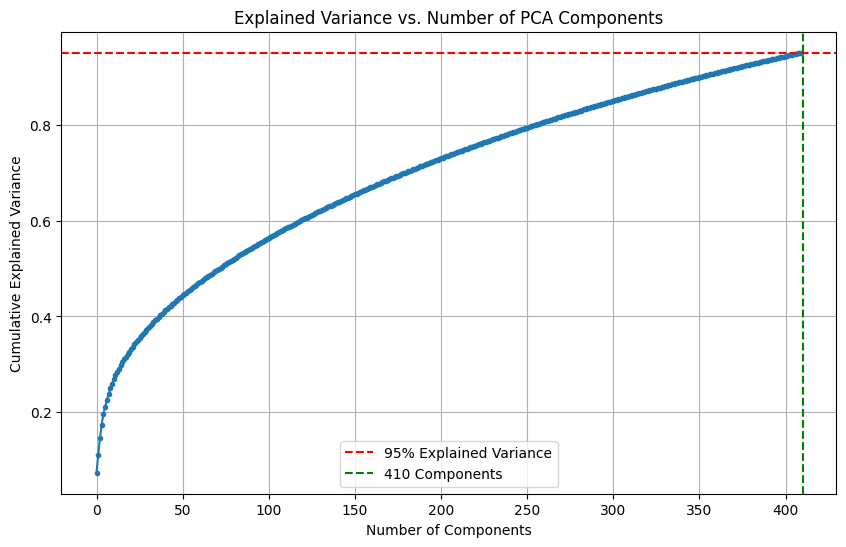

CNN dataset shapes: Train (480, 224, 224, 3), Val (161, 224, 224, 3), Test (161, 224, 224, 3)
Visualizing feature space with t-SNE (including CNN features)...
Applying t-SNE (this may take a while)...


/usr/local/lib/python3.11/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


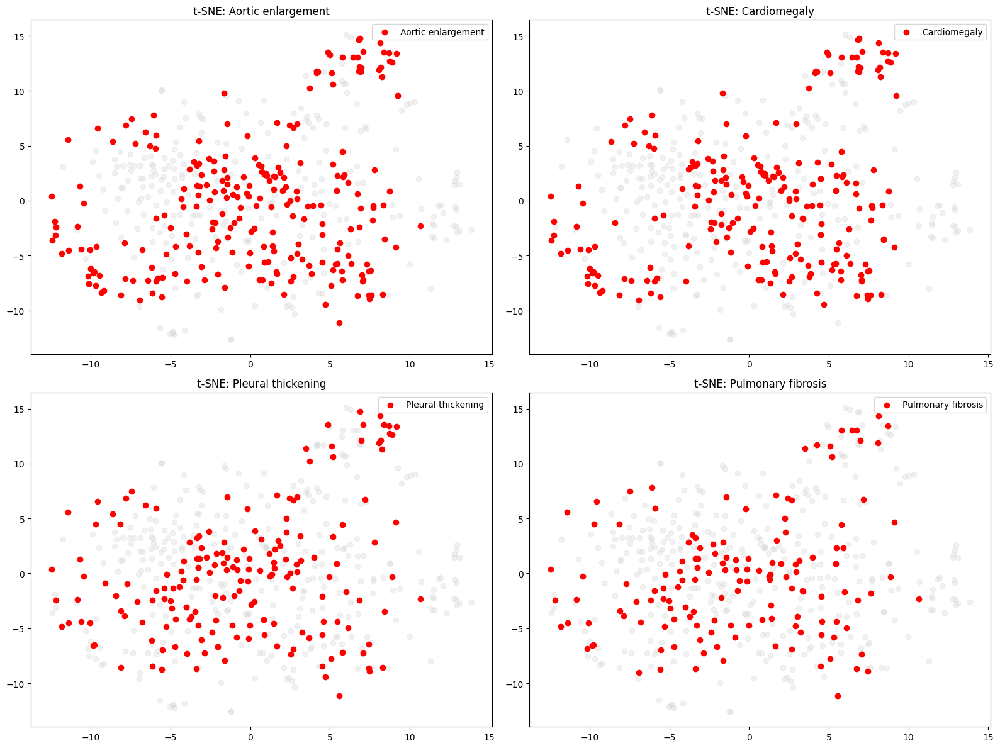

In [ ]:

# Split dataset into train/val/test for classification
(X_train_scaled, X_val_scaled, X_test_scaled,
 y_train, y_val, y_test,
 scaler,
 train_components, val_components, test_components,
 X_train_raw, X_val_raw, X_test_raw) = prepare_data(
    X, y, selected_classes, all_feature_components, test_size=0.2, val_size=0.25
)


# Apply PCA for dimensionality reduction
X_train_pca, X_val_pca, X_test_pca, pca = apply_pca(X_train_scaled, X_val_scaled, X_test_scaled)

# Split images for CNN using the same indices from the feature preparation
train_end = len(X_train_scaled)
val_end = train_end + len(X_val_scaled)

X_img_train = X_img[:train_end]
X_img_val = X_img[train_end:val_end]
X_img_test = X_img[val_end:]

print(f"CNN dataset shapes: Train {X_img_train.shape}, Val {X_img_val.shape}, Test {X_img_test.shape}")

# Visualize features with t-SNE
print("Visualizing feature space with t-SNE (including CNN features)...")
selected_class_names = {i: CLASS_NAMES[class_id] for i, class_id in enumerate(selected_classes)}
visualize_tsne(X_train_pca, y_train, selected_class_names=selected_class_names)

## 3.3 Model Training and Evaluation

### 3.3.1 Logistic Regression
Train and evaluate the logistic regression model using engineered features.

Training Logistic Regression models...

Training model for Aortic enlargement
  Best C: 0.01
  Validation Accuracy: 0.907, AUC: 0.966, F1: 0.908

Training model for Cardiomegaly
  Best C: 0.1
  Validation Accuracy: 0.870, AUC: 0.916, F1: 0.851

Training model for Pleural thickening
  Best C: 10
  Validation Accuracy: 0.789, AUC: 0.878, F1: 0.721

Training model for Pulmonary fibrosis
  Best C: 10
  Validation Accuracy: 0.795, AUC: 0.862, F1: 0.703

Training model for No finding
  Best C: 1
  Validation Accuracy: 0.907, AUC: 0.968, F1: 0.895

Average Performance: Accuracy 0.853, AUC 0.918, F1 0.816
Training Time: 3.65 seconds
Inference Time: 0.00 seconds

Visualizing Logistic Regression performance...


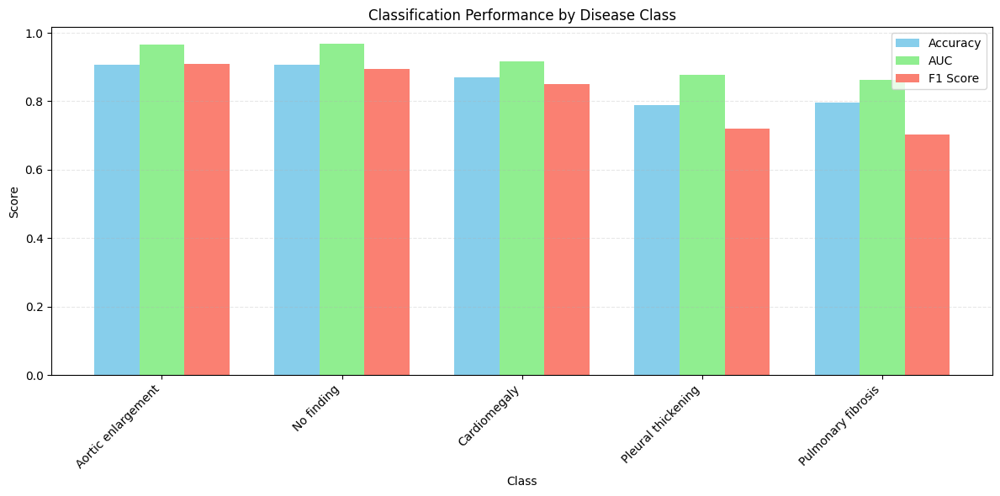

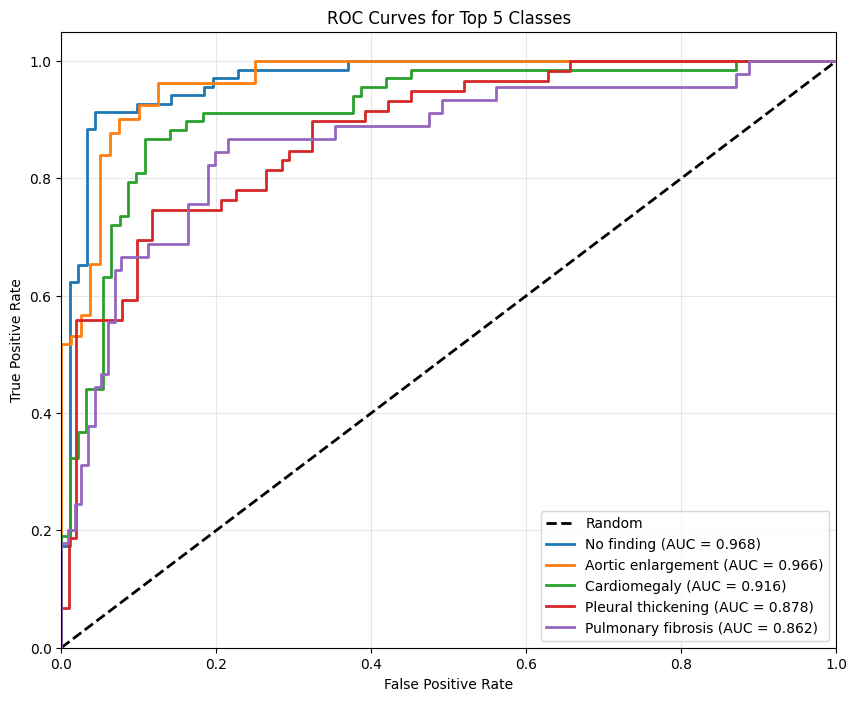


Evaluating Logistic Regression on test set...
Evaluating on test set...
Inference time: 0.00 seconds
  Aortic enlargement: Accuracy=0.894, AUC=0.937, F1=0.887
  Cardiomegaly: Accuracy=0.913, AUC=0.940, F1=0.897
  Pleural thickening: Accuracy=0.776, AUC=0.832, F1=0.660
  Pulmonary fibrosis: Accuracy=0.801, AUC=0.870, F1=0.660
  No finding: Accuracy=0.938, AUC=0.941, F1=0.932
Average Test Performance: Accuracy=0.865, AUC=0.904, F1=0.807

Showing multi-label co-occurrence matrix:


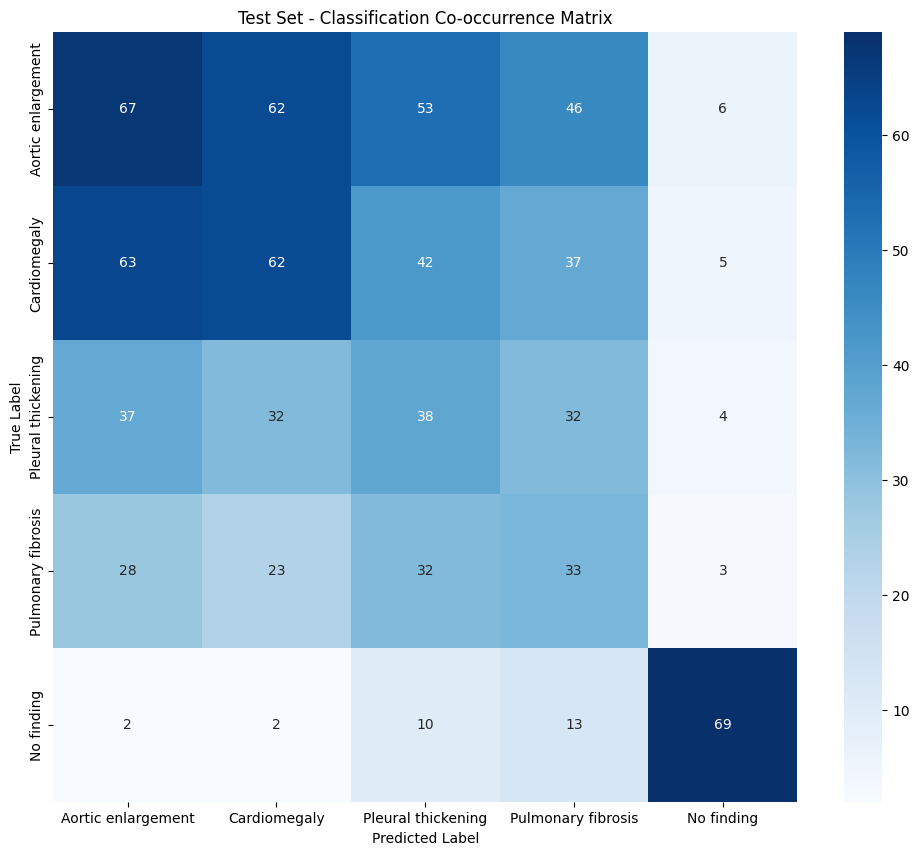


Showing per-class confusion matrices:


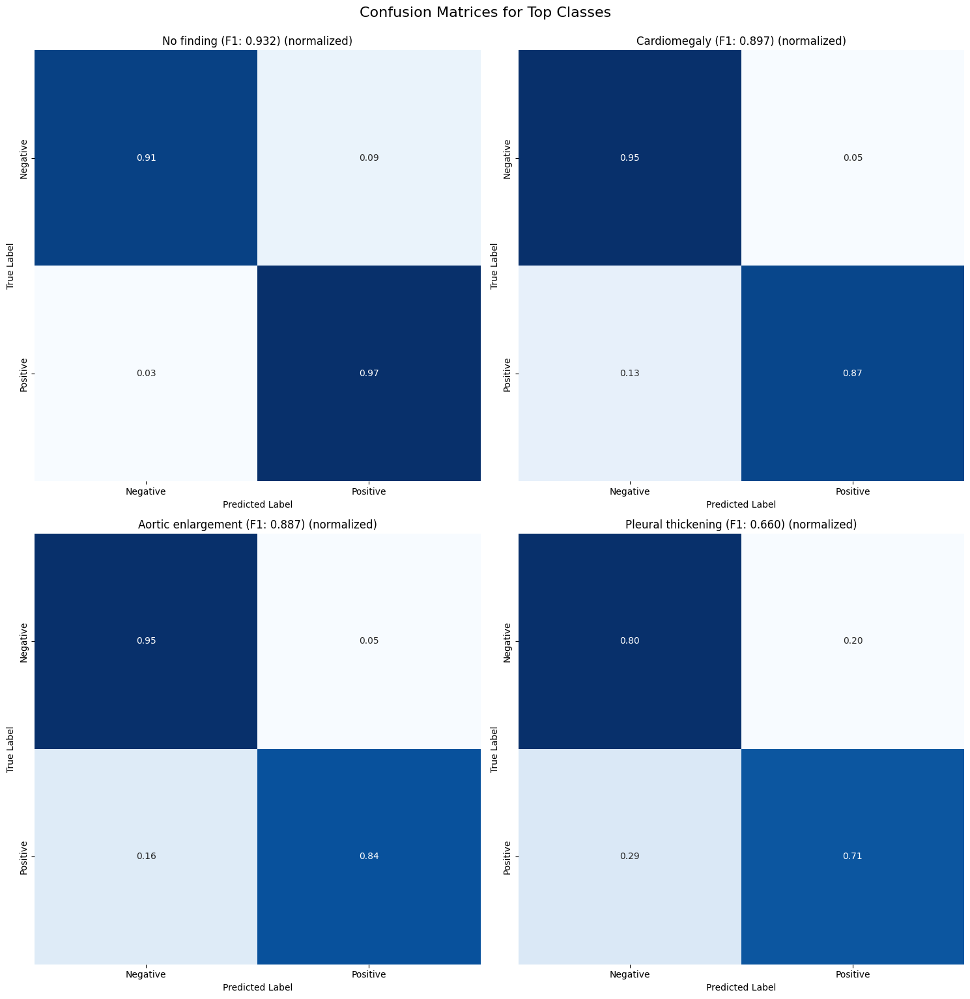


Showing combined confusion matrix:


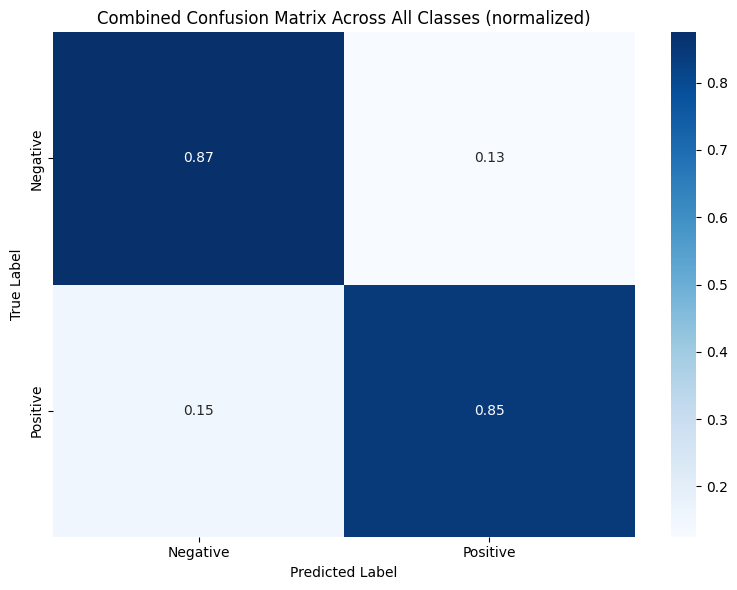

Overall Confusion Matrix Statistics:
True Positives: 263
True Negatives: 433
False Positives: 62
False Negatives: 47
Sensitivity/Recall: 0.848
Specificity: 0.875
Precision: 0.809
Negative Predictive Value: 0.902

Analyzing feature importance for logistic regression models...


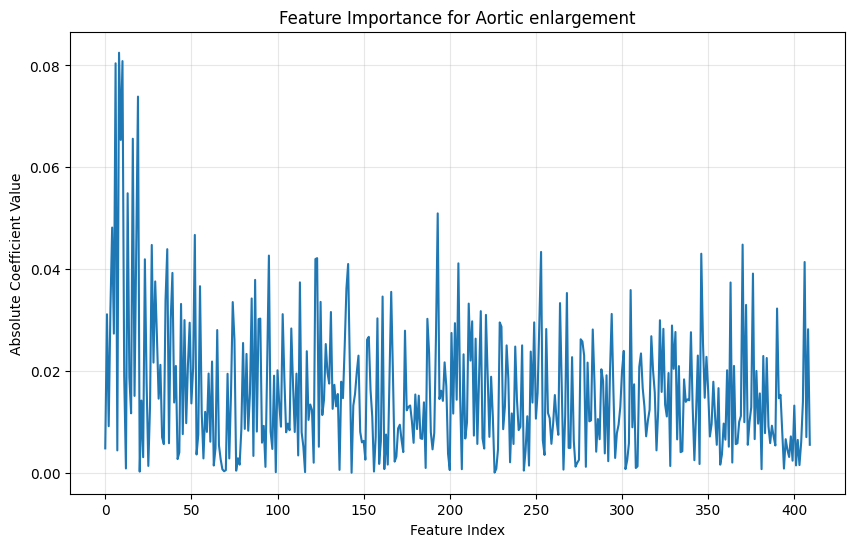


Top 10 features for Aortic enlargement:
- Rank 1: Feature 8, Importance: 0.082494
- Rank 2: Feature 10, Importance: 0.080848
- Rank 3: Feature 6, Importance: 0.080412
- Rank 4: Feature 19, Importance: 0.073878
- Rank 5: Feature 16, Importance: 0.065607
- Rank 6: Feature 9, Importance: 0.065373
- Rank 7: Feature 13, Importance: 0.054902
- Rank 8: Feature 193, Importance: 0.050949
- Rank 9: Feature 4, Importance: 0.048167
- Rank 10: Feature 52, Importance: 0.046721


In [ ]:
# Train logistic regression model
print("Training Logistic Regression models...")
logreg_results = train_logistic_multilabel(X_train_pca, y_train, X_val_pca, y_val, selected_class_names)

# Visualize model performance
print("\nVisualizing Logistic Regression performance...")
visualize_model_performance(logreg_results, selected_class_names, top_n=len(selected_classes))

# Evaluate on test set
print("\nEvaluating Logistic Regression on test set...")
logreg_test_results, logreg_avg_test_metrics = evaluate_on_test_set(
    logreg_results, X_test_pca, y_test, selected_class_names
)

# Generate predictions for visualization
logreg_preds = np.zeros_like(y_test)
for i, model in enumerate(logreg_results['models']):
    if model is not None:
        logreg_preds[:, i] = (model.predict_proba(X_test_pca)[:, 1] >= 0.5).astype(int)

# Generate confusion and co-occurrence matrices
integrate_matrix_visualization(logreg_test_results, y_test, logreg_preds, selected_class_names)

# Add feature importance analysis specifically focused on CNN features
if CONFIG['feature_extraction']['cnn_features']:
    print("\nAnalyzing feature importance for logistic regression models...")
    # Get a valid model with coefficients
    for i, model in enumerate(logreg_results['models']):
        if model is not None and hasattr(model, 'coef_') and model.coef_.size > 0:
            # Get model coefficients
            coef = np.abs(model.coef_[0])

            # Plot feature importance
            plt.figure(figsize=(10, 6))
            plt.plot(coef)
            plt.title(f'Feature Importance for {selected_class_names[i]}')
            plt.xlabel('Feature Index')
            plt.ylabel('Absolute Coefficient Value')
            plt.grid(True, alpha=0.3)
            plt.show()

            # Find top features
            top_indices = np.argsort(coef)[-10:][::-1]
            print(f"\nTop 10 features for {selected_class_names[i]}:")
            for rank, idx in enumerate(top_indices):
                print(f"- Rank {rank+1}: Feature {idx}, Importance: {coef[idx]:.6f}")

            # Only process one model for brevity
            break

## 3.3.2 SVM Model


==== Training SVM models ====

Training SVM for Aortic enlargement
  Best C: 10, gamma: scale
  Validation Accuracy: 0.876, AUC: 0.954, F1: 0.889

Training SVM for Cardiomegaly
  Best C: 10, gamma: scale
  Validation Accuracy: 0.801, AUC: 0.909, F1: 0.797

Training SVM for Pleural thickening
  Best C: 1, gamma: scale
  Validation Accuracy: 0.814, AUC: 0.888, F1: 0.779

Training SVM for Pulmonary fibrosis
  Best C: 1, gamma: scale
  Validation Accuracy: 0.720, AUC: 0.854, F1: 0.640

Training SVM for No finding
  Best C: 1, gamma: scale
  Validation Accuracy: 0.857, AUC: 0.952, F1: 0.810

Average Performance: Accuracy 0.814, AUC 0.911, F1 0.783
Training Time: 6.03 seconds
Inference Time: 0.16 seconds

Visualizing SVM performance...


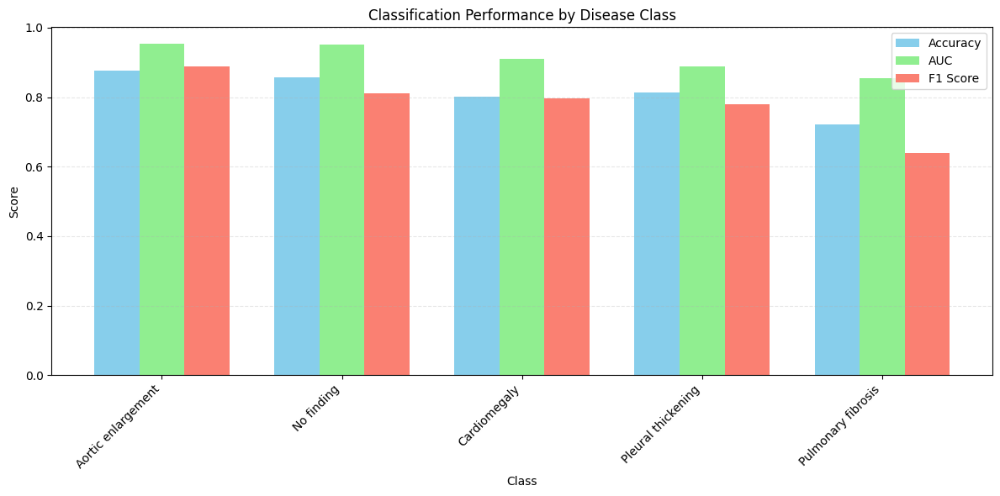

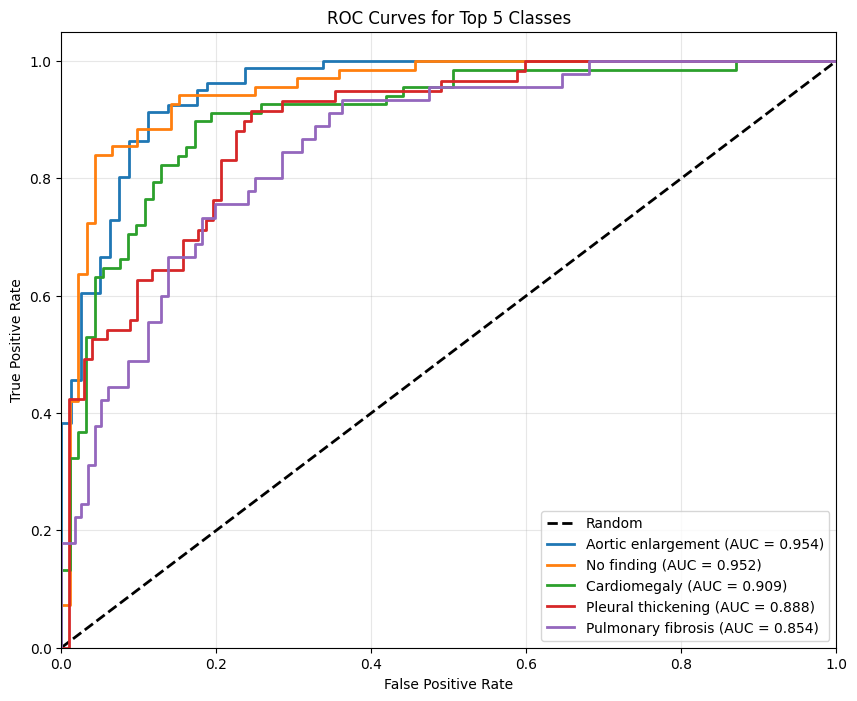


Evaluating SVM on test set...
Evaluating on test set...
Inference time: 0.16 seconds
  Aortic enlargement: Accuracy=0.870, AUC=0.939, F1=0.876
  Cardiomegaly: Accuracy=0.876, AUC=0.960, F1=0.870
  Pleural thickening: Accuracy=0.745, AUC=0.818, F1=0.661
  Pulmonary fibrosis: Accuracy=0.745, AUC=0.870, F1=0.610
  No finding: Accuracy=0.857, AUC=0.860, F1=0.813
Average Test Performance: Accuracy=0.819, AUC=0.890, F1=0.766

Showing multi-label co-occurrence matrix:


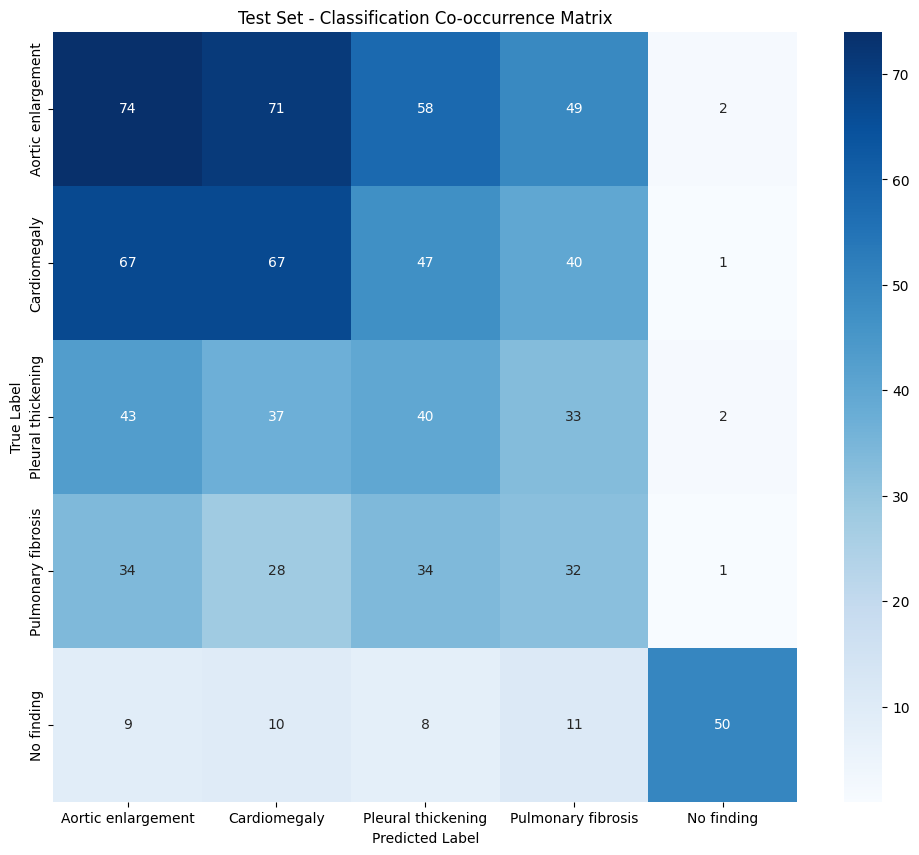


Showing per-class confusion matrices:


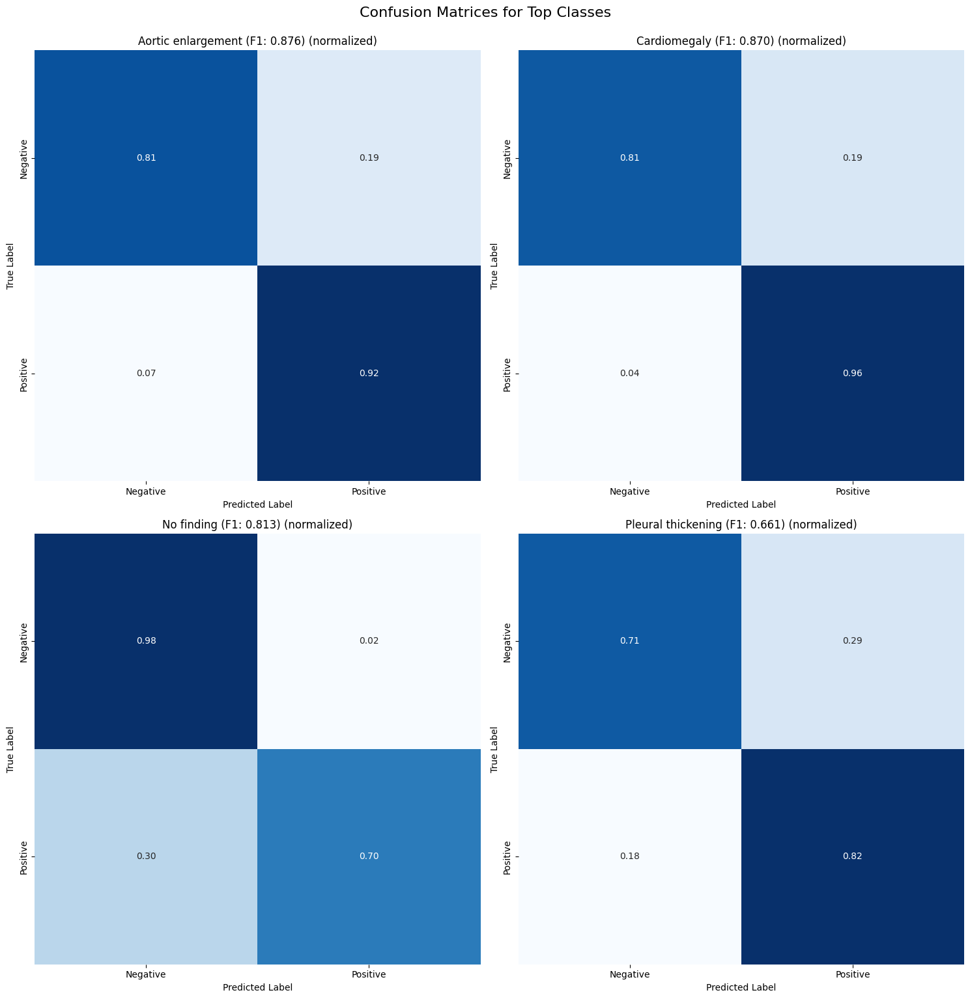


Showing combined confusion matrix:


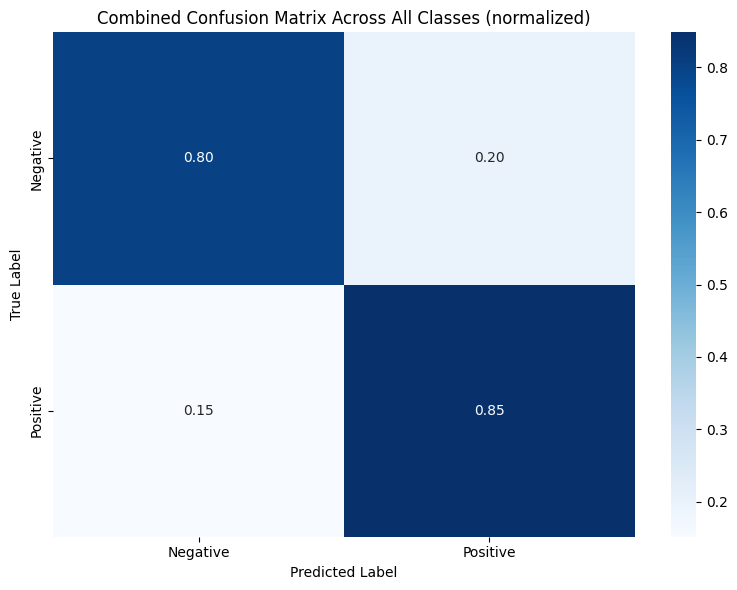

Overall Confusion Matrix Statistics:
True Positives: 263
True Negatives: 396
False Positives: 99
False Negatives: 47
Sensitivity/Recall: 0.848
Specificity: 0.800
Precision: 0.727
Negative Predictive Value: 0.894


In [ ]:
# Train SVM model
print("\n==== Training SVM models ====")
svm_results = train_svm_multilabel(X_train_pca, y_train, X_val_pca, y_val, selected_class_names)

# Visualize SVM performance
print("\nVisualizing SVM performance...")
visualize_model_performance(svm_results, selected_class_names, top_n=len(selected_classes))

# Evaluate SVM on test set
print("\nEvaluating SVM on test set...")
svm_test_results, svm_avg_test_metrics = evaluate_on_test_set(
    svm_results, X_test_pca, y_test, selected_class_names
)

# Generate predictions for visualization
svm_preds = np.zeros_like(y_test)
for i, model in enumerate(svm_results['models']):
    if model is not None:
        svm_preds[:, i] = (model.predict_proba(X_test_pca)[:, 1] >= 0.5).astype(int)

# Generate confusion and co-occurrence matrices
integrate_matrix_visualization(svm_test_results, y_test, svm_preds, selected_class_names)

### 3.3.3 Comparison of Logistic Regression and SVM classifier performance including/excluding DenseNet121 CNN feature extraction


In [ ]:
# Create feature matrices without CNN features
X_train_no_cnn = []
X_val_no_cnn = []
X_test_no_cnn = []

# Define which feature types to include (all except CNN)
features_to_keep = ['hog', 'fourier', 'edge', 'pyramid', 'lbp', 'spatial']

# Process training set
for i in range(len(y_train)):
    sample_features = []
    for feature_type in features_to_keep:
        if feature_type in train_components and i < len(train_components[feature_type]):
            feature = train_components[feature_type][i]
            if len(feature) > 1:  # Skip placeholders
                sample_features.append(feature)

    if sample_features:
        X_train_no_cnn.append(np.concatenate(sample_features))

# Process validation set
for i in range(len(y_val)):
    sample_features = []
    for feature_type in features_to_keep:
        if feature_type in val_components and i < len(val_components[feature_type]):
            feature = val_components[feature_type][i]
            if len(feature) > 1:  # Skip placeholders
                sample_features.append(feature)

    if sample_features:
        X_val_no_cnn.append(np.concatenate(sample_features))

# Process test set
for i in range(len(y_test)):
    sample_features = []
    for feature_type in features_to_keep:
        if feature_type in test_components and i < len(test_components[feature_type]):
            feature = test_components[feature_type][i]
            if len(feature) > 1:  # Skip placeholders
                sample_features.append(feature)

    if sample_features:
        X_test_no_cnn.append(np.concatenate(sample_features))

# Convert to numpy arrays
X_train_no_cnn = np.array(X_train_no_cnn)
X_val_no_cnn = np.array(X_val_no_cnn)
X_test_no_cnn = np.array(X_test_no_cnn)

# Print shapes for verification
print(f"Train set without CNN: {X_train_no_cnn.shape}")
print(f"Val set without CNN: {X_val_no_cnn.shape}")
print(f"Test set without CNN: {X_test_no_cnn.shape}")

Train set without CNN: (480, 46479)
Val set without CNN: (161, 46479)
Test set without CNN: (161, 46479)


Using 410 components to retain optimal variance
PCA with 410 components explains 95.08% of variance


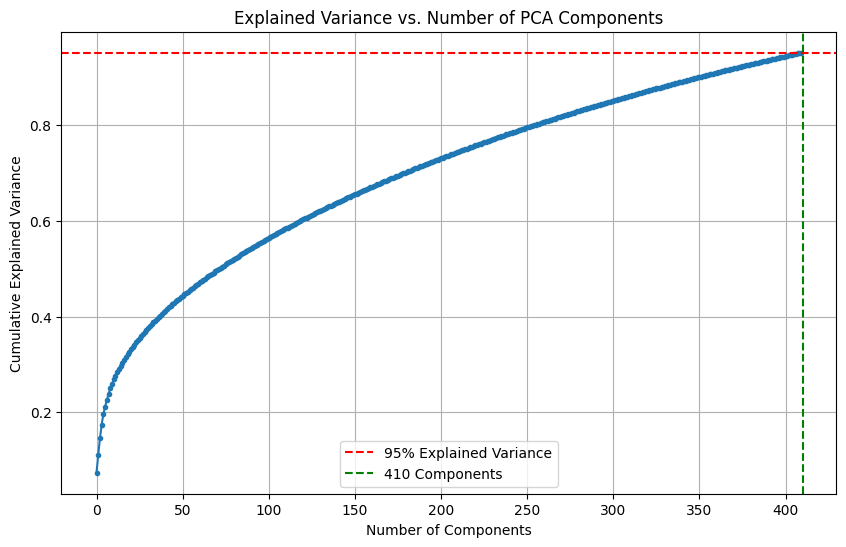


Training Logistic Regression WITHOUT CNN features...

Training model for Aortic enlargement
  Best C: 0.1
  Validation Accuracy: 0.894, AUC: 0.960, F1: 0.896

Training model for Cardiomegaly
  Best C: 0.1
  Validation Accuracy: 0.863, AUC: 0.915, F1: 0.845

Training model for Pleural thickening
  Best C: 100
  Validation Accuracy: 0.764, AUC: 0.855, F1: 0.698

Training model for Pulmonary fibrosis
  Best C: 10
  Validation Accuracy: 0.776, AUC: 0.846, F1: 0.679

Training model for No finding
  Best C: 10
  Validation Accuracy: 0.901, AUC: 0.967, F1: 0.889

Average Performance: Accuracy 0.840, AUC 0.909, F1 0.801
Training Time: 1.08 seconds
Inference Time: 0.00 seconds

Training SVM WITHOUT CNN features...

Training SVM for Aortic enlargement
  Best C: 1, gamma: scale
  Validation Accuracy: 0.845, AUC: 0.944, F1: 0.865

Training SVM for Cardiomegaly
  Best C: 10, gamma: scale
  Validation Accuracy: 0.783, AUC: 0.908, F1: 0.783

Training SVM for Pleural thickening
  Best C: 1, gamma: sc

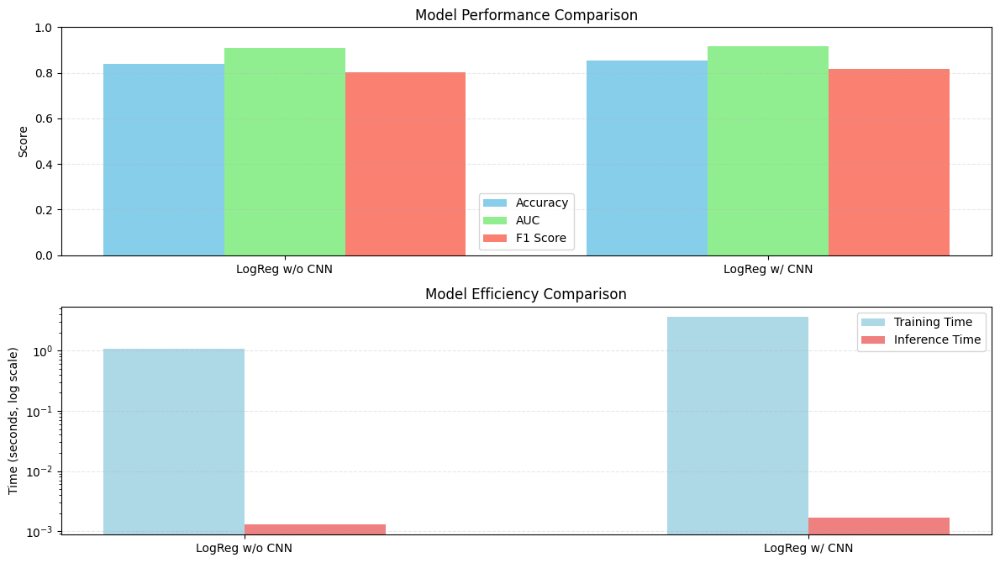


Efficiency vs. Accuracy Analysis:

LogReg w/o CNN:
  - Accuracy: 0.840, AUC: 0.909, F1: 0.801
  - Training Time: 1.08 seconds
  - Inference Time: 0.00 seconds

LogReg w/ CNN:
  - Accuracy: 0.853, AUC: 0.918, F1: 0.816
  - Training Time: 3.65 seconds
  - Inference Time: 0.00 seconds

Key Trade-offs:
- LogReg w/ CNN is 1.4% more accurate but 3.4x slower to train than LogReg w/o CNN
- LogReg w/ CNN is 1.4% more accurate but 1.3x slower for inference than LogReg w/o CNN

=== Comparing SVM With vs. Without CNN Features ===

Model Comparison:
      Model  Accuracy      AUC  F1 Score  Training Time (s)  Inference Time (s)
SVM w/o CNN  0.798758 0.905347  0.769219           5.870221            0.155565
 SVM w/ CNN  0.813665 0.911186  0.783137           6.025491            0.159286


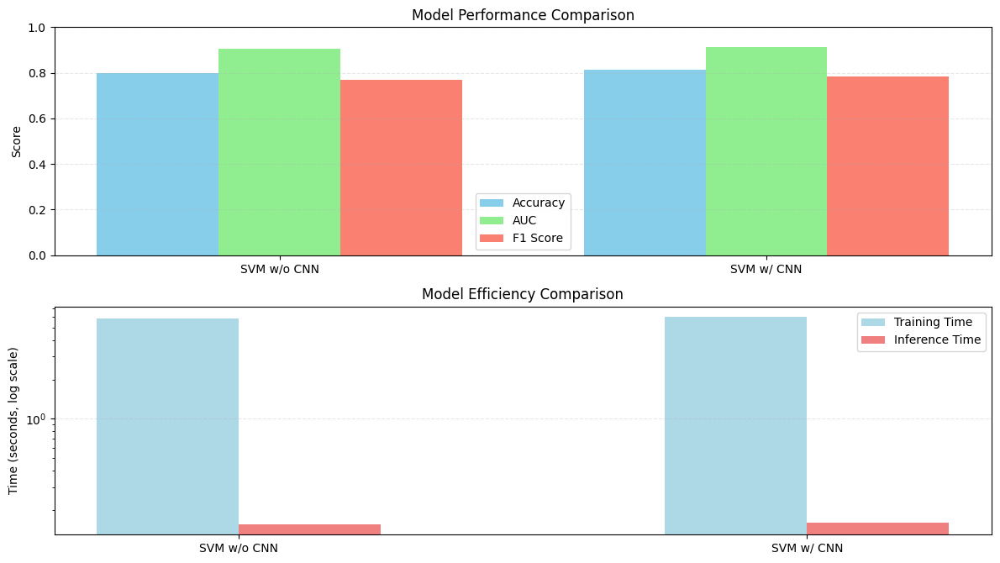


Efficiency vs. Accuracy Analysis:

SVM w/o CNN:
  - Accuracy: 0.799, AUC: 0.905, F1: 0.769
  - Training Time: 5.87 seconds
  - Inference Time: 0.16 seconds

SVM w/ CNN:
  - Accuracy: 0.814, AUC: 0.911, F1: 0.783
  - Training Time: 6.03 seconds
  - Inference Time: 0.16 seconds

Key Trade-offs:
- SVM w/ CNN is 1.5% more accurate but 1.0x slower to train than SVM w/o CNN
- SVM w/ CNN is 1.5% more accurate but 1.0x slower for inference than SVM w/o CNN

=== Per-class Comparison for Logistic Regression ===

Per-Class Performance Comparison:
             Class  LogReg w/o CNN F1  LogReg w/ CNN F1    Best Model
Aortic enlargement           0.895706          0.907975 LogReg w/ CNN
        No finding           0.888889          0.895105 LogReg w/ CNN
      Cardiomegaly           0.845070          0.851064 LogReg w/ CNN
Pleural thickening           0.698413          0.721311 LogReg w/ CNN
Pulmonary fibrosis           0.678571          0.702703 LogReg w/ CNN


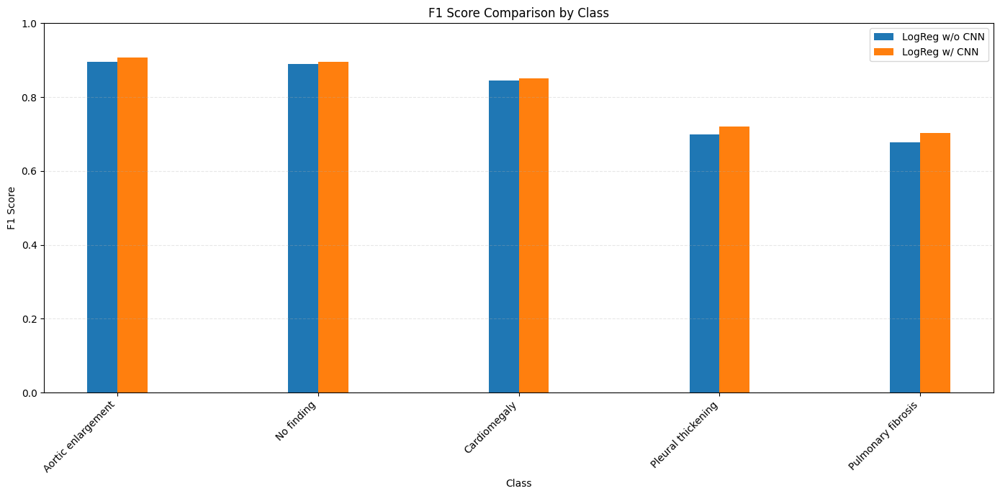


Best Model by Class Count:
  - LogReg w/ CNN: Best for 5 classes

=== Per-class Comparison for SVM ===

Per-Class Performance Comparison:
             Class  SVM w/o CNN F1  SVM w/ CNN F1  Best Model
Aortic enlargement        0.864865       0.888889  SVM w/ CNN
        No finding        0.809917       0.809917 SVM w/o CNN
      Cardiomegaly        0.782609       0.797468  SVM w/ CNN
Pleural thickening        0.764706       0.779412  SVM w/ CNN
Pulmonary fibrosis        0.624000       0.640000  SVM w/ CNN


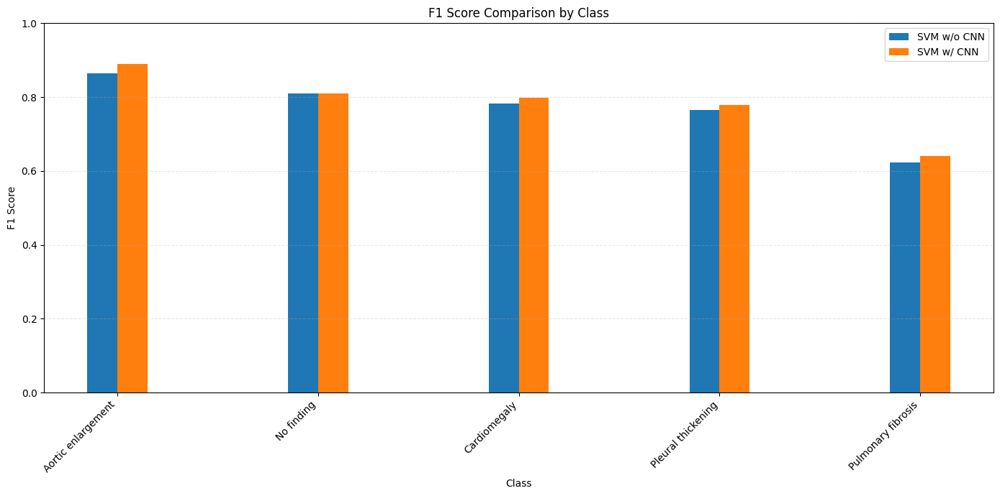


Best Model by Class Count:
  - SVM w/ CNN: Best for 4 classes
  - SVM w/o CNN: Best for 1 classes


In [ ]:
# Scale the features without CNN
scaler_no_cnn = StandardScaler()
X_train_no_cnn_scaled = scaler_no_cnn.fit_transform(X_train_no_cnn)
X_val_no_cnn_scaled = scaler_no_cnn.transform(X_val_no_cnn)
X_test_no_cnn_scaled = scaler_no_cnn.transform(X_test_no_cnn)

# Apply PCA to features without CNN
X_train_no_cnn_pca, X_val_no_cnn_pca, X_test_no_cnn_pca, pca_no_cnn = apply_pca(
    X_train_no_cnn_scaled, X_val_no_cnn_scaled, X_test_no_cnn_scaled
)

# Train logistic regression model without CNN features
print("\nTraining Logistic Regression WITHOUT CNN features...")
logreg_no_cnn_results = train_logistic_multilabel(
    X_train_no_cnn_pca, y_train, X_val_no_cnn_pca, y_val, selected_class_names
)

# Train SVM model without CNN features
print("\nTraining SVM WITHOUT CNN features...")
svm_no_cnn_results = train_svm_multilabel(
    X_train_no_cnn_pca, y_train, X_val_no_cnn_pca, y_val, selected_class_names
)

# Compare LogReg models with and without CNN features
print("\n=== Comparing Logistic Regression With vs. Without CNN Features ===")
compare_models(
    logreg_no_cnn_results,  # Without CNN
    logreg_results,         # With CNN (original)
    model_names=["LogReg w/o CNN", "LogReg w/ CNN"],  # Use descriptive names
    selected_class_names=selected_class_names
)

# Compare SVM models with and without CNN features
print("\n=== Comparing SVM With vs. Without CNN Features ===")
compare_models(
    svm_no_cnn_results,     # Without CNN
    svm_results,            # With CNN (original)
    model_names=["SVM w/o CNN", "SVM w/ CNN"],  # Use descriptive names
    selected_class_names=selected_class_names
)

# Compare per-class performance
print("\n=== Per-class Comparison for Logistic Regression ===")
compare_class_performance(
    logreg_no_cnn_results,  # Without CNN
    logreg_results,         # With CNN
    model_names=["LogReg w/o CNN", "LogReg w/ CNN"],  # Add this parameter
    selected_class_names=selected_class_names
)

print("\n=== Per-class Comparison for SVM ===")
compare_class_performance(
    svm_no_cnn_results,     # Without CNN
    svm_results,            # With CNN
    model_names=["SVM w/o CNN", "SVM w/ CNN"],  # Add this
    selected_class_names=selected_class_names
)

### 3.3.4 CNN Model
Train and evaluate the CNN model using preprocessed images.

Trial 21 Complete [00h 01m 58s]
val_auc: 0.5076974034309387

Best val_auc So Far: 0.5886609554290771
Total elapsed time: 00h 38m 38s

Best hyperparameters found:
- Learning rate: 0.0005
- Dropout rate: 0.3
- Fine-tune layers: 20
- Dense units: 256

Training final CNN model with best hyperparameters...


/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 58s 1s/step - accuracy: 0.2532 - auc_2: 0.5183 - loss: 0.9078 - val_accuracy: 0.0435 - val_auc_2: 0.4417 - val_loss: 0.7830 - learning_rate: 5.0000e-04
Epoch 2/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 32s 1s/step - accuracy: 0.2432 - auc_2: 0.5205 - loss: 0.8669 - val_accuracy: 0.1553 - val_auc_2: 0.4725 - val_loss: 0.7516 - learning_rate: 5.0000e-04
Epoch 3/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 32s 1s/step - accuracy: 0.2529 - auc_2: 0.5333 - loss: 0.8311 - val_accuracy: 0.1801 - val_auc_2: 0.4797 - val_loss: 0.7399 - learning_rate: 5.0000e-04
Epoch 4/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 32s 1s/step - accuracy: 0.2951 - auc_2: 0.5221 - loss: 0.8161 - val_accuracy: 0.2919 - val_auc_2: 0.5048 - val_loss: 0.7351 - learning_rate: 5.0000e-04
Epoch 5/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 32s 1s/step - accuracy: 0.3341 - auc_2: 0.6056 - loss: 0.7298 - val_accuracy: 0.4286 - val_auc_2: 0.5349 - val_loss: 0.7472 - learning_rate: 5.0000e-04
Epoch 6/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 32s 1s/step 

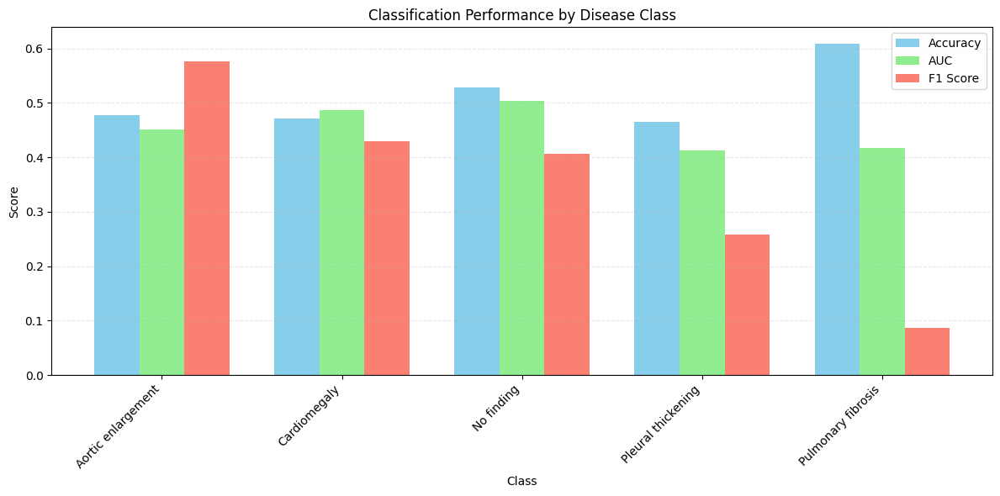

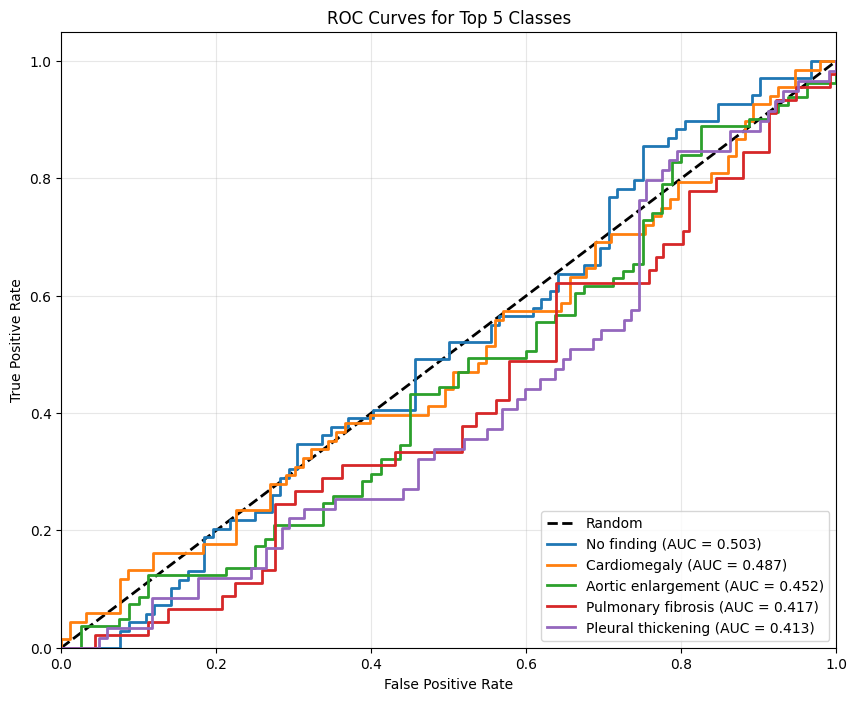


Evaluating CNN on test set...
Evaluating on test set...
6/6 ━━━━━━━━━━━━━━━━━━━━ 8s 1s/step
Inference time: 8.72 seconds
  Aortic enlargement: Accuracy=0.503, AUC=0.474, F1=0.494
  Cardiomegaly: Accuracy=0.528, AUC=0.462, F1=0.406
  Pleural thickening: Accuracy=0.522, AUC=0.374, F1=0.135
  Pulmonary fibrosis: Accuracy=0.702, AUC=0.494, F1=0.143
  No finding: Accuracy=0.460, AUC=0.445, F1=0.365
Average Test Performance: Accuracy=0.543, AUC=0.450, F1=0.309
6/6 ━━━━━━━━━━━━━━━━━━━━ 8s 1s/step

Showing multi-label co-occurrence matrix:


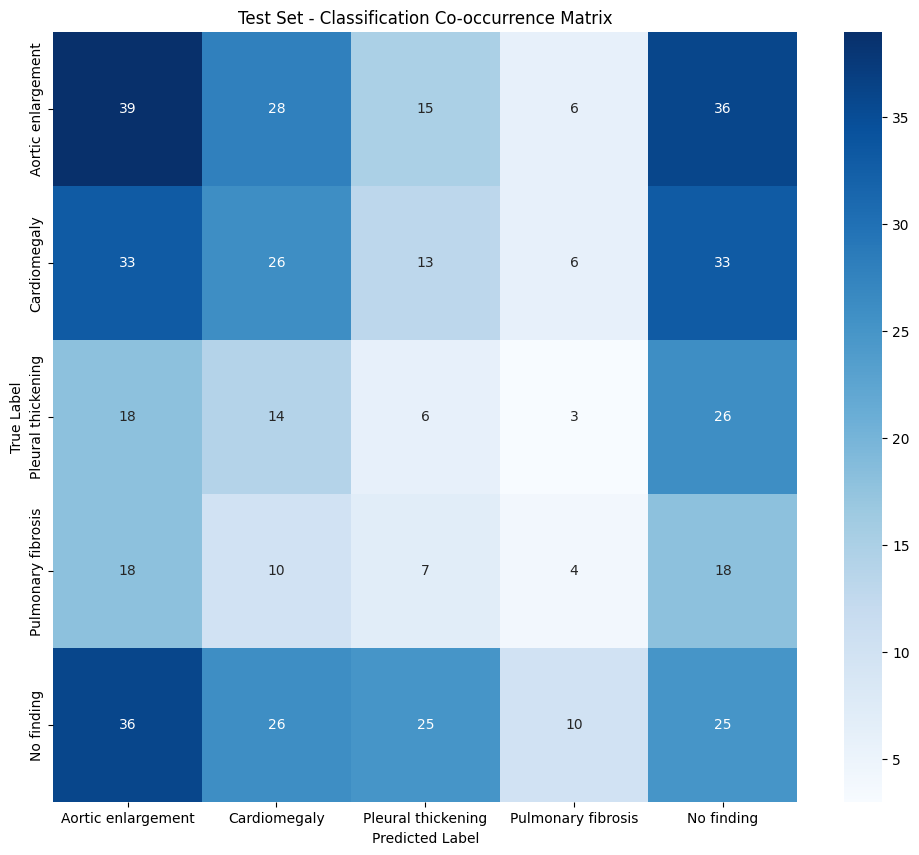


Showing per-class confusion matrices:


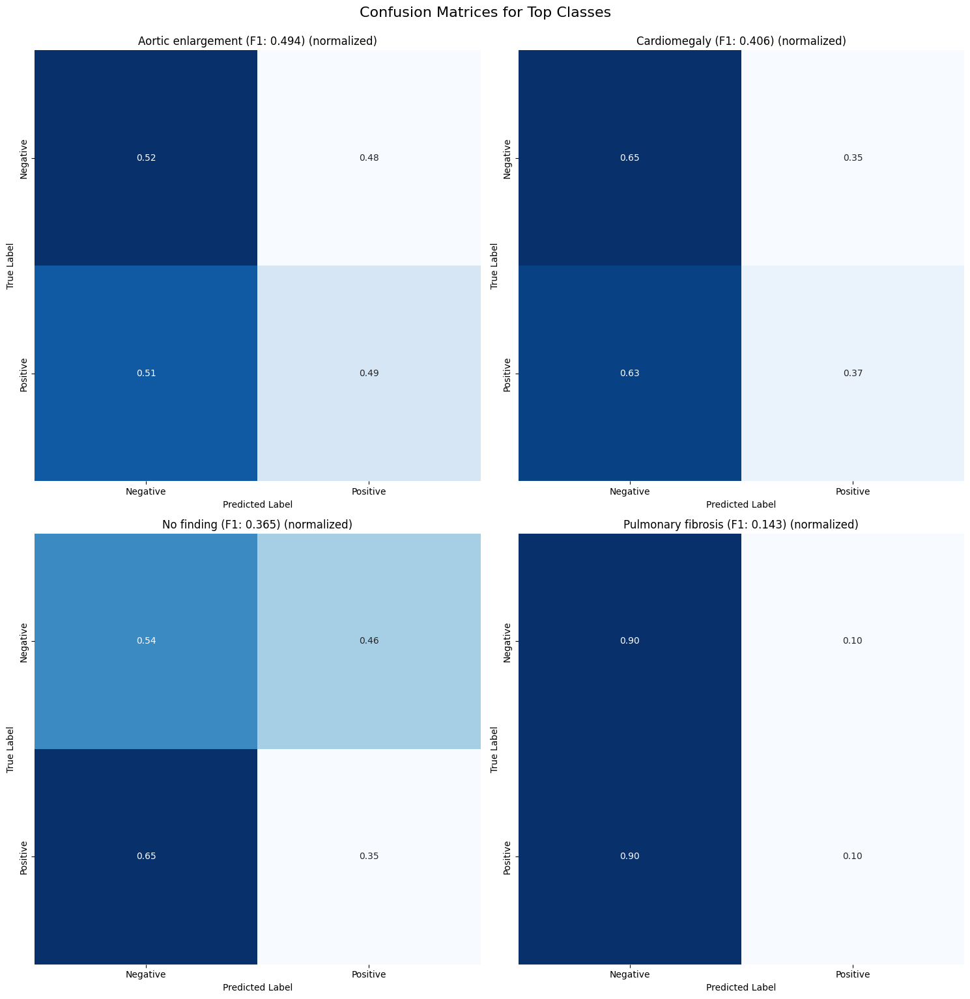


Showing combined confusion matrix:


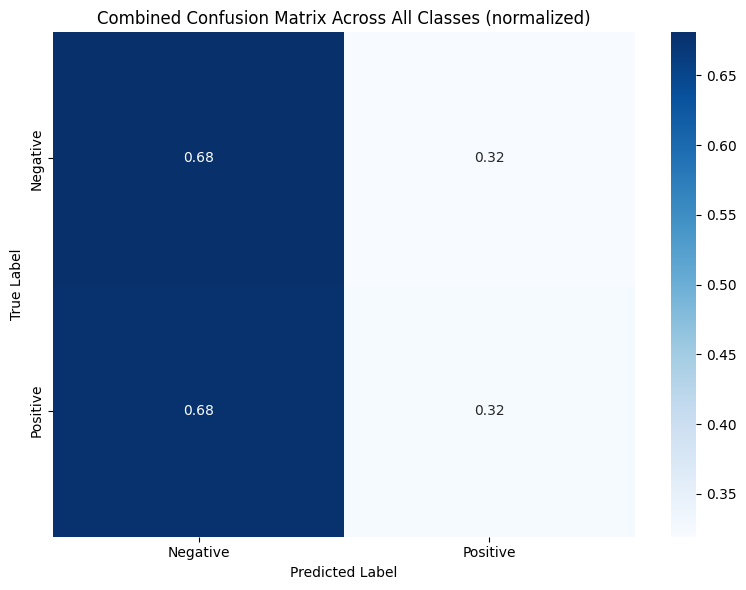

Overall Confusion Matrix Statistics:
True Positives: 100
True Negatives: 337
False Positives: 158
False Negatives: 210
Sensitivity/Recall: 0.323
Specificity: 0.681
Precision: 0.388
Negative Predictive Value: 0.616


In [ ]:

# Checking shapes
print(f"Shape of X_img_train: {X_img_train.shape}")
print(f"Shape of y_train: {y_train.shape}")
print(f"Label distribution in training set: {np.sum(y_train, axis=0)}")
print(f"Label distribution in validation set: {np.sum(y_val, axis=0)}")

# Train CNN model
print("\nTraining CNN model...")
cnn_results = train_cnn_model(X_img_train, y_train, X_img_val, y_val, selected_classes)


# Check if training was successful before continuing
if cnn_results is None:
    print("CNN model training failed. Skipping visualization and evaluation steps.")
else:
    # Continue with visualization and evaluation
    print("\nVisualizing CNN model performance...")
    visualize_model_performance(cnn_results, selected_class_names, top_n=len(selected_classes))

    # Evaluate CNN on test set
    print("\nEvaluating CNN on test set...")

    cnn_test_results, cnn_avg_test_metrics = evaluate_on_test_set(
        cnn_results,  # Just pass the results object, which contains the model
        X_img_test,
        y_test,
        selected_class_names
    )

    # Generate predictions for visualization
    cnn_preds = cnn_results['model'].predict(X_img_test)
    cnn_preds_binary = (cnn_preds >= 0.5).astype(int)

    # Apply mutual exclusivity if needed
    if 14 in selected_classes:
        no_finding_index = selected_classes.index(14)
        cnn_preds_binary = enforce_prediction_exclusivity(cnn_preds_binary, no_finding_index)

    # Generate confusion and co-occurrence matrices
    integrate_matrix_visualization(cnn_test_results, y_test, cnn_preds_binary, selected_class_names)

## 3.4 Classifier Comparison
Compare the performance, efficiency, and generalizability of all models.


===== Comprehensive Model Comparison =====

Model Comparison:
            Model  Accuracy      AUC  F1 Score  Training Time (s)  Inference Time (s)
   LogReg w/o CNN  0.839752 0.908774  0.801330           1.076200            0.001302
    LogReg w/ CNN  0.853416 0.917969  0.815632           3.645500            0.001660
      SVM w/o CNN  0.798758 0.905347  0.769219           5.870221            0.155565
       SVM w/ CNN  0.813665 0.911186  0.783137           6.025491            0.159286
CNN (DenseNet121)  0.510559 0.454479  0.351423         315.605000            5.089661


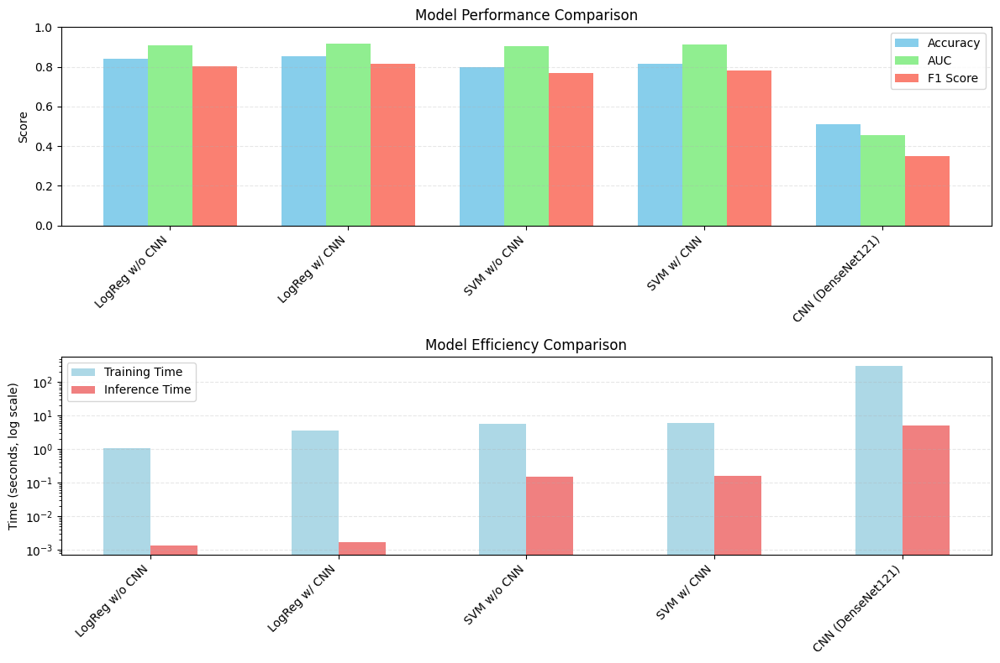


Efficiency vs. Accuracy Analysis:

LogReg w/o CNN:
  - Accuracy: 0.840, AUC: 0.909, F1: 0.801
  - Training Time: 1.08 seconds
  - Inference Time: 0.00 seconds

LogReg w/ CNN:
  - Accuracy: 0.853, AUC: 0.918, F1: 0.816
  - Training Time: 3.65 seconds
  - Inference Time: 0.00 seconds

SVM w/o CNN:
  - Accuracy: 0.799, AUC: 0.905, F1: 0.769
  - Training Time: 5.87 seconds
  - Inference Time: 0.16 seconds

SVM w/ CNN:
  - Accuracy: 0.814, AUC: 0.911, F1: 0.783
  - Training Time: 6.03 seconds
  - Inference Time: 0.16 seconds

CNN (DenseNet121):
  - Accuracy: 0.511, AUC: 0.454, F1: 0.351
  - Training Time: 315.61 seconds
  - Inference Time: 5.09 seconds

Key Trade-offs:
- LogReg w/ CNN is 1.4% more accurate but 3.4x slower to train than LogReg w/o CNN
- LogReg w/ CNN is 1.4% more accurate but 1.3x slower for inference than LogReg w/o CNN

Per-Class Performance Comparison:
             Class  LogReg w/o CNN F1  LogReg w/ CNN F1  SVM w/o CNN F1  SVM w/ CNN F1  CNN (DenseNet121) F1    Best Mod

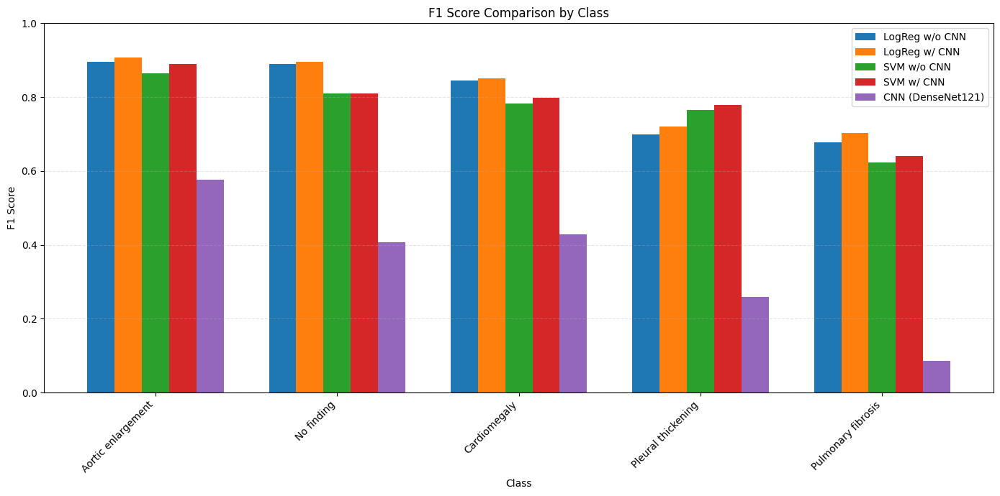


Best Model by Class Count:
  - LogReg w/ CNN: Best for 4 classes
  - SVM w/ CNN: Best for 1 classes


In [ ]:
# Comprehensive model comparison
print("\n===== Comprehensive Model Comparison =====")

# Create a list of all models with descriptive names
models = [
    (logreg_no_cnn_results, "LogReg w/o CNN"),
    (logreg_results, "LogReg w/ CNN"),
    (svm_no_cnn_results, "SVM w/o CNN"),
    (svm_results, "SVM w/ CNN"),
    (cnn_results, f"CNN ({CNN_CONFIG['model_type']})")
]

# Add architecture comparison models if available
if 'model_results' in locals():
    for model_type, result in model_results.items():
        models.append((result, f"CNN ({model_type})"))

# Check for None models and warn about them
missing_models = []
for model, name in models:
    if model is None:
        missing_models.append(name)

if missing_models:
    print(f"WARNING: The following models are missing or invalid and will be excluded:")
    for name in missing_models:
        print(f"  - {name}")

# Filter out None models
valid_models = [(model, name) for model, name in models if model is not None]
model_results_list = [model for model, _ in valid_models]
model_names_list = [name for _, name in valid_models]

# Run comparison with all valid models
compare_models(*model_results_list, model_names=model_names_list, selected_class_names=selected_class_names)

# Also compare per-class performance
compare_class_performance(*model_results_list, model_names=model_names_list, selected_class_names=selected_class_names)

## 3.5 Efficiency vs Accuracy Analysis
Analyze the trade-offs between computational efficiency and classification accuracy.

Analyzing efficiency vs accuracy trade-offs...

Efficiency and Performance Comparison:
               Model  Accuracy  F1 Score  Training Time (s)  \
0     LogReg w/o CNN  0.839752  0.801330           1.076200   
1      LogReg w/ CNN  0.853416  0.815632           3.645500   
2        SVM w/o CNN  0.798758  0.769219           5.870221   
3         SVM w/ CNN  0.813665  0.783137           6.025491   
4  CNN (DenseNet121)  0.510559  0.351423         315.605000   

   Inference Time (s)  
0            0.001302  
1            0.001660  
2            0.155565  
3            0.159286  
4            5.089661  

Efficiency Metrics:
               Model  Accuracy Per Training Second  F1 Per Training Second  \
0     LogReg w/o CNN                      0.780293                0.744592   
1      LogReg w/ CNN                      0.234101                0.223737   
2        SVM w/o CNN                      0.136069                0.131038   
3         SVM w/ CNN                      0.135037       

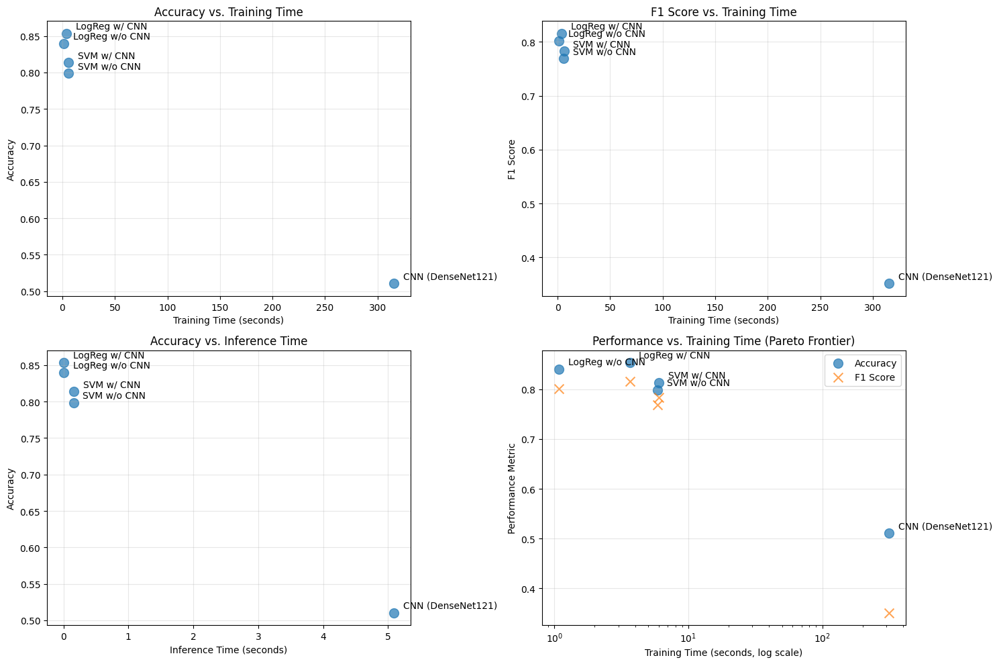

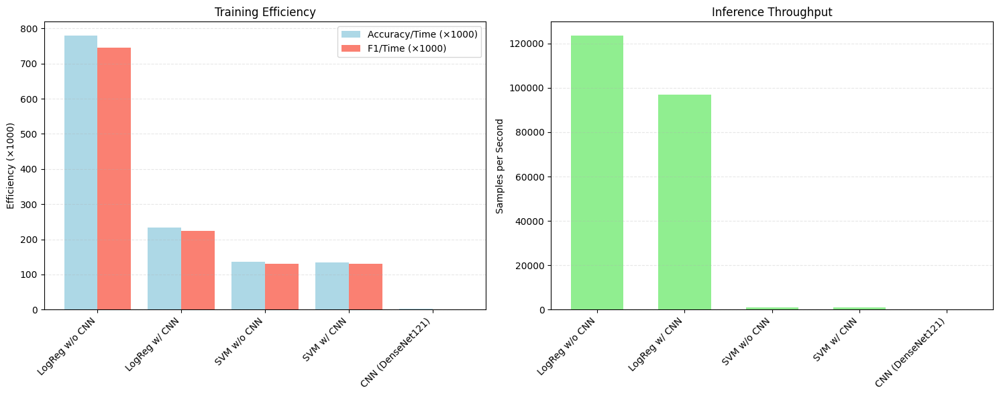


Detailed Trade-off Analysis:
Most accurate model: LogReg w/ CNN with accuracy 0.853
Most efficient training: LogReg w/o CNN with 780.293 accuracy per training second (×1000)
Fastest inference: LogReg w/o CNN with 123655.5 samples per second

Accuracy vs. Efficiency trade-off:
  - LogReg w/ CNN is 1.4% more accurate but 3.4x slower to train than LogReg w/o CNN

Key Model Comparisons:
  - LogReg with vs. without CNN: 1.4% accuracy difference, 3.4x training time ratio
  - SVM with vs. without CNN: 1.5% accuracy difference, 1.0x training time ratio
  - LogReg vs. SVM (both with CNN): -4.0% accuracy difference, 1.7x training time ratio
  - LogReg vs. CNN: -34.3% accuracy difference, 86.6x training time ratio

Summary of efficiency vs. accuracy findings:
1. For highest accuracy regardless of computational cost: Use LogReg w/ CNN
2. For most efficient training with good accuracy: Use LogReg w/o CNN
3. For fastest inference in deployment: Use LogReg w/o CNN


In [ ]:
# Analyze efficiency vs accuracy trade-offs
print("Analyzing efficiency vs accuracy trade-offs...")

# Create a list of all models with descriptive names
models = [
    (logreg_no_cnn_results, "LogReg w/o CNN"),
    (logreg_results, "LogReg w/ CNN"),
    (svm_no_cnn_results, "SVM w/o CNN"),
    (svm_results, "SVM w/ CNN"),
    (cnn_results, f"CNN ({CNN_CONFIG['model_type']})")
]

# Add architecture comparison models if available
if 'model_results' in locals():
    for model_type, result in model_results.items():
        models.append((result, f"CNN ({model_type})"))

# Check for None models and warn about them
missing_models = []
for model, name in models:
    if model is None:
        missing_models.append(name)

if missing_models:
    print(f"WARNING: The following models are missing or invalid and will be excluded:")
    for name in missing_models:
        print(f"  - {name}")

# Filter out None models
valid_models = [(model, name) for model, name in models if model is not None]

# Create efficiency comparison DataFrame dynamically
model_names = []
accuracy_values = []
f1_values = []
train_times = []
inference_times = []

for model, name in valid_models:
    model_names.append(name)
    accuracy_values.append(model['avg_accuracy'])
    f1_values.append(model['avg_f1'])
    train_times.append(model['train_time'])
    inference_times.append(model['inference_time'])

efficiency_df = pd.DataFrame({
    'Model': model_names,
    'Accuracy': accuracy_values,
    'F1 Score': f1_values,
    'Training Time (s)': train_times,
    'Inference Time (s)': inference_times
})

# Display efficiency table
print("\nEfficiency and Performance Comparison:")
print(efficiency_df)

# Calculate accuracy per second of training
efficiency_df['Accuracy Per Training Second'] = efficiency_df['Accuracy'] / efficiency_df['Training Time (s)']
efficiency_df['F1 Per Training Second'] = efficiency_df['F1 Score'] / efficiency_df['Training Time (s)']

# Calculate inference throughput (samples per second)
samples_per_second = y_test.shape[0] / efficiency_df['Inference Time (s)']
efficiency_df['Inference Throughput (samples/s)'] = samples_per_second

# Display efficiency metrics
print("\nEfficiency Metrics:")
print(efficiency_df[['Model', 'Accuracy Per Training Second', 'F1 Per Training Second', 'Inference Throughput (samples/s)']])

# Create visualizations
plt.figure(figsize=(15, 10))

# Accuracy vs Training Time
plt.subplot(2, 2, 1)
x = np.arange(len(efficiency_df['Model']))
width = 0.25

plt.scatter(
    efficiency_df['Training Time (s)'],
    efficiency_df['Accuracy'],
    s=100,
    alpha=0.7
)
for i, model in enumerate(efficiency_df['Model']):
    plt.annotate(
        model,
        (efficiency_df['Training Time (s)'].iloc[i], efficiency_df['Accuracy'].iloc[i]),
        xytext=(10, 5),
        textcoords='offset points'
    )
plt.xlabel('Training Time (seconds)')
plt.ylabel('Accuracy')
plt.title('Accuracy vs. Training Time')
plt.grid(True, alpha=0.3)

# F1 Score vs Training Time
plt.subplot(2, 2, 2)
plt.scatter(
    efficiency_df['Training Time (s)'],
    efficiency_df['F1 Score'],
    s=100,
    alpha=0.7
)
for i, model in enumerate(efficiency_df['Model']):
    plt.annotate(
        model,
        (efficiency_df['Training Time (s)'].iloc[i], efficiency_df['F1 Score'].iloc[i]),
        xytext=(10, 5),
        textcoords='offset points'
    )
plt.xlabel('Training Time (seconds)')
plt.ylabel('F1 Score')
plt.title('F1 Score vs. Training Time')
plt.grid(True, alpha=0.3)

# Accuracy vs Inference Time
plt.subplot(2, 2, 3)
plt.scatter(
    efficiency_df['Inference Time (s)'],
    efficiency_df['Accuracy'],
    s=100,
    alpha=0.7
)
for i, model in enumerate(efficiency_df['Model']):
    plt.annotate(
        model,
        (efficiency_df['Inference Time (s)'].iloc[i], efficiency_df['Accuracy'].iloc[i]),
        xytext=(10, 5),
        textcoords='offset points'
    )
plt.xlabel('Inference Time (seconds)')
plt.ylabel('Accuracy')
plt.title('Accuracy vs. Inference Time')
plt.grid(True, alpha=0.3)

# Pareto Frontier
plt.subplot(2, 2, 4)
plt.scatter(
    efficiency_df['Training Time (s)'],
    efficiency_df['Accuracy'],
    s=100,
    label='Accuracy',
    alpha=0.7
)
plt.scatter(
    efficiency_df['Training Time (s)'],
    efficiency_df['F1 Score'],
    s=100,
    label='F1 Score',
    marker='x',
    alpha=0.7
)
for i, model in enumerate(efficiency_df['Model']):
    plt.annotate(
        model,
        (efficiency_df['Training Time (s)'].iloc[i], efficiency_df['Accuracy'].iloc[i]),
        xytext=(10, 5),
        textcoords='offset points'
    )
plt.xlabel('Training Time (seconds, log scale)')
plt.ylabel('Performance Metric')
plt.title('Performance vs. Training Time (Pareto Frontier)')
plt.xscale('log')
plt.legend()
plt.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

# Additional efficiency visualization
plt.figure(figsize=(15, 6))

# Efficiency metrics
plt.subplot(1, 2, 1)
x = np.arange(len(efficiency_df['Model']))
width = 0.4

plt.bar(x - width/2, efficiency_df['Accuracy Per Training Second'] * 1000, width, label='Accuracy/Time (×1000)', color='lightblue')
plt.bar(x + width/2, efficiency_df['F1 Per Training Second'] * 1000, width, label='F1/Time (×1000)', color='salmon')

plt.ylabel('Efficiency (×1000)')
plt.title('Training Efficiency')
plt.xticks(x, efficiency_df['Model'], rotation=45 if len(efficiency_df) > 3 else 0, ha='right' if len(efficiency_df) > 3 else 'center')
plt.legend()
plt.grid(axis='y', linestyle='--', alpha=0.3)

# Inference throughput
plt.subplot(1, 2, 2)
plt.bar(x, efficiency_df['Inference Throughput (samples/s)'], width=0.6, color='lightgreen')
plt.ylabel('Samples per Second')
plt.title('Inference Throughput')
plt.xticks(x, efficiency_df['Model'], rotation=45 if len(efficiency_df) > 3 else 0, ha='right' if len(efficiency_df) > 3 else 'center')
plt.grid(axis='y', linestyle='--', alpha=0.3)

plt.tight_layout()
plt.show()

# Print detailed trade-off analysis
print("\nDetailed Trade-off Analysis:")

# Find most accurate model
most_accurate_idx = efficiency_df['Accuracy'].idxmax()
most_accurate_model = efficiency_df['Model'].iloc[most_accurate_idx]
most_accurate_value = efficiency_df['Accuracy'].iloc[most_accurate_idx]

# Find most efficient model for training
most_efficient_idx = efficiency_df['Accuracy Per Training Second'].idxmax()
most_efficient_model = efficiency_df['Model'].iloc[most_efficient_idx]
most_efficient_value = efficiency_df['Accuracy Per Training Second'].iloc[most_efficient_idx]

# Find fastest model for inference
fastest_idx = efficiency_df['Inference Throughput (samples/s)'].idxmax()
fastest_model = efficiency_df['Model'].iloc[fastest_idx]
fastest_value = efficiency_df['Inference Throughput (samples/s)'].iloc[fastest_idx]

print(f"Most accurate model: {most_accurate_model} with accuracy {most_accurate_value:.3f}")
print(f"Most efficient training: {most_efficient_model} with {most_efficient_value*1000:.3f} accuracy per training second (×1000)")
print(f"Fastest inference: {fastest_model} with {fastest_value:.1f} samples per second")

# Compare trade-offs between best models
if most_accurate_model != most_efficient_model:
    acc_diff = most_accurate_value - efficiency_df.loc[efficiency_df['Model'] == most_efficient_model, 'Accuracy'].iloc[0]
    time_diff = efficiency_df.loc[efficiency_df['Model'] == most_accurate_model, 'Training Time (s)'].iloc[0] / efficiency_df.loc[efficiency_df['Model'] == most_efficient_model, 'Training Time (s)'].iloc[0]

    print(f"\nAccuracy vs. Efficiency trade-off:")
    print(f"  - {most_accurate_model} is {acc_diff:.1%} more accurate but {time_diff:.1f}x slower to train than {most_efficient_model}")

# Analyze key model comparisons if they exist
# Only perform these comparisons if the relevant models exist
model_types = efficiency_df['Model'].tolist()
comparisons = []

# Define key comparisons to make if models are available
key_pairs = [
    ("LogReg w/o CNN", "LogReg w/ CNN", "LogReg with vs. without CNN:"),
    ("SVM w/o CNN", "SVM w/ CNN", "SVM with vs. without CNN:"),
    ("LogReg w/ CNN", "SVM w/ CNN", "LogReg vs. SVM (both with CNN):"),
    ("LogReg w/ CNN", f"CNN ({CNN_CONFIG['model_type']})", "LogReg vs. CNN:")
]

# Perform each comparison if both models exist
for model1, model2, label in key_pairs:
    if model1 in model_types and model2 in model_types:
        model1_idx = efficiency_df.index[efficiency_df['Model'] == model1].tolist()[0]
        model2_idx = efficiency_df.index[efficiency_df['Model'] == model2].tolist()[0]

        acc_diff = efficiency_df['Accuracy'].iloc[model2_idx] - efficiency_df['Accuracy'].iloc[model1_idx]
        time_ratio = efficiency_df['Training Time (s)'].iloc[model2_idx] / efficiency_df['Training Time (s)'].iloc[model1_idx]

        comparisons.append(f"  - {label} {acc_diff:.1%} accuracy difference, {time_ratio:.1f}x training time ratio")

# Print comparison results if we have any
if comparisons:
    print("\nKey Model Comparisons:")
    for comparison in comparisons:
        print(comparison)

# Summary of findings
print("\nSummary of efficiency vs. accuracy findings:")
print("1. For highest accuracy regardless of computational cost: Use", most_accurate_model)
print("2. For most efficient training with good accuracy: Use", most_efficient_model)
print("3. For fastest inference in deployment: Use", fastest_model)

# 4. Additional comparisons


## 4.1 Compare 'DenseNet121', 'ResNet50', 'EfficientNetB0'

In [ ]:
# # Run CNN experiments with different model types
# print("\n===== Running CNN experiments with different model architectures =====")


# def train_model_with_tuning(model_type, X_train, y_train, X_val, y_val, selected_classes):
#     """Train a specific CNN architecture with focused hyperparameter tuning and mutual exclusivity learning."""
#     print(f"\n{'='*80}")
#     print(f"Starting training for {model_type}")
#     print(f"Time: {time.strftime('%H:%M:%S', time.localtime())}")
#     print(f"{'='*80}")

#     # Check if "No finding" class is included
#     has_no_finding = 14 in selected_classes
#     no_finding_index = selected_classes.index(14) if has_no_finding else -1

#     # Define mutual exclusivity loss function
#     def mutual_exclusivity_loss(y_true, y_pred):
#         # Standard binary crossentropy
#         bce = tf.keras.losses.binary_crossentropy(y_true, y_pred)

#         # If "No finding" class is not included, just return standard BCE
#         if not has_no_finding:
#             return bce

#         # Extract "No finding" predictions
#         no_finding_pred = y_pred[:, no_finding_index]

#         # Other class predictions
#         if no_finding_index == 0:
#             other_preds = y_pred[:, 1:]
#         elif no_finding_index == y_pred.shape[1] - 1:
#             other_preds = y_pred[:, :-1]
#         else:
#             other_preds = tf.concat([y_pred[:, :no_finding_index], y_pred[:, no_finding_index+1:]], axis=1)

#         # Calculate sum of other predictions for each sample
#         other_preds_sum = tf.reduce_sum(other_preds, axis=1)

#         # Exclusivity penalty: high when both no_finding and sum of others are high
#         exclusivity_penalty = no_finding_pred * other_preds_sum

#         # Add penalty to original loss - weight can be tuned
#         return bce + 0.1 * exclusivity_penalty

#     # Mutual Exclusivity Regularizer
#     class MutualExclusivityRegularizer(tf.keras.regularizers.Regularizer):
#         def __init__(self, no_finding_index, strength=0.01):
#             self.no_finding_index = no_finding_index
#             self.strength = strength

#         def __call__(self, x):
#             # If "No finding" class is not included, return 0
#             if not has_no_finding:
#                 return 0.0

#             # Apply on weight matrix of final layer
#             no_finding_weights = x[:, self.no_finding_index]

#             # Get other weights
#             if self.no_finding_index == 0:
#                 other_weights = x[:, 1:]
#             elif self.no_finding_index == x.shape[1] - 1:
#                 other_weights = x[:, :-1]
#             else:
#                 other_weights = tf.concat(
#                     [x[:, :self.no_finding_index], x[:, self.no_finding_index+1:]],
#                     axis=1
#                 )

#             # Calculate penalty
#             other_weights_sum = tf.reduce_sum(tf.abs(other_weights), axis=1)
#             penalty = tf.reduce_sum(tf.abs(no_finding_weights) * other_weights_sum)

#             return self.strength * penalty

#         def get_config(self):
#             return {'no_finding_index': self.no_finding_index, 'strength': self.strength}

#     # Function to build a simple CNN from scratch
#     def build_simple_cnn(hp):
#         """Build a simple CNN from scratch without transfer learning."""
#         # Hyperparameters to tune
#         lr = hp.Float('learning_rate', min_value=1e-5, max_value=1e-2, sampling='log')
#         dropout_rate = hp.Float('dropout_rate', min_value=0.2, max_value=0.5)
#         filters_base = hp.Int('filters_base', min_value=16, max_value=64, step=16)

#         # Mutual exclusivity approach
#         if has_no_finding:
#             try:
#                 exclusivity_approach = hp.Choice(
#                     'exclusivity_approach',
#                     values=['loss_function', 'regularizer']
#                 )
#             except:
#                 exclusivity_approach = 'none'
#         else:
#             exclusivity_approach = 'none'

#         # Create a simple CNN architecture
#         model = models.Sequential([
#             # First convolutional block
#             layers.Conv2D(filters_base, (3, 3), activation='relu', padding='same',
#                          input_shape=(*CNN_CONFIG['img_size'], 3)),
#             layers.BatchNormalization(),
#             layers.MaxPooling2D((2, 2)),

#             # Second convolutional block
#             layers.Conv2D(filters_base*2, (3, 3), activation='relu', padding='same'),
#             layers.BatchNormalization(),
#             layers.MaxPooling2D((2, 2)),

#             # Third convolutional block
#             layers.Conv2D(filters_base*4, (3, 3), activation='relu', padding='same'),
#             layers.BatchNormalization(),
#             layers.MaxPooling2D((2, 2)),

#             # Fourth convolutional block
#             layers.Conv2D(filters_base*8, (3, 3), activation='relu', padding='same'),
#             layers.BatchNormalization(),
#             layers.MaxPooling2D((2, 2)),

#             # Flatten and dense layers
#             layers.GlobalAveragePooling2D(),
#             layers.Dropout(dropout_rate),
#             layers.Dense(filters_base*8, activation='relu'),
#             layers.BatchNormalization(),
#             layers.Dropout(dropout_rate)
#         ])

#         # Apply the same mutual exclusivity approach as the other models
#         if exclusivity_approach == 'regularizer' and has_no_finding:
#             model.add(layers.Dense(
#                 len(selected_classes),
#                 activation='sigmoid',
#                 kernel_regularizer=MutualExclusivityRegularizer(no_finding_index, strength=0.01)
#             ))
#         else:
#             model.add(layers.Dense(len(selected_classes), activation='sigmoid'))

#         # Compile with appropriate loss function
#         if exclusivity_approach == 'loss_function' and has_no_finding:
#             loss = mutual_exclusivity_loss
#         else:
#             loss = 'binary_crossentropy'

#         model.compile(
#             optimizer=optimizers.Adam(learning_rate=lr),
#             loss=loss,
#             metrics=['accuracy', tf.keras.metrics.AUC()]
#         )

#         return model

#     # Define model builder for transfer learning architectures
#     def build_transfer_learning_model(hp):
#         # Hyperparameters to tune
#         # Learning rate with logarithmic sampling
#         lr = hp.Float('learning_rate', min_value=1e-5, max_value=1e-2, sampling='log')

#         # Dropout rate with continuous sampling
#         dropout_rate = hp.Float('dropout_rate', min_value=0.2, max_value=0.5)

#         # Fine-tune layers with logarithmic sampling
#         fine_tune_layers = hp.Int('fine_tune_layers', min_value=1, max_value=50, sampling='log')

#         # Dense units with logarithmic sampling
#         dense_units = hp.Int('dense_units', min_value=128, max_value=512, sampling='log')

#         # Mutual exclusivity approach to use
#         if has_no_finding:
#             try:
#                 exclusivity_approach = hp.Choice(
#                     'exclusivity_approach',
#                     values=['loss_function', 'regularizer']
#                 )
#             except:
#                 exclusivity_approach = 'none'
#         else:
#             exclusivity_approach = 'none'

#         # Create model with these hyperparameters
#         input_shape = (*CNN_CONFIG['img_size'], 3)

#         # Select the specific architecture
#         if model_type == 'ResNet50':
#             base_model = applications.ResNet50(weights='imagenet', include_top=False, input_shape=input_shape)
#         elif model_type == 'DenseNet121':
#             base_model = applications.DenseNet121(weights='imagenet', include_top=False, input_shape=input_shape)
#         elif model_type == 'EfficientNetB0':
#             base_model = applications.EfficientNetB0(weights='imagenet', include_top=False, input_shape=input_shape)
#         else:
#             raise ValueError(f"Unsupported model type: {model_type}")

#         base_model.trainable = False

#         # Build standard sequential model
#         model = models.Sequential()
#         model.add(base_model)
#         model.add(layers.GlobalAveragePooling2D())
#         model.add(layers.Dropout(dropout_rate))
#         model.add(layers.Dense(dense_units, activation='relu'))
#         model.add(layers.BatchNormalization())
#         model.add(layers.Dropout(dropout_rate))

#         # Final layer with or without regularizer
#         if exclusivity_approach == 'regularizer' and has_no_finding:
#             model.add(layers.Dense(
#                 len(selected_classes),
#                 activation='sigmoid',
#                 kernel_regularizer=MutualExclusivityRegularizer(no_finding_index, strength=0.01)
#             ))
#         else:
#             model.add(layers.Dense(len(selected_classes), activation='sigmoid'))

#         # Fine-tune layers if requested
#         if fine_tune_layers > 0:
#             base_model.trainable = True
#             for layer in base_model.layers[:-fine_tune_layers]:
#                 layer.trainable = False

#         # Compile with appropriate loss function
#         if exclusivity_approach == 'loss_function' and has_no_finding:
#             loss = mutual_exclusivity_loss
#         else:
#             loss = 'binary_crossentropy'

#         model.compile(
#             optimizer=optimizers.Adam(learning_rate=lr),
#             loss=loss,
#             metrics=['accuracy', tf.keras.metrics.AUC()]
#         )

#         return model

#     # Choose appropriate model builder based on model type
#     if model_type == 'SimpleCNN':
#         build_model_fn = build_simple_cnn
#     else:
#         build_model_fn = build_transfer_learning_model

#     # Create tuner - use Bayesian optimization
#     class MyTuner(kt.BayesianOptimization):
#         """Custom tuner that prints model type before each trial."""
#         def __init__(self, model_name, *args, **kwargs):
#             super().__init__(*args, **kwargs)
#             self.model_name = model_name

#         def on_trial_begin(self, trial):
#             print(f"\n{'~'*80}")
#             print(f"~ MODEL: {self.model_name} | TRIAL: {trial.trial_id} | TIME: {time.strftime('%H:%M:%S')}")
#             print(f"{'~'*80}")
#             super().on_trial_begin(trial)

#         def on_trial_end(self, trial):
#             super().on_trial_end(trial)
#             print(f"{'~'*80}")
#             print(f"~ END TRIAL: {trial.trial_id} | MODEL: {self.model_name} | TIME: {time.strftime('%H:%M:%S')}")
#             print(f"{'~'*80}")

#     tuner = MyTuner(
#         model_name=model_type,
#         hypermodel=build_model_fn,
#         objective='val_auc',
#         max_trials=20,  # Reasonable number of trials
#         directory=f'keras_tuner_dir_{model_type}',
#         project_name=f'cnn_{model_type}_tuning',
#         overwrite=True
#     )

#     # Define callbacks for tuning
#     stop_early = EarlyStopping(monitor='val_loss', patience=3)

#     # Use a subset of data for tuning to save time
#     subset_size = min(500, len(X_train))
#     val_subset_size = min(100, len(X_val))

#     print(f"\n{'#'*80}")
#     print(f"# MODEL ARCHITECTURE: {model_type}")
#     print(f"# STARTING HYPERPARAMETER SEARCH: {time.strftime('%H:%M:%S', time.localtime())}")
#     print(f"{'#'*80}")
#     print(f"Search space summary:")
#     tuner.search_space_summary()

#     # Run hyperparameter search
#     tuner.search(
#         X_train[:subset_size], y_train[:subset_size],
#         epochs=5,
#         validation_data=(X_val[:val_subset_size], y_val[:val_subset_size]),
#         callbacks=[stop_early],
#         verbose=1
#     )

#     # Get the best hyperparameters
#     best_hp = tuner.get_best_hyperparameters(1)[0]
#     print(f"\n{'*'*80}")
#     print(f"* BEST HYPERPARAMETERS FOR {model_type}")
#     print(f"* Time: {time.strftime('%H:%M:%S', time.localtime())}")
#     print(f"{'*'*80}")
#     print(f"- Learning rate: {best_hp.get('learning_rate')}")
#     print(f"- Dropout rate: {best_hp.get('dropout_rate')}")

#     # Print model-specific hyperparameters
#     if model_type == 'SimpleCNN':
#         print(f"- Filters base: {best_hp.get('filters_base')}")
#     else:
#         print(f"- Fine-tune layers: {best_hp.get('fine_tune_layers')}")
#         print(f"- Dense units: {best_hp.get('dense_units')}")

#     # Print exclusivity approach if available
#     if has_no_finding:
#         try:
#             exclusivity_approach = best_hp.get('exclusivity_approach')
#             print(f"- Exclusivity approach: {exclusivity_approach}")
#         except:
#             print(f"- Exclusivity approach: none")

#     # Build final model with best hyperparameters
#     print(f"\n{'>'*80}")
#     print(f"> STARTING FINAL TRAINING FOR {model_type}")
#     print(f"> Time: {time.strftime('%H:%M:%S', time.localtime())}")
#     print(f"{'>'*80}")

#     # Get the best model
#     best_model = tuner.get_best_models(1)[0]

#     # Create callbacks for final training
#     callbacks = [
#         EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True),
#         ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=3, min_lr=1e-6)
#     ]

#     # Standard data augmentation
#     datagen = ImageDataGenerator(
#         rotation_range=10,
#         width_shift_range=0.1,
#         height_shift_range=0.1,
#         zoom_range=0.1,
#         horizontal_flip=True
#     )

#     # Train the final model
#     train_start_time = time.time()

#     # Train with data augmentation
#     history = best_model.fit(
#         datagen.flow(X_train, y_train, batch_size=CNN_CONFIG['batch_size']),
#         epochs=CNN_CONFIG['epochs'],
#         validation_data=(X_val, y_val),
#         callbacks=callbacks
#     )

#     train_time = time.time() - train_start_time
#     print(f"\n{'<'*80}")
#     print(f"< TRAINING COMPLETED FOR {model_type}")
#     print(f"< Time: {time.strftime('%H:%M:%S', time.localtime())}")
#     print(f"< Duration: {train_time:.2f} seconds")
#     print(f"{'<'*80}")

#     # Evaluate on validation set
#     print(f"\n{'-'*80}")
#     print(f"EVALUATING MODEL: {model_type}")
#     print(f"Time: {time.strftime('%H:%M:%S', time.localtime())}")
#     print(f"{'-'*80}")

#     # Get predictions for validation set
#     val_preds = best_model.predict(X_val)

#     # Apply mutual exclusivity constraint if needed
#     if has_no_finding:
#         # Post-process predictions to enhance mutual exclusivity
#         for i in range(len(val_preds)):
#             if val_preds[i, no_finding_index] > 0.5:
#                 # If "No finding" is predicted, suppress other predictions
#                 val_preds[i, :] = np.zeros(len(selected_classes))
#                 val_preds[i, no_finding_index] = 1.0
#             elif np.max(np.delete(val_preds[i], no_finding_index)) > 0.5:
#                 # If any other condition is detected, suppress "No finding"
#                 val_preds[i, no_finding_index] = 0.0

#     # Calculate metrics
#     class_performance = {}
#     for i, class_id in enumerate(selected_classes):
#         # Threshold predictions at 0.5
#         y_val_pred = (val_preds[:, i] >= 0.5).astype(int)
#         y_val_true = y_val[:, i]

#         # Calculate metrics
#         accuracy = np.mean(y_val_true == y_val_pred)

#         # Skip AUC if only one class is present
#         if np.sum(y_val_true) > 0 and np.sum(y_val_true) < len(y_val_true):
#             auc = roc_auc_score(y_val_true, val_preds[:, i])
#             # Calculate ROC curve points for visualization
#             fpr, tpr, _ = roc_curve(y_val_true, val_preds[:, i])
#             roc_data = (fpr, tpr)
#         else:
#             auc = float('nan')
#             roc_data = None

#         # F1 score
#         f1 = f1_score(y_val_true, y_val_pred, zero_division=0)

#         # Store performance
#         class_performance[i] = {
#             'class_id': class_id,  # Store the actual class ID
#             'accuracy': accuracy,
#             'auc': auc,
#             'f1': f1,
#             'confusion_matrix': confusion_matrix(y_val_true, y_val_pred)
#         }

#         # Add ROC curve data if available
#         if roc_data:
#             class_performance[i]['roc_curve'] = roc_data

#         print(f"Class {class_id} ({CLASS_NAMES[class_id]}): Accuracy={accuracy:.3f}, AUC={auc:.3f}, F1={f1:.3f}")

#     # Calculate average metrics
#     valid_indices = list(class_performance.keys())
#     avg_accuracy = np.mean([class_performance[i]['accuracy'] for i in valid_indices])
#     avg_auc = np.nanmean([class_performance[i]['auc'] for i in valid_indices])
#     avg_f1 = np.mean([class_performance[i]['f1'] for i in valid_indices])

#     # Measure inference time on validation set
#     inference_start_time = time.time()
#     _ = best_model.predict(X_val[:min(100, len(X_val))])
#     inference_time = time.time() - inference_start_time

#     print(f"\n{'+'*80}")
#     print(f"+ FINAL RESULTS FOR {model_type}")
#     print(f"+ Time: {time.strftime('%H:%M:%S', time.localtime())}")
#     print(f"+ Average Accuracy: {avg_accuracy:.3f}")
#     print(f"+ Average AUC: {avg_auc:.3f}")
#     print(f"+ Average F1: {avg_f1:.3f}")
#     print(f"+ Training Time: {train_time:.2f} seconds")
#     print(f"+ Inference Time: {inference_time:.2f} seconds")
#     print(f"{'+'*80}")

#     # Prepare extra hyperparameter info
#     extra_hp_info = {}
#     if has_no_finding:
#         try:
#             extra_hp_info['exclusivity_approach'] = best_hp.get('exclusivity_approach')
#         except:
#             extra_hp_info['exclusivity_approach'] = 'none'

#     # Create hyperparameter dictionary based on model type
#     if model_type == 'SimpleCNN':
#         hyperparameters = {
#             'learning_rate': best_hp.get('learning_rate'),
#             'dropout_rate': best_hp.get('dropout_rate'),
#             'filters_base': best_hp.get('filters_base'),
#             **extra_hp_info
#         }
#     else:
#         hyperparameters = {
#             'learning_rate': best_hp.get('learning_rate'),
#             'dropout_rate': best_hp.get('dropout_rate'),
#             'fine_tune_layers': best_hp.get('fine_tune_layers'),
#             'dense_units': best_hp.get('dense_units'),
#             **extra_hp_info
#         }

#     return {
#         'model_type': model_type,
#         'model': best_model,
#         'history': history,
#         'class_performance': class_performance,
#         'avg_accuracy': avg_accuracy,
#         'avg_auc': avg_auc,
#         'avg_f1': avg_f1,
#         'train_time': train_time,
#         'inference_time': inference_time,
#         'best_hyperparameters': hyperparameters
#     }

# # Models to try
# model_types = ['DenseNet121', 'ResNet50', 'EfficientNetB0', 'SimpleCNN']
# model_results = {}

# # Add start time logging for the entire process
# print(f"\n{'@'*100}")
# print(f"@ STARTING CNN MODEL COMPARISON EXPERIMENT")
# print(f"@ Start Time: {time.strftime('%H:%M:%S', time.localtime())}")
# print(f"@ Testing {len(model_types)} architectures: {', '.join(model_types)}")
# print(f"{'@'*100}")

# # Train each model type with its own hyperparameter tuning
# for model_type in model_types:
#     model_results[model_type] = train_model_with_tuning(
#         model_type, X_img_train, y_train, X_img_val, y_val, selected_classes
#     )

# # Compare model performances
# print("\n{'@'*100}")
# print(f"@ EXPERIMENT COMPLETED")
# print(f"@ End Time: {time.strftime('%H:%M:%S', time.localtime())}")
# print(f"{'@'*100}")

# print("\n===== Model Architecture Comparison =====")
# comparison_df = pd.DataFrame({
#     'Model Type': model_types,
#     'Accuracy': [model_results[m]['avg_accuracy'] for m in model_types],
#     'AUC': [model_results[m]['avg_auc'] for m in model_types],
#     'F1 Score': [model_results[m]['avg_f1'] for m in model_types],
#     'Training Time (s)': [model_results[m]['train_time'] for m in model_types],
#     'Inference Time (s)': [model_results[m]['inference_time'] for m in model_types]
# })

# print(comparison_df)

# # Visualize model comparison
# plt.figure(figsize=(15, 10))

# # Performance metrics
# plt.subplot(2, 1, 1)
# x = np.arange(len(model_types))
# width = 0.25

# plt.bar(x - width, [model_results[m]['avg_accuracy'] for m in model_types], width, label='Accuracy', color='skyblue')
# plt.bar(x, [model_results[m]['avg_auc'] for m in model_types], width, label='AUC', color='lightgreen')
# plt.bar(x + width, [model_results[m]['avg_f1'] for m in model_types], width, label='F1 Score', color='salmon')

# plt.ylabel('Score')
# plt.title('Model Architecture Performance Comparison')
# plt.xticks(x, model_types)
# plt.ylim(0, 1.0)
# plt.legend()
# plt.grid(axis='y', linestyle='--', alpha=0.3)

# # Efficiency metrics
# plt.subplot(2, 1, 2)
# plt.bar(x - width/2, [model_results[m]['train_time'] for m in model_types], width, label='Training Time', color='lightblue')
# plt.bar(x + width/2, [model_results[m]['inference_time'] for m in model_types], width, label='Inference Time', color='lightcoral')

# plt.ylabel('Time (seconds)')
# plt.title('Model Architecture Efficiency Comparison')
# plt.xticks(x, model_types)
# plt.legend()
# plt.grid(axis='y', linestyle='--', alpha=0.3)

# plt.tight_layout()
# plt.show()

# # Identify the best model based on AUC
# best_model_idx = np.argmax([model_results[m]['avg_auc'] for m in model_types])
# best_model_type = model_types[best_model_idx]
# print(f"\nBest performing model architecture: {best_model_type}")
# print(f"AUC: {model_results[best_model_type]['avg_auc']:.3f}")
# print(f"Accuracy: {model_results[best_model_type]['avg_accuracy']:.3f}")
# print(f"F1 Score: {model_results[best_model_type]['avg_f1']:.3f}")
# print(f"Best hyperparameters: {model_results[best_model_type]['best_hyperparameters']}")

# # Store the best model results as best_cnn_results for further analysis
# best_cnn_results = model_results[best_model_type]


===== Running CNN experiments with different model architectures =====

@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@
@ STARTING CNN MODEL COMPARISON EXPERIMENT
@ Start Time: 20:30:22
@ Testing 4 architectures: DenseNet121, ResNet50, EfficientNetB0, SimpleCNN
@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@

Starting training for DenseNet121
Time: 20:30:22


AttributeError: 'list' object has no attribute 'Sequential'